# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

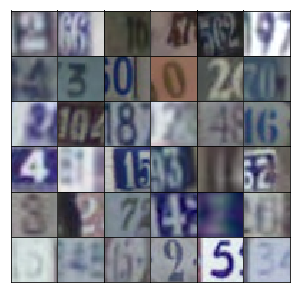

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4 * 4 * 512, use_bias=False, activation=None)
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        x = tf.reshape(x, shape=[-1, 4, 4, 512])
        
        x = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        
        x = tf.layers.conv2d_transpose(x, 128, 5, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(x * alpha, x)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding="same")
        x = tf.maximum(x * alpha, x)
        
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding="same")
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(x * alpha, x)
        
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(x * alpha, x)
        
        flat = tf.reshape(x, [-1, 4 * 4 * 256])
        
        logits = tf.layers.dense(flat, 1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 0.8987... Generator Loss: 1.0382
Epoch 1/25... Discriminator Loss: 0.3982... Generator Loss: 1.7535
Epoch 1/25... Discriminator Loss: 0.2122... Generator Loss: 2.1870
Epoch 1/25... Discriminator Loss: 0.1546... Generator Loss: 2.6018
Epoch 1/25... Discriminator Loss: 0.1545... Generator Loss: 2.7417
Epoch 1/25... Discriminator Loss: 0.1378... Generator Loss: 2.8819
Epoch 1/25... Discriminator Loss: 0.1057... Generator Loss: 3.2183
Epoch 1/25... Discriminator Loss: 0.0824... Generator Loss: 3.6426
Epoch 1/25... Discriminator Loss: 0.1860... Generator Loss: 2.1843
Epoch 1/25... Discriminator Loss: 0.2594... Generator Loss: 2.0896


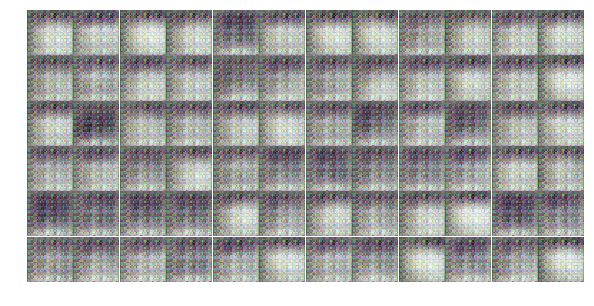

Epoch 1/25... Discriminator Loss: 0.6686... Generator Loss: 1.4343
Epoch 1/25... Discriminator Loss: 0.6583... Generator Loss: 1.9599
Epoch 1/25... Discriminator Loss: 0.5515... Generator Loss: 1.3927
Epoch 1/25... Discriminator Loss: 0.3115... Generator Loss: 3.0873
Epoch 1/25... Discriminator Loss: 0.4319... Generator Loss: 1.6716
Epoch 1/25... Discriminator Loss: 0.5177... Generator Loss: 2.3346
Epoch 1/25... Discriminator Loss: 0.4850... Generator Loss: 1.3234
Epoch 1/25... Discriminator Loss: 0.2174... Generator Loss: 2.7422
Epoch 1/25... Discriminator Loss: 0.8872... Generator Loss: 1.7845
Epoch 1/25... Discriminator Loss: 1.2921... Generator Loss: 3.7661


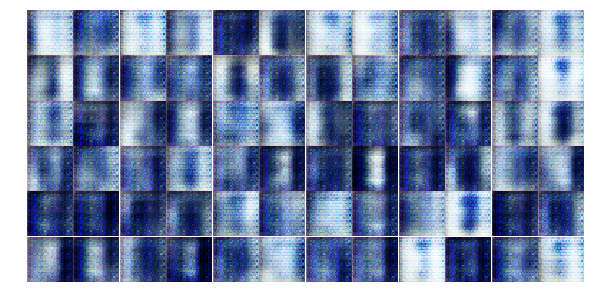

Epoch 1/25... Discriminator Loss: 0.6228... Generator Loss: 1.4188
Epoch 1/25... Discriminator Loss: 0.2157... Generator Loss: 4.3624
Epoch 1/25... Discriminator Loss: 0.3253... Generator Loss: 4.5573
Epoch 1/25... Discriminator Loss: 0.5787... Generator Loss: 1.3414
Epoch 1/25... Discriminator Loss: 0.4360... Generator Loss: 1.6096
Epoch 1/25... Discriminator Loss: 0.8300... Generator Loss: 1.7836
Epoch 1/25... Discriminator Loss: 0.8871... Generator Loss: 2.1058
Epoch 1/25... Discriminator Loss: 0.3271... Generator Loss: 2.3181
Epoch 1/25... Discriminator Loss: 0.5346... Generator Loss: 1.7009
Epoch 1/25... Discriminator Loss: 0.9804... Generator Loss: 1.1663


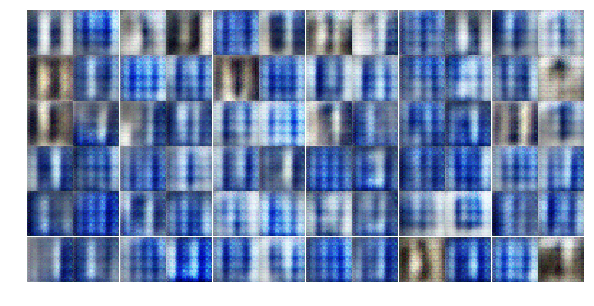

Epoch 1/25... Discriminator Loss: 0.7801... Generator Loss: 1.3031
Epoch 1/25... Discriminator Loss: 0.6831... Generator Loss: 1.3220
Epoch 1/25... Discriminator Loss: 0.5270... Generator Loss: 1.9169
Epoch 1/25... Discriminator Loss: 1.0848... Generator Loss: 0.6700
Epoch 1/25... Discriminator Loss: 0.5121... Generator Loss: 1.5482
Epoch 1/25... Discriminator Loss: 0.6635... Generator Loss: 1.3902
Epoch 1/25... Discriminator Loss: 0.5376... Generator Loss: 1.8440
Epoch 1/25... Discriminator Loss: 0.5564... Generator Loss: 2.7594
Epoch 1/25... Discriminator Loss: 0.5419... Generator Loss: 2.4824
Epoch 1/25... Discriminator Loss: 0.2303... Generator Loss: 3.1243


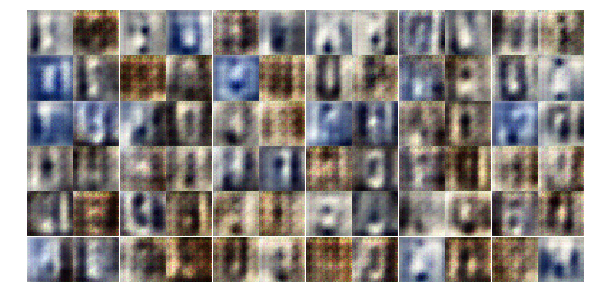

Epoch 1/25... Discriminator Loss: 1.0656... Generator Loss: 0.6752
Epoch 1/25... Discriminator Loss: 0.1941... Generator Loss: 3.1627
Epoch 1/25... Discriminator Loss: 0.2153... Generator Loss: 3.5478
Epoch 1/25... Discriminator Loss: 0.1476... Generator Loss: 3.3325
Epoch 1/25... Discriminator Loss: 2.0937... Generator Loss: 0.2658
Epoch 1/25... Discriminator Loss: 0.4543... Generator Loss: 2.2739
Epoch 1/25... Discriminator Loss: 0.6547... Generator Loss: 1.4766
Epoch 1/25... Discriminator Loss: 1.5507... Generator Loss: 0.3914
Epoch 1/25... Discriminator Loss: 1.0352... Generator Loss: 0.6959
Epoch 1/25... Discriminator Loss: 0.7753... Generator Loss: 3.4571


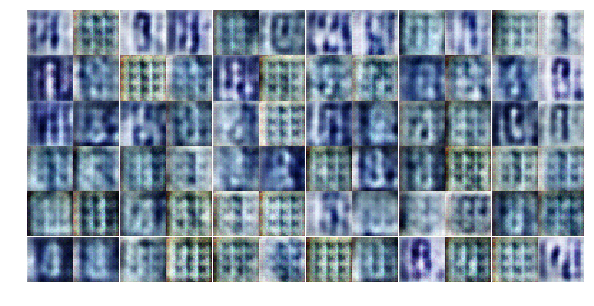

Epoch 1/25... Discriminator Loss: 0.4685... Generator Loss: 1.8334
Epoch 1/25... Discriminator Loss: 1.6725... Generator Loss: 0.3596
Epoch 1/25... Discriminator Loss: 0.4301... Generator Loss: 1.5364
Epoch 1/25... Discriminator Loss: 0.2348... Generator Loss: 3.6508
Epoch 1/25... Discriminator Loss: 0.5425... Generator Loss: 1.2466
Epoch 1/25... Discriminator Loss: 0.5830... Generator Loss: 1.3196
Epoch 1/25... Discriminator Loss: 0.7207... Generator Loss: 1.1862
Epoch 2/25... Discriminator Loss: 1.1484... Generator Loss: 1.3325
Epoch 2/25... Discriminator Loss: 0.6249... Generator Loss: 1.6236
Epoch 2/25... Discriminator Loss: 1.1787... Generator Loss: 0.7152


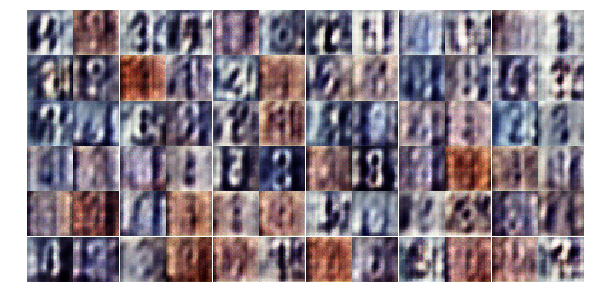

Epoch 2/25... Discriminator Loss: 0.3924... Generator Loss: 1.9708
Epoch 2/25... Discriminator Loss: 0.5963... Generator Loss: 1.2398
Epoch 2/25... Discriminator Loss: 0.6900... Generator Loss: 2.0398
Epoch 2/25... Discriminator Loss: 0.3711... Generator Loss: 2.0555
Epoch 2/25... Discriminator Loss: 1.0583... Generator Loss: 0.6666
Epoch 2/25... Discriminator Loss: 0.5033... Generator Loss: 1.6152
Epoch 2/25... Discriminator Loss: 0.6930... Generator Loss: 1.5236
Epoch 2/25... Discriminator Loss: 0.6183... Generator Loss: 1.8821
Epoch 2/25... Discriminator Loss: 0.9648... Generator Loss: 0.6980
Epoch 2/25... Discriminator Loss: 1.6798... Generator Loss: 1.2992


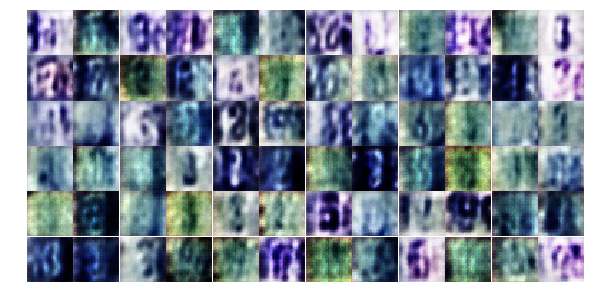

Epoch 2/25... Discriminator Loss: 0.9110... Generator Loss: 1.4862
Epoch 2/25... Discriminator Loss: 0.7815... Generator Loss: 2.2812
Epoch 2/25... Discriminator Loss: 0.8448... Generator Loss: 1.4592
Epoch 2/25... Discriminator Loss: 0.4387... Generator Loss: 2.1781
Epoch 2/25... Discriminator Loss: 0.5364... Generator Loss: 1.8143
Epoch 2/25... Discriminator Loss: 0.9297... Generator Loss: 2.2642
Epoch 2/25... Discriminator Loss: 0.6781... Generator Loss: 3.0320
Epoch 2/25... Discriminator Loss: 1.0315... Generator Loss: 0.8854
Epoch 2/25... Discriminator Loss: 1.0678... Generator Loss: 0.6907
Epoch 2/25... Discriminator Loss: 0.8352... Generator Loss: 0.7600


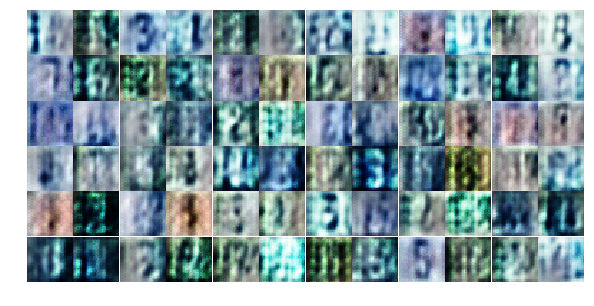

Epoch 2/25... Discriminator Loss: 0.5872... Generator Loss: 2.6315
Epoch 2/25... Discriminator Loss: 0.4562... Generator Loss: 2.1451
Epoch 2/25... Discriminator Loss: 0.6009... Generator Loss: 1.3033
Epoch 2/25... Discriminator Loss: 1.0425... Generator Loss: 1.3074
Epoch 2/25... Discriminator Loss: 0.5340... Generator Loss: 1.6996
Epoch 2/25... Discriminator Loss: 1.2176... Generator Loss: 2.9698
Epoch 2/25... Discriminator Loss: 0.8067... Generator Loss: 0.9622
Epoch 2/25... Discriminator Loss: 0.9452... Generator Loss: 0.7897
Epoch 2/25... Discriminator Loss: 1.1493... Generator Loss: 1.6675
Epoch 2/25... Discriminator Loss: 0.8609... Generator Loss: 1.9553


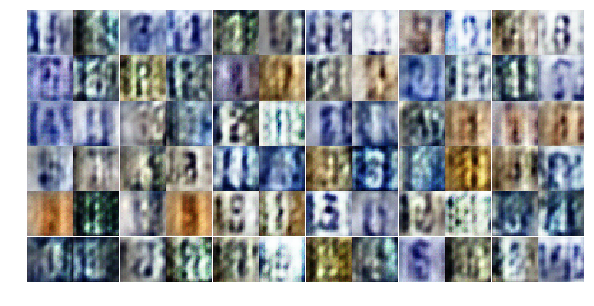

Epoch 2/25... Discriminator Loss: 0.5132... Generator Loss: 1.4282
Epoch 2/25... Discriminator Loss: 0.5917... Generator Loss: 1.6807
Epoch 2/25... Discriminator Loss: 0.9178... Generator Loss: 1.6591
Epoch 2/25... Discriminator Loss: 0.4191... Generator Loss: 2.7924
Epoch 2/25... Discriminator Loss: 0.9961... Generator Loss: 2.3906
Epoch 2/25... Discriminator Loss: 0.9504... Generator Loss: 2.7411
Epoch 2/25... Discriminator Loss: 1.2864... Generator Loss: 0.4732
Epoch 2/25... Discriminator Loss: 0.4714... Generator Loss: 2.8849
Epoch 2/25... Discriminator Loss: 0.5421... Generator Loss: 2.5633
Epoch 2/25... Discriminator Loss: 0.4291... Generator Loss: 1.4924


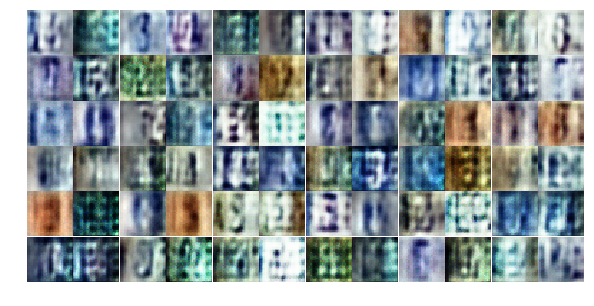

Epoch 2/25... Discriminator Loss: 0.9455... Generator Loss: 0.7045
Epoch 2/25... Discriminator Loss: 1.4379... Generator Loss: 0.5114
Epoch 2/25... Discriminator Loss: 0.1803... Generator Loss: 2.8639
Epoch 2/25... Discriminator Loss: 0.7716... Generator Loss: 1.7350
Epoch 2/25... Discriminator Loss: 0.3562... Generator Loss: 2.2756
Epoch 2/25... Discriminator Loss: 0.4766... Generator Loss: 1.7770
Epoch 2/25... Discriminator Loss: 0.4736... Generator Loss: 1.8199
Epoch 2/25... Discriminator Loss: 1.5592... Generator Loss: 0.3339
Epoch 2/25... Discriminator Loss: 0.6124... Generator Loss: 2.8702
Epoch 2/25... Discriminator Loss: 1.8358... Generator Loss: 0.2514


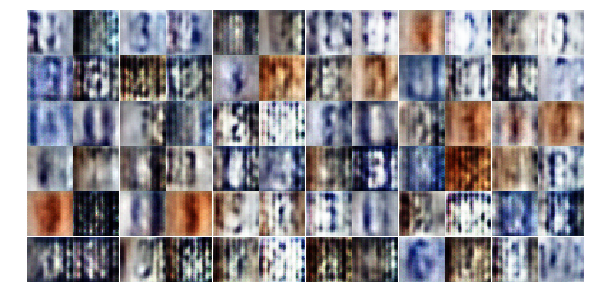

Epoch 2/25... Discriminator Loss: 0.5516... Generator Loss: 2.7160
Epoch 2/25... Discriminator Loss: 0.6374... Generator Loss: 1.4633
Epoch 2/25... Discriminator Loss: 0.3976... Generator Loss: 1.5745
Epoch 2/25... Discriminator Loss: 0.7216... Generator Loss: 1.1277
Epoch 3/25... Discriminator Loss: 0.2983... Generator Loss: 4.1404
Epoch 3/25... Discriminator Loss: 0.6489... Generator Loss: 2.1118
Epoch 3/25... Discriminator Loss: 0.5837... Generator Loss: 1.4774
Epoch 3/25... Discriminator Loss: 0.5742... Generator Loss: 1.1193
Epoch 3/25... Discriminator Loss: 0.4728... Generator Loss: 1.7687
Epoch 3/25... Discriminator Loss: 0.5952... Generator Loss: 3.4179


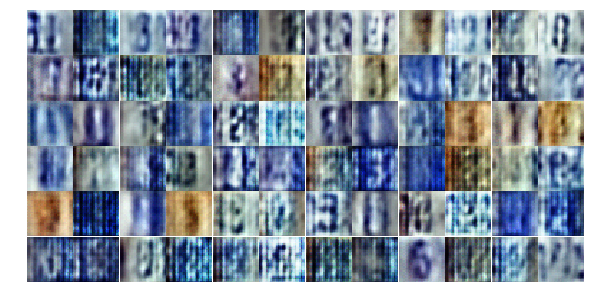

Epoch 3/25... Discriminator Loss: 0.7739... Generator Loss: 1.9440
Epoch 3/25... Discriminator Loss: 0.7277... Generator Loss: 0.8550
Epoch 3/25... Discriminator Loss: 0.4786... Generator Loss: 4.0488
Epoch 3/25... Discriminator Loss: 0.9582... Generator Loss: 0.7628
Epoch 3/25... Discriminator Loss: 0.9863... Generator Loss: 0.6130
Epoch 3/25... Discriminator Loss: 0.3550... Generator Loss: 2.2420
Epoch 3/25... Discriminator Loss: 0.7774... Generator Loss: 0.9121
Epoch 3/25... Discriminator Loss: 0.6932... Generator Loss: 2.2693
Epoch 3/25... Discriminator Loss: 0.5504... Generator Loss: 1.2275
Epoch 3/25... Discriminator Loss: 0.6806... Generator Loss: 1.0718


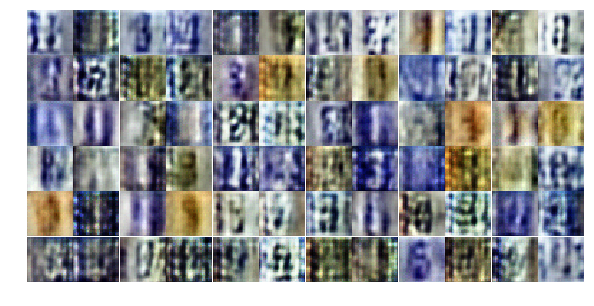

Epoch 3/25... Discriminator Loss: 0.1930... Generator Loss: 3.6810
Epoch 3/25... Discriminator Loss: 0.2662... Generator Loss: 3.6600
Epoch 3/25... Discriminator Loss: 0.2295... Generator Loss: 2.1048
Epoch 3/25... Discriminator Loss: 0.2236... Generator Loss: 2.4901
Epoch 3/25... Discriminator Loss: 0.5228... Generator Loss: 1.3619
Epoch 3/25... Discriminator Loss: 0.5035... Generator Loss: 1.7787
Epoch 3/25... Discriminator Loss: 0.4983... Generator Loss: 3.7246
Epoch 3/25... Discriminator Loss: 1.3883... Generator Loss: 5.5301
Epoch 3/25... Discriminator Loss: 0.1768... Generator Loss: 2.8061
Epoch 3/25... Discriminator Loss: 0.2897... Generator Loss: 2.7748


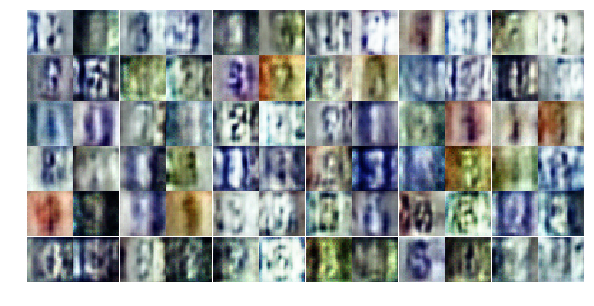

Epoch 3/25... Discriminator Loss: 0.9792... Generator Loss: 0.6516
Epoch 3/25... Discriminator Loss: 0.3020... Generator Loss: 2.5239
Epoch 3/25... Discriminator Loss: 0.5559... Generator Loss: 1.1076
Epoch 3/25... Discriminator Loss: 0.3944... Generator Loss: 4.7972
Epoch 3/25... Discriminator Loss: 0.4541... Generator Loss: 1.4796
Epoch 3/25... Discriminator Loss: 0.3998... Generator Loss: 1.7591
Epoch 3/25... Discriminator Loss: 0.4328... Generator Loss: 1.5689
Epoch 3/25... Discriminator Loss: 0.2739... Generator Loss: 1.8379
Epoch 3/25... Discriminator Loss: 0.3450... Generator Loss: 2.4576
Epoch 3/25... Discriminator Loss: 0.6088... Generator Loss: 1.1520


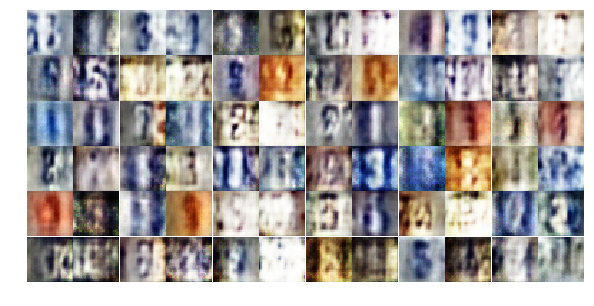

Epoch 3/25... Discriminator Loss: 0.2348... Generator Loss: 2.5634
Epoch 3/25... Discriminator Loss: 0.2599... Generator Loss: 4.5961
Epoch 3/25... Discriminator Loss: 0.5281... Generator Loss: 4.5618
Epoch 3/25... Discriminator Loss: 0.3946... Generator Loss: 3.4532
Epoch 3/25... Discriminator Loss: 0.2084... Generator Loss: 3.2688
Epoch 3/25... Discriminator Loss: 0.2418... Generator Loss: 4.8120
Epoch 3/25... Discriminator Loss: 0.2596... Generator Loss: 2.4180
Epoch 3/25... Discriminator Loss: 0.1050... Generator Loss: 3.6894
Epoch 3/25... Discriminator Loss: 1.2721... Generator Loss: 0.4852
Epoch 3/25... Discriminator Loss: 0.7003... Generator Loss: 4.0523


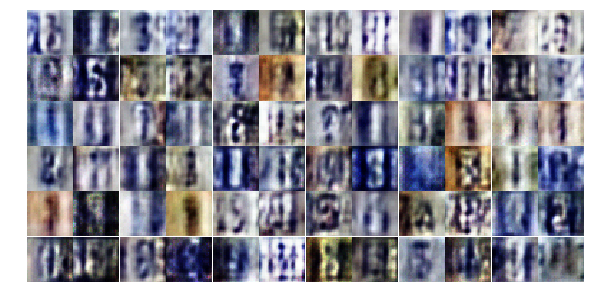

Epoch 3/25... Discriminator Loss: 0.2705... Generator Loss: 3.0190
Epoch 3/25... Discriminator Loss: 0.2514... Generator Loss: 2.8775
Epoch 3/25... Discriminator Loss: 1.2653... Generator Loss: 0.4268
Epoch 3/25... Discriminator Loss: 0.1442... Generator Loss: 2.7196
Epoch 3/25... Discriminator Loss: 0.1467... Generator Loss: 2.7445
Epoch 3/25... Discriminator Loss: 0.6156... Generator Loss: 0.9814
Epoch 3/25... Discriminator Loss: 0.8771... Generator Loss: 6.7679
Epoch 3/25... Discriminator Loss: 0.5983... Generator Loss: 1.1502
Epoch 3/25... Discriminator Loss: 0.9947... Generator Loss: 0.6405
Epoch 3/25... Discriminator Loss: 0.4728... Generator Loss: 1.4317


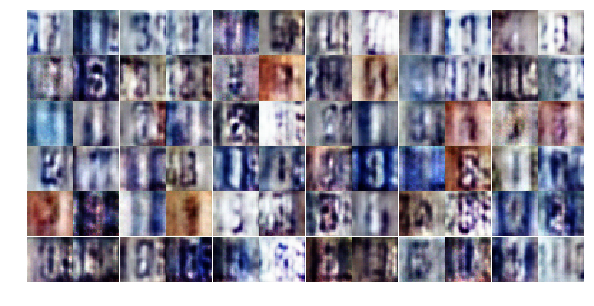

Epoch 3/25... Discriminator Loss: 0.1873... Generator Loss: 2.6940
Epoch 4/25... Discriminator Loss: 0.1888... Generator Loss: 2.6960
Epoch 4/25... Discriminator Loss: 0.2756... Generator Loss: 3.7079
Epoch 4/25... Discriminator Loss: 0.3273... Generator Loss: 4.7636
Epoch 4/25... Discriminator Loss: 0.1707... Generator Loss: 3.6889
Epoch 4/25... Discriminator Loss: 2.3455... Generator Loss: 7.3907
Epoch 4/25... Discriminator Loss: 1.2084... Generator Loss: 0.4639
Epoch 4/25... Discriminator Loss: 0.3378... Generator Loss: 1.8623
Epoch 4/25... Discriminator Loss: 0.2208... Generator Loss: 2.2058
Epoch 4/25... Discriminator Loss: 0.0704... Generator Loss: 5.4210


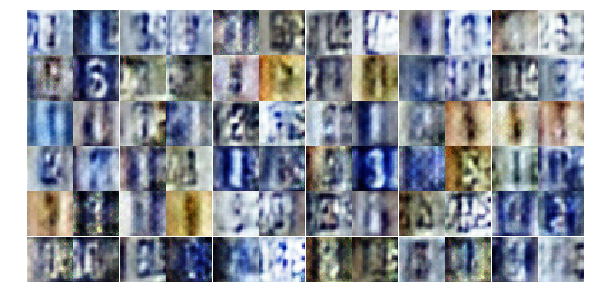

Epoch 4/25... Discriminator Loss: 0.2767... Generator Loss: 2.6016
Epoch 4/25... Discriminator Loss: 0.7936... Generator Loss: 0.8153
Epoch 4/25... Discriminator Loss: 0.2846... Generator Loss: 2.8477
Epoch 4/25... Discriminator Loss: 0.3113... Generator Loss: 2.0774
Epoch 4/25... Discriminator Loss: 0.0447... Generator Loss: 4.8185
Epoch 4/25... Discriminator Loss: 0.2251... Generator Loss: 2.1815
Epoch 4/25... Discriminator Loss: 0.4867... Generator Loss: 1.3187
Epoch 4/25... Discriminator Loss: 0.1320... Generator Loss: 5.2814
Epoch 4/25... Discriminator Loss: 0.5105... Generator Loss: 1.2105
Epoch 4/25... Discriminator Loss: 0.0742... Generator Loss: 5.6700


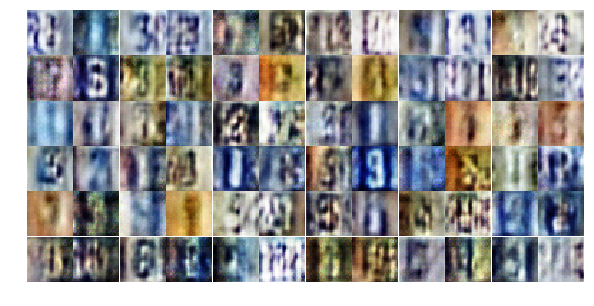

Epoch 4/25... Discriminator Loss: 0.6706... Generator Loss: 1.0066
Epoch 4/25... Discriminator Loss: 0.2289... Generator Loss: 2.0478
Epoch 4/25... Discriminator Loss: 0.2988... Generator Loss: 6.8364
Epoch 4/25... Discriminator Loss: 0.0926... Generator Loss: 4.4859
Epoch 4/25... Discriminator Loss: 0.0851... Generator Loss: 5.0789
Epoch 4/25... Discriminator Loss: 0.1334... Generator Loss: 4.5091
Epoch 4/25... Discriminator Loss: 0.6873... Generator Loss: 1.0025
Epoch 4/25... Discriminator Loss: 0.8494... Generator Loss: 1.0899
Epoch 4/25... Discriminator Loss: 0.2037... Generator Loss: 6.3182
Epoch 4/25... Discriminator Loss: 0.3358... Generator Loss: 2.1544


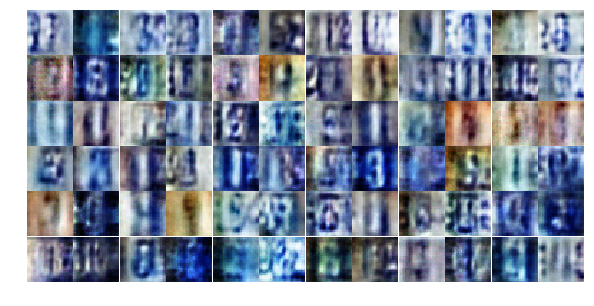

Epoch 4/25... Discriminator Loss: 0.2223... Generator Loss: 2.2327
Epoch 4/25... Discriminator Loss: 0.2727... Generator Loss: 2.0134
Epoch 4/25... Discriminator Loss: 0.5134... Generator Loss: 2.0308
Epoch 4/25... Discriminator Loss: 0.3301... Generator Loss: 5.5229
Epoch 4/25... Discriminator Loss: 0.2496... Generator Loss: 6.8116
Epoch 4/25... Discriminator Loss: 0.3047... Generator Loss: 1.8559
Epoch 4/25... Discriminator Loss: 0.2036... Generator Loss: 2.6060
Epoch 4/25... Discriminator Loss: 0.4877... Generator Loss: 1.2479
Epoch 4/25... Discriminator Loss: 1.4079... Generator Loss: 0.4019
Epoch 4/25... Discriminator Loss: 0.5585... Generator Loss: 1.1173


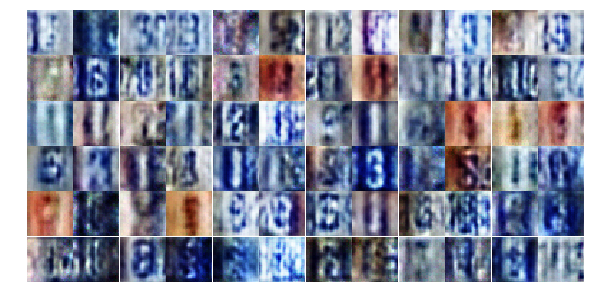

Epoch 4/25... Discriminator Loss: 0.2027... Generator Loss: 5.8901
Epoch 4/25... Discriminator Loss: 0.3213... Generator Loss: 4.6481
Epoch 4/25... Discriminator Loss: 1.4414... Generator Loss: 0.3887
Epoch 4/25... Discriminator Loss: 1.2921... Generator Loss: 2.1003
Epoch 4/25... Discriminator Loss: 0.4343... Generator Loss: 1.7893
Epoch 4/25... Discriminator Loss: 0.2921... Generator Loss: 2.3782
Epoch 4/25... Discriminator Loss: 0.4991... Generator Loss: 1.5425
Epoch 4/25... Discriminator Loss: 0.4925... Generator Loss: 3.1259
Epoch 4/25... Discriminator Loss: 0.5363... Generator Loss: 3.9215
Epoch 4/25... Discriminator Loss: 0.3421... Generator Loss: 1.9496


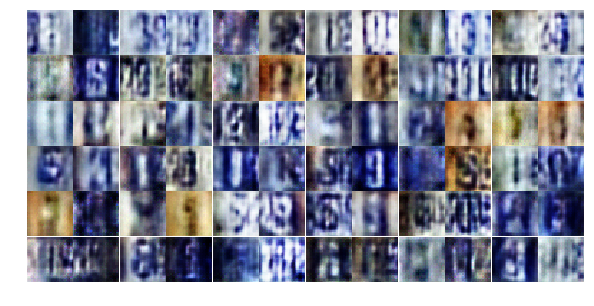

Epoch 4/25... Discriminator Loss: 0.1473... Generator Loss: 3.7592
Epoch 4/25... Discriminator Loss: 0.1317... Generator Loss: 3.0015
Epoch 4/25... Discriminator Loss: 0.2680... Generator Loss: 5.2314
Epoch 4/25... Discriminator Loss: 0.0774... Generator Loss: 4.5898
Epoch 4/25... Discriminator Loss: 0.5247... Generator Loss: 4.3385
Epoch 4/25... Discriminator Loss: 0.7900... Generator Loss: 0.8048
Epoch 4/25... Discriminator Loss: 1.1319... Generator Loss: 0.6855
Epoch 4/25... Discriminator Loss: 0.7000... Generator Loss: 4.5049
Epoch 4/25... Discriminator Loss: 0.9856... Generator Loss: 0.5912
Epoch 5/25... Discriminator Loss: 0.9868... Generator Loss: 0.7351


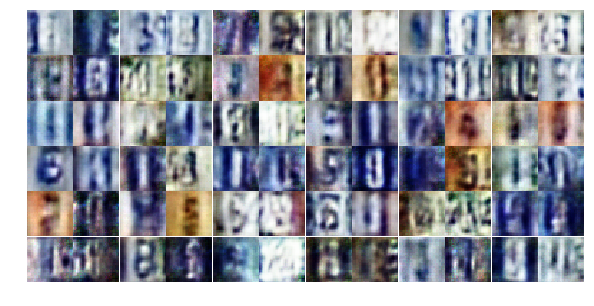

Epoch 5/25... Discriminator Loss: 0.8381... Generator Loss: 1.7850
Epoch 5/25... Discriminator Loss: 0.1929... Generator Loss: 2.7510
Epoch 5/25... Discriminator Loss: 0.1980... Generator Loss: 2.9471
Epoch 5/25... Discriminator Loss: 0.2272... Generator Loss: 2.9671
Epoch 5/25... Discriminator Loss: 0.1421... Generator Loss: 3.3175
Epoch 5/25... Discriminator Loss: 1.0505... Generator Loss: 7.8394
Epoch 5/25... Discriminator Loss: 1.1432... Generator Loss: 1.8769
Epoch 5/25... Discriminator Loss: 0.4885... Generator Loss: 1.4403
Epoch 5/25... Discriminator Loss: 0.7236... Generator Loss: 0.9931
Epoch 5/25... Discriminator Loss: 0.5684... Generator Loss: 1.1721


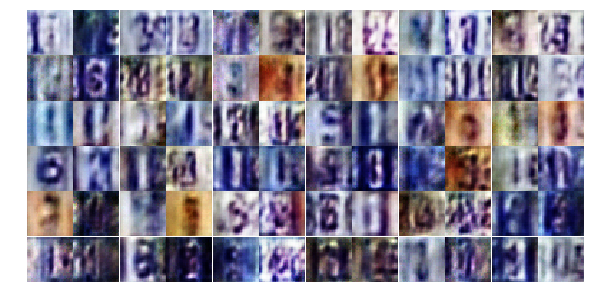

Epoch 5/25... Discriminator Loss: 0.5143... Generator Loss: 1.1675
Epoch 5/25... Discriminator Loss: 0.0804... Generator Loss: 5.1381
Epoch 5/25... Discriminator Loss: 0.7947... Generator Loss: 0.7758
Epoch 5/25... Discriminator Loss: 0.3380... Generator Loss: 4.2940
Epoch 5/25... Discriminator Loss: 0.3009... Generator Loss: 1.8438
Epoch 5/25... Discriminator Loss: 0.4606... Generator Loss: 2.9356
Epoch 5/25... Discriminator Loss: 0.2614... Generator Loss: 3.7177
Epoch 5/25... Discriminator Loss: 0.8768... Generator Loss: 0.8144
Epoch 5/25... Discriminator Loss: 0.2782... Generator Loss: 2.9362
Epoch 5/25... Discriminator Loss: 0.6164... Generator Loss: 1.0204


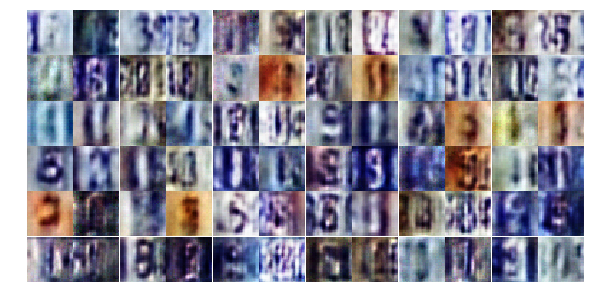

Epoch 5/25... Discriminator Loss: 0.5706... Generator Loss: 1.0934
Epoch 5/25... Discriminator Loss: 0.5596... Generator Loss: 2.7624
Epoch 5/25... Discriminator Loss: 0.2066... Generator Loss: 2.8694
Epoch 5/25... Discriminator Loss: 0.1418... Generator Loss: 3.5431
Epoch 5/25... Discriminator Loss: 0.2809... Generator Loss: 2.6135
Epoch 5/25... Discriminator Loss: 0.1639... Generator Loss: 5.8929
Epoch 5/25... Discriminator Loss: 0.5571... Generator Loss: 1.2000
Epoch 5/25... Discriminator Loss: 0.2284... Generator Loss: 6.8880
Epoch 5/25... Discriminator Loss: 0.2922... Generator Loss: 1.8974
Epoch 5/25... Discriminator Loss: 0.3087... Generator Loss: 1.8326


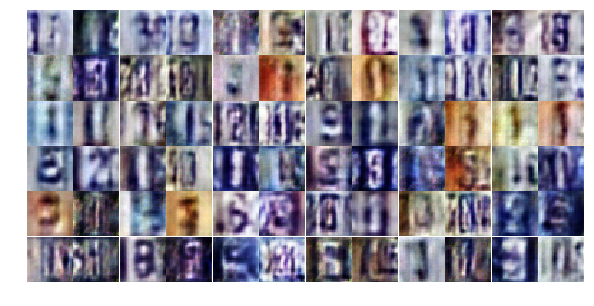

Epoch 5/25... Discriminator Loss: 1.0808... Generator Loss: 0.5639
Epoch 5/25... Discriminator Loss: 0.1391... Generator Loss: 3.9068
Epoch 5/25... Discriminator Loss: 0.2661... Generator Loss: 2.0131
Epoch 5/25... Discriminator Loss: 0.1467... Generator Loss: 6.9513
Epoch 5/25... Discriminator Loss: 1.2057... Generator Loss: 0.5141
Epoch 5/25... Discriminator Loss: 0.1505... Generator Loss: 3.1376
Epoch 5/25... Discriminator Loss: 0.3752... Generator Loss: 4.2198
Epoch 5/25... Discriminator Loss: 0.0587... Generator Loss: 5.4153
Epoch 5/25... Discriminator Loss: 0.3059... Generator Loss: 2.3505
Epoch 5/25... Discriminator Loss: 0.2154... Generator Loss: 4.3901


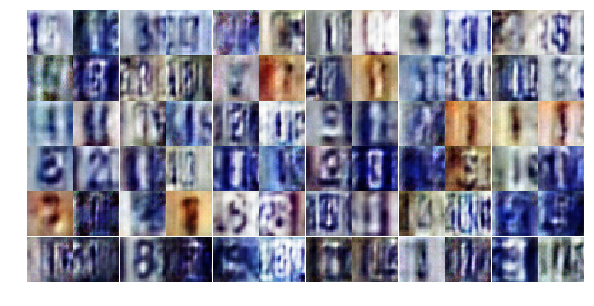

Epoch 5/25... Discriminator Loss: 1.0288... Generator Loss: 0.6673
Epoch 5/25... Discriminator Loss: 2.8788... Generator Loss: 6.1170
Epoch 5/25... Discriminator Loss: 0.7718... Generator Loss: 0.8417
Epoch 5/25... Discriminator Loss: 0.2590... Generator Loss: 2.8246
Epoch 5/25... Discriminator Loss: 0.7182... Generator Loss: 1.0021
Epoch 5/25... Discriminator Loss: 1.8921... Generator Loss: 0.2410
Epoch 5/25... Discriminator Loss: 0.2051... Generator Loss: 3.5897
Epoch 5/25... Discriminator Loss: 0.5282... Generator Loss: 1.2181
Epoch 5/25... Discriminator Loss: 0.9349... Generator Loss: 0.6492
Epoch 5/25... Discriminator Loss: 0.2993... Generator Loss: 3.3986


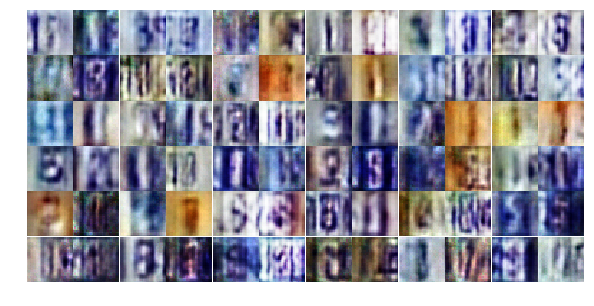

Epoch 5/25... Discriminator Loss: 0.3494... Generator Loss: 3.4023
Epoch 5/25... Discriminator Loss: 0.1680... Generator Loss: 2.8151
Epoch 5/25... Discriminator Loss: 0.2990... Generator Loss: 1.8062
Epoch 5/25... Discriminator Loss: 0.4459... Generator Loss: 1.4407
Epoch 5/25... Discriminator Loss: 0.1005... Generator Loss: 3.8990
Epoch 5/25... Discriminator Loss: 0.0909... Generator Loss: 3.7883
Epoch 6/25... Discriminator Loss: 0.3127... Generator Loss: 2.0402
Epoch 6/25... Discriminator Loss: 1.1683... Generator Loss: 1.9954
Epoch 6/25... Discriminator Loss: 0.9023... Generator Loss: 2.1702
Epoch 6/25... Discriminator Loss: 0.8517... Generator Loss: 0.7523


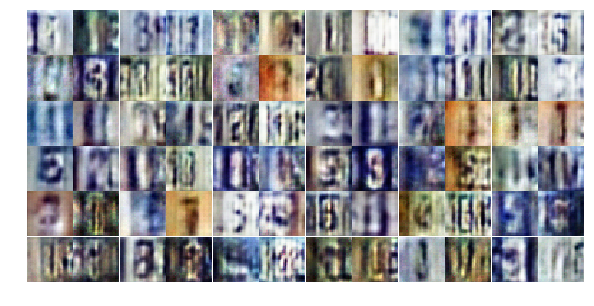

Epoch 6/25... Discriminator Loss: 0.1445... Generator Loss: 5.3295
Epoch 6/25... Discriminator Loss: 0.5225... Generator Loss: 1.2862
Epoch 6/25... Discriminator Loss: 0.4837... Generator Loss: 1.4240
Epoch 6/25... Discriminator Loss: 0.6735... Generator Loss: 0.9302
Epoch 6/25... Discriminator Loss: 0.2788... Generator Loss: 4.3468
Epoch 6/25... Discriminator Loss: 0.5553... Generator Loss: 1.1521
Epoch 6/25... Discriminator Loss: 0.9036... Generator Loss: 0.7380
Epoch 6/25... Discriminator Loss: 0.2495... Generator Loss: 2.5418
Epoch 6/25... Discriminator Loss: 0.5151... Generator Loss: 1.1927
Epoch 6/25... Discriminator Loss: 0.2687... Generator Loss: 2.2613


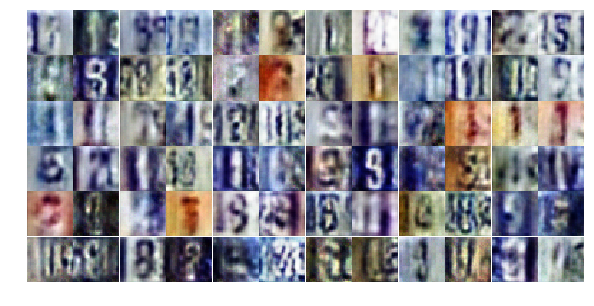

Epoch 6/25... Discriminator Loss: 0.1168... Generator Loss: 3.7629
Epoch 6/25... Discriminator Loss: 0.2790... Generator Loss: 2.9833
Epoch 6/25... Discriminator Loss: 2.2413... Generator Loss: 0.2851
Epoch 6/25... Discriminator Loss: 0.4436... Generator Loss: 2.7065
Epoch 6/25... Discriminator Loss: 0.7182... Generator Loss: 0.8612
Epoch 6/25... Discriminator Loss: 0.2545... Generator Loss: 2.0086
Epoch 6/25... Discriminator Loss: 0.3922... Generator Loss: 1.4380
Epoch 6/25... Discriminator Loss: 0.3063... Generator Loss: 1.7768
Epoch 6/25... Discriminator Loss: 0.2372... Generator Loss: 4.6919
Epoch 6/25... Discriminator Loss: 0.3758... Generator Loss: 1.6795


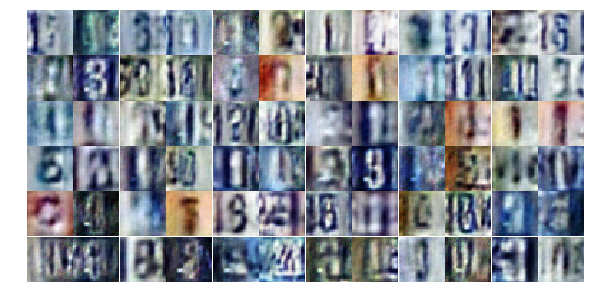

Epoch 6/25... Discriminator Loss: 0.2401... Generator Loss: 2.1087
Epoch 6/25... Discriminator Loss: 0.1178... Generator Loss: 3.5126
Epoch 6/25... Discriminator Loss: 2.4792... Generator Loss: 0.1427
Epoch 6/25... Discriminator Loss: 1.1656... Generator Loss: 0.5116
Epoch 6/25... Discriminator Loss: 0.2569... Generator Loss: 3.0430
Epoch 6/25... Discriminator Loss: 0.4324... Generator Loss: 1.6847
Epoch 6/25... Discriminator Loss: 0.4130... Generator Loss: 1.5469
Epoch 6/25... Discriminator Loss: 0.2877... Generator Loss: 1.8668
Epoch 6/25... Discriminator Loss: 0.1124... Generator Loss: 3.2918
Epoch 6/25... Discriminator Loss: 0.7723... Generator Loss: 0.8169


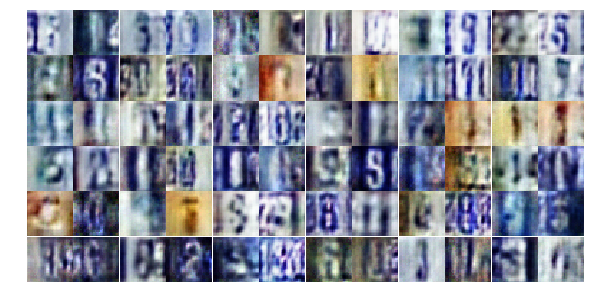

Epoch 6/25... Discriminator Loss: 0.7318... Generator Loss: 1.0176
Epoch 6/25... Discriminator Loss: 0.5896... Generator Loss: 2.6407
Epoch 6/25... Discriminator Loss: 0.3491... Generator Loss: 1.7604
Epoch 6/25... Discriminator Loss: 0.5880... Generator Loss: 1.1152
Epoch 6/25... Discriminator Loss: 0.0848... Generator Loss: 4.5889
Epoch 6/25... Discriminator Loss: 0.3514... Generator Loss: 1.6587
Epoch 6/25... Discriminator Loss: 0.2969... Generator Loss: 1.9853
Epoch 6/25... Discriminator Loss: 0.5858... Generator Loss: 1.0135
Epoch 6/25... Discriminator Loss: 0.1219... Generator Loss: 4.0006
Epoch 6/25... Discriminator Loss: 0.1141... Generator Loss: 4.0876


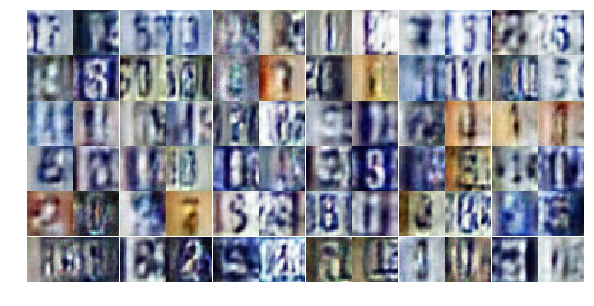

Epoch 6/25... Discriminator Loss: 0.1690... Generator Loss: 2.6312
Epoch 6/25... Discriminator Loss: 0.3923... Generator Loss: 1.4534
Epoch 6/25... Discriminator Loss: 0.2419... Generator Loss: 2.4636
Epoch 6/25... Discriminator Loss: 0.9138... Generator Loss: 0.6733
Epoch 6/25... Discriminator Loss: 1.8678... Generator Loss: 2.9359
Epoch 6/25... Discriminator Loss: 0.2533... Generator Loss: 2.5530
Epoch 6/25... Discriminator Loss: 0.2439... Generator Loss: 2.5020
Epoch 6/25... Discriminator Loss: 0.2909... Generator Loss: 1.7376
Epoch 6/25... Discriminator Loss: 0.3215... Generator Loss: 4.9114
Epoch 6/25... Discriminator Loss: 0.4117... Generator Loss: 1.5765


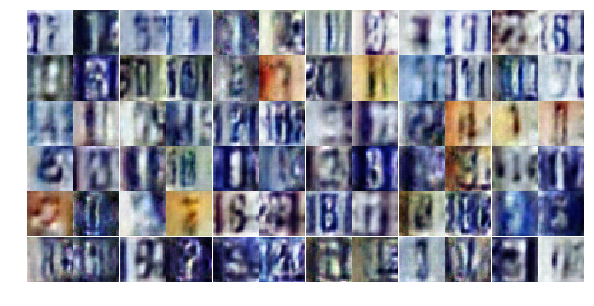

Epoch 6/25... Discriminator Loss: 0.6012... Generator Loss: 1.0309
Epoch 6/25... Discriminator Loss: 0.1801... Generator Loss: 2.8496
Epoch 6/25... Discriminator Loss: 0.4036... Generator Loss: 1.5016
Epoch 7/25... Discriminator Loss: 0.3402... Generator Loss: 1.9046
Epoch 7/25... Discriminator Loss: 0.6553... Generator Loss: 0.9507
Epoch 7/25... Discriminator Loss: 0.0484... Generator Loss: 4.8548
Epoch 7/25... Discriminator Loss: 0.5201... Generator Loss: 1.3224
Epoch 7/25... Discriminator Loss: 0.1355... Generator Loss: 2.9511
Epoch 7/25... Discriminator Loss: 0.1889... Generator Loss: 2.4551
Epoch 7/25... Discriminator Loss: 0.2264... Generator Loss: 2.2252


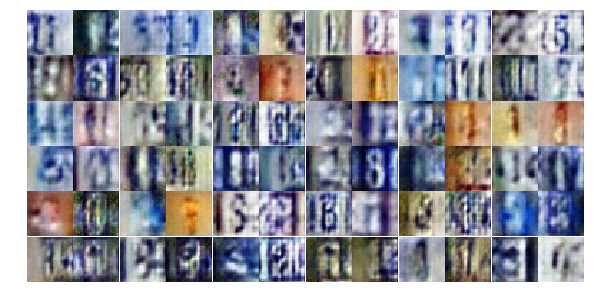

Epoch 7/25... Discriminator Loss: 0.3193... Generator Loss: 5.0047
Epoch 7/25... Discriminator Loss: 0.2368... Generator Loss: 2.3595
Epoch 7/25... Discriminator Loss: 0.2202... Generator Loss: 2.4023
Epoch 7/25... Discriminator Loss: 0.1891... Generator Loss: 2.8768
Epoch 7/25... Discriminator Loss: 0.6554... Generator Loss: 1.1354
Epoch 7/25... Discriminator Loss: 0.1959... Generator Loss: 2.7026
Epoch 7/25... Discriminator Loss: 0.7632... Generator Loss: 0.8480
Epoch 7/25... Discriminator Loss: 0.6051... Generator Loss: 1.0504
Epoch 7/25... Discriminator Loss: 0.1477... Generator Loss: 2.6422
Epoch 7/25... Discriminator Loss: 2.3421... Generator Loss: 0.2670


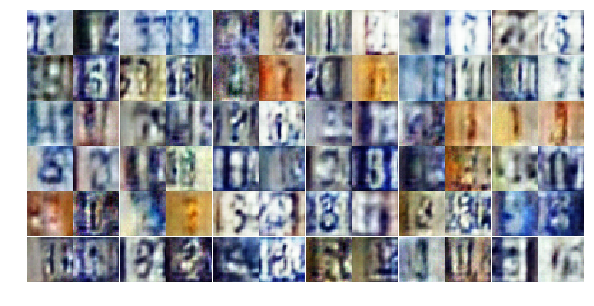

Epoch 7/25... Discriminator Loss: 0.5925... Generator Loss: 1.6250
Epoch 7/25... Discriminator Loss: 0.3128... Generator Loss: 1.8876
Epoch 7/25... Discriminator Loss: 0.6054... Generator Loss: 1.0382
Epoch 7/25... Discriminator Loss: 0.2115... Generator Loss: 2.6781
Epoch 7/25... Discriminator Loss: 0.1983... Generator Loss: 3.1566
Epoch 7/25... Discriminator Loss: 0.2767... Generator Loss: 1.8953
Epoch 7/25... Discriminator Loss: 0.1981... Generator Loss: 2.4773
Epoch 7/25... Discriminator Loss: 0.5826... Generator Loss: 1.0862
Epoch 7/25... Discriminator Loss: 0.0906... Generator Loss: 4.1904
Epoch 7/25... Discriminator Loss: 0.1029... Generator Loss: 4.5937


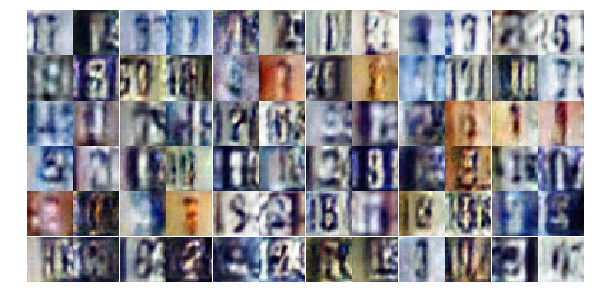

Epoch 7/25... Discriminator Loss: 0.4797... Generator Loss: 1.2642
Epoch 7/25... Discriminator Loss: 2.2850... Generator Loss: 0.2204
Epoch 7/25... Discriminator Loss: 1.0118... Generator Loss: 0.7373
Epoch 7/25... Discriminator Loss: 1.0190... Generator Loss: 2.9389
Epoch 7/25... Discriminator Loss: 1.1848... Generator Loss: 0.5424
Epoch 7/25... Discriminator Loss: 0.5540... Generator Loss: 1.3325
Epoch 7/25... Discriminator Loss: 0.7337... Generator Loss: 0.8909
Epoch 7/25... Discriminator Loss: 0.3482... Generator Loss: 1.9588
Epoch 7/25... Discriminator Loss: 1.0585... Generator Loss: 0.6093
Epoch 7/25... Discriminator Loss: 0.3467... Generator Loss: 3.7043


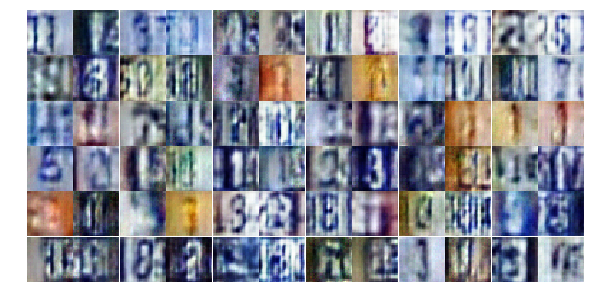

Epoch 7/25... Discriminator Loss: 0.9863... Generator Loss: 0.6372
Epoch 7/25... Discriminator Loss: 0.4714... Generator Loss: 1.3176
Epoch 7/25... Discriminator Loss: 0.3081... Generator Loss: 1.8319
Epoch 7/25... Discriminator Loss: 0.2412... Generator Loss: 2.0276
Epoch 7/25... Discriminator Loss: 0.3807... Generator Loss: 1.6217
Epoch 7/25... Discriminator Loss: 0.1712... Generator Loss: 2.6023
Epoch 7/25... Discriminator Loss: 0.1798... Generator Loss: 2.4399
Epoch 7/25... Discriminator Loss: 0.1423... Generator Loss: 2.8016
Epoch 7/25... Discriminator Loss: 0.2040... Generator Loss: 2.7066
Epoch 7/25... Discriminator Loss: 0.3661... Generator Loss: 1.7628


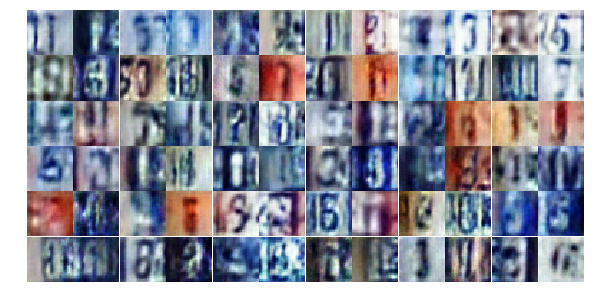

Epoch 7/25... Discriminator Loss: 0.2441... Generator Loss: 3.0139
Epoch 7/25... Discriminator Loss: 0.6415... Generator Loss: 1.0752
Epoch 7/25... Discriminator Loss: 0.1878... Generator Loss: 2.9170
Epoch 7/25... Discriminator Loss: 0.2218... Generator Loss: 2.2792
Epoch 7/25... Discriminator Loss: 0.6136... Generator Loss: 1.0419
Epoch 7/25... Discriminator Loss: 0.6119... Generator Loss: 1.1153
Epoch 7/25... Discriminator Loss: 0.5313... Generator Loss: 1.1969
Epoch 7/25... Discriminator Loss: 2.2583... Generator Loss: 0.3884
Epoch 7/25... Discriminator Loss: 0.4349... Generator Loss: 2.9658
Epoch 7/25... Discriminator Loss: 0.5376... Generator Loss: 1.4810


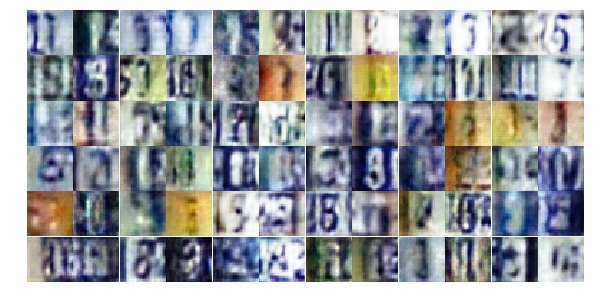

Epoch 7/25... Discriminator Loss: 0.7737... Generator Loss: 0.8856
Epoch 8/25... Discriminator Loss: 0.7521... Generator Loss: 1.0481
Epoch 8/25... Discriminator Loss: 1.0082... Generator Loss: 0.6340
Epoch 8/25... Discriminator Loss: 0.2493... Generator Loss: 2.5457
Epoch 8/25... Discriminator Loss: 0.2569... Generator Loss: 2.0942
Epoch 8/25... Discriminator Loss: 0.4531... Generator Loss: 1.3099
Epoch 8/25... Discriminator Loss: 0.3502... Generator Loss: 1.5572
Epoch 8/25... Discriminator Loss: 0.1177... Generator Loss: 3.0001
Epoch 8/25... Discriminator Loss: 0.5526... Generator Loss: 1.1938
Epoch 8/25... Discriminator Loss: 0.5478... Generator Loss: 1.1398


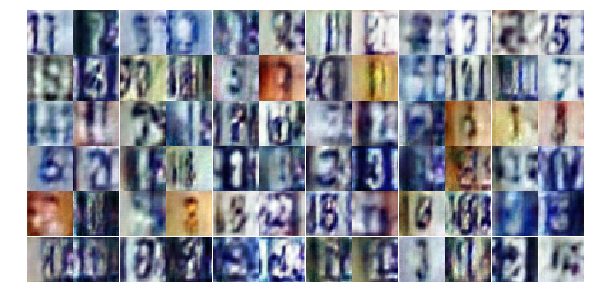

Epoch 8/25... Discriminator Loss: 0.2232... Generator Loss: 2.1623
Epoch 8/25... Discriminator Loss: 0.2464... Generator Loss: 2.0488
Epoch 8/25... Discriminator Loss: 0.6100... Generator Loss: 1.0788
Epoch 8/25... Discriminator Loss: 0.2589... Generator Loss: 1.8894
Epoch 8/25... Discriminator Loss: 0.1839... Generator Loss: 2.8673
Epoch 8/25... Discriminator Loss: 1.2504... Generator Loss: 3.3645
Epoch 8/25... Discriminator Loss: 0.1969... Generator Loss: 3.4768
Epoch 8/25... Discriminator Loss: 0.3427... Generator Loss: 1.7504
Epoch 8/25... Discriminator Loss: 0.2168... Generator Loss: 2.2779
Epoch 8/25... Discriminator Loss: 1.0515... Generator Loss: 0.5609


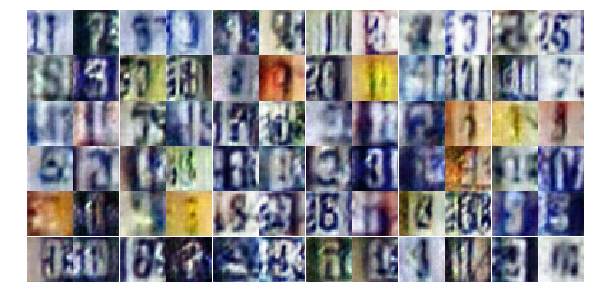

Epoch 8/25... Discriminator Loss: 0.1425... Generator Loss: 3.4211
Epoch 8/25... Discriminator Loss: 0.2482... Generator Loss: 2.3505
Epoch 8/25... Discriminator Loss: 0.5482... Generator Loss: 1.3427
Epoch 8/25... Discriminator Loss: 0.1623... Generator Loss: 2.5532
Epoch 8/25... Discriminator Loss: 0.0849... Generator Loss: 3.4332
Epoch 8/25... Discriminator Loss: 0.3526... Generator Loss: 2.0169
Epoch 8/25... Discriminator Loss: 0.9540... Generator Loss: 8.1808
Epoch 8/25... Discriminator Loss: 0.3598... Generator Loss: 1.7642
Epoch 8/25... Discriminator Loss: 1.5072... Generator Loss: 5.4416
Epoch 8/25... Discriminator Loss: 0.3734... Generator Loss: 1.6447


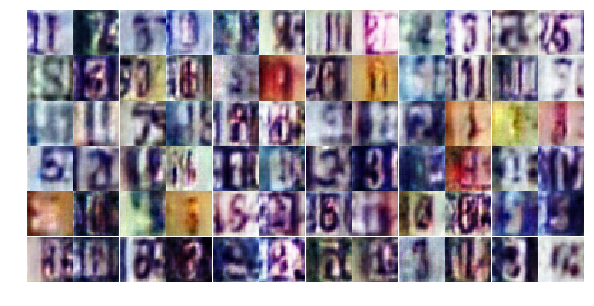

Epoch 8/25... Discriminator Loss: 0.3733... Generator Loss: 2.0544
Epoch 8/25... Discriminator Loss: 0.4046... Generator Loss: 1.4938
Epoch 8/25... Discriminator Loss: 0.4225... Generator Loss: 3.1934
Epoch 8/25... Discriminator Loss: 0.3592... Generator Loss: 1.6572
Epoch 8/25... Discriminator Loss: 0.1948... Generator Loss: 2.8245
Epoch 8/25... Discriminator Loss: 0.2236... Generator Loss: 2.0470
Epoch 8/25... Discriminator Loss: 0.2356... Generator Loss: 2.3457
Epoch 8/25... Discriminator Loss: 0.1291... Generator Loss: 4.6665
Epoch 8/25... Discriminator Loss: 0.1651... Generator Loss: 2.5519
Epoch 8/25... Discriminator Loss: 0.1076... Generator Loss: 4.8634


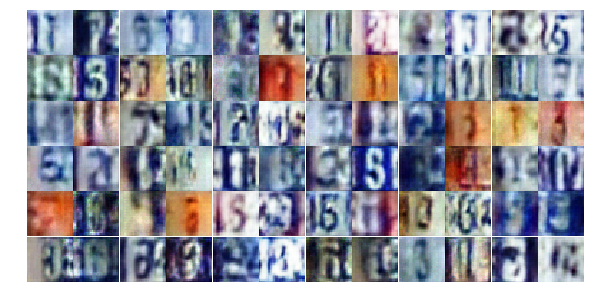

Epoch 8/25... Discriminator Loss: 0.2416... Generator Loss: 1.9667
Epoch 8/25... Discriminator Loss: 0.1217... Generator Loss: 3.8515
Epoch 8/25... Discriminator Loss: 0.1047... Generator Loss: 3.5549
Epoch 8/25... Discriminator Loss: 0.2033... Generator Loss: 3.9988
Epoch 8/25... Discriminator Loss: 0.6754... Generator Loss: 3.4432
Epoch 8/25... Discriminator Loss: 2.0797... Generator Loss: 4.6831
Epoch 8/25... Discriminator Loss: 0.5203... Generator Loss: 2.2985
Epoch 8/25... Discriminator Loss: 0.2522... Generator Loss: 3.6859
Epoch 8/25... Discriminator Loss: 0.1400... Generator Loss: 3.0201
Epoch 8/25... Discriminator Loss: 0.5480... Generator Loss: 1.3356


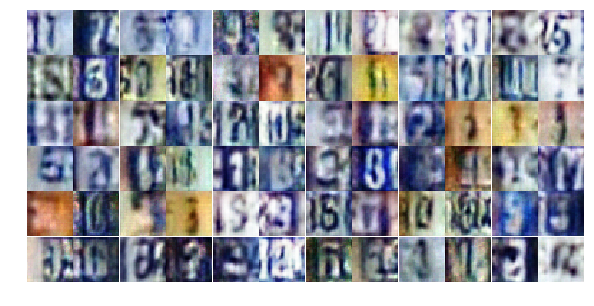

Epoch 8/25... Discriminator Loss: 0.2280... Generator Loss: 2.4443
Epoch 8/25... Discriminator Loss: 0.1309... Generator Loss: 3.7515
Epoch 8/25... Discriminator Loss: 0.2123... Generator Loss: 2.8235
Epoch 8/25... Discriminator Loss: 0.8480... Generator Loss: 0.8579
Epoch 8/25... Discriminator Loss: 0.1694... Generator Loss: 3.3212
Epoch 8/25... Discriminator Loss: 0.8873... Generator Loss: 0.7520
Epoch 8/25... Discriminator Loss: 0.2424... Generator Loss: 2.2332
Epoch 8/25... Discriminator Loss: 0.4887... Generator Loss: 1.3375
Epoch 9/25... Discriminator Loss: 0.5890... Generator Loss: 1.0313
Epoch 9/25... Discriminator Loss: 0.2067... Generator Loss: 2.4269


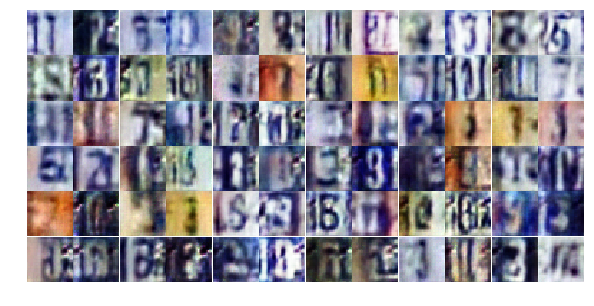

Epoch 9/25... Discriminator Loss: 0.3979... Generator Loss: 1.4616
Epoch 9/25... Discriminator Loss: 0.1484... Generator Loss: 3.1064
Epoch 9/25... Discriminator Loss: 0.3185... Generator Loss: 1.8049
Epoch 9/25... Discriminator Loss: 0.1384... Generator Loss: 2.5584
Epoch 9/25... Discriminator Loss: 0.1294... Generator Loss: 4.1555
Epoch 9/25... Discriminator Loss: 0.4737... Generator Loss: 4.3727
Epoch 9/25... Discriminator Loss: 0.2096... Generator Loss: 3.0574
Epoch 9/25... Discriminator Loss: 0.2196... Generator Loss: 2.2653
Epoch 9/25... Discriminator Loss: 0.7609... Generator Loss: 3.0132
Epoch 9/25... Discriminator Loss: 0.7411... Generator Loss: 0.9861


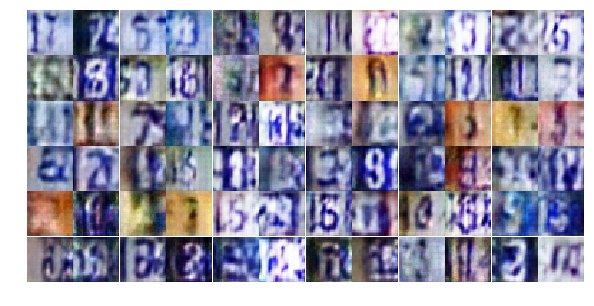

Epoch 9/25... Discriminator Loss: 0.3098... Generator Loss: 5.6292
Epoch 9/25... Discriminator Loss: 0.4094... Generator Loss: 1.5757
Epoch 9/25... Discriminator Loss: 0.1737... Generator Loss: 2.4863
Epoch 9/25... Discriminator Loss: 0.1741... Generator Loss: 3.7082
Epoch 9/25... Discriminator Loss: 0.3138... Generator Loss: 1.7450
Epoch 9/25... Discriminator Loss: 0.7115... Generator Loss: 0.8458
Epoch 9/25... Discriminator Loss: 0.5643... Generator Loss: 1.1636
Epoch 9/25... Discriminator Loss: 0.2033... Generator Loss: 2.5561
Epoch 9/25... Discriminator Loss: 0.2283... Generator Loss: 2.4422
Epoch 9/25... Discriminator Loss: 0.0926... Generator Loss: 3.9564


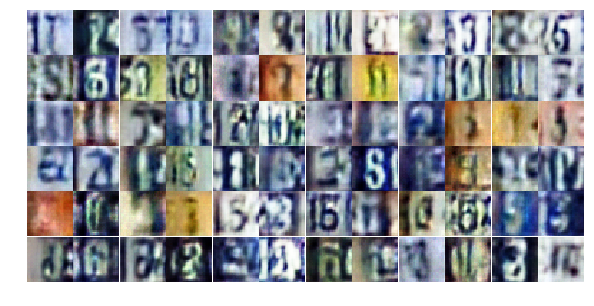

Epoch 9/25... Discriminator Loss: 0.1637... Generator Loss: 3.7231
Epoch 9/25... Discriminator Loss: 0.1541... Generator Loss: 3.3029
Epoch 9/25... Discriminator Loss: 0.3429... Generator Loss: 4.0114
Epoch 9/25... Discriminator Loss: 0.4020... Generator Loss: 1.4532
Epoch 9/25... Discriminator Loss: 0.3059... Generator Loss: 1.9507
Epoch 9/25... Discriminator Loss: 1.1532... Generator Loss: 0.6259
Epoch 9/25... Discriminator Loss: 1.6127... Generator Loss: 0.4685
Epoch 9/25... Discriminator Loss: 0.3039... Generator Loss: 3.3858
Epoch 9/25... Discriminator Loss: 0.2005... Generator Loss: 3.4587
Epoch 9/25... Discriminator Loss: 0.2708... Generator Loss: 2.1626


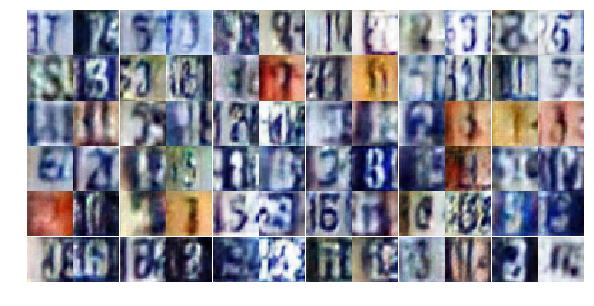

Epoch 9/25... Discriminator Loss: 0.3088... Generator Loss: 1.9051
Epoch 9/25... Discriminator Loss: 0.3319... Generator Loss: 2.8988
Epoch 9/25... Discriminator Loss: 0.6010... Generator Loss: 1.6742
Epoch 9/25... Discriminator Loss: 0.1295... Generator Loss: 2.7632
Epoch 9/25... Discriminator Loss: 0.4754... Generator Loss: 1.3693
Epoch 9/25... Discriminator Loss: 0.2113... Generator Loss: 2.4380
Epoch 9/25... Discriminator Loss: 0.1603... Generator Loss: 2.5127
Epoch 9/25... Discriminator Loss: 0.1236... Generator Loss: 3.7805
Epoch 9/25... Discriminator Loss: 0.6995... Generator Loss: 0.9031
Epoch 9/25... Discriminator Loss: 0.2772... Generator Loss: 1.8384


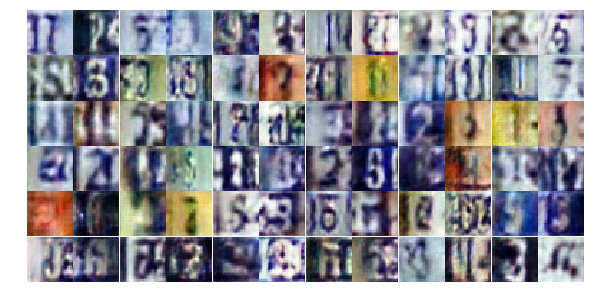

Epoch 9/25... Discriminator Loss: 0.4619... Generator Loss: 1.4246
Epoch 9/25... Discriminator Loss: 0.1697... Generator Loss: 3.4580
Epoch 9/25... Discriminator Loss: 0.1994... Generator Loss: 2.2715
Epoch 9/25... Discriminator Loss: 0.1370... Generator Loss: 3.5096
Epoch 9/25... Discriminator Loss: 0.7641... Generator Loss: 4.5885
Epoch 9/25... Discriminator Loss: 1.4204... Generator Loss: 0.4860
Epoch 9/25... Discriminator Loss: 0.6143... Generator Loss: 1.2270
Epoch 9/25... Discriminator Loss: 1.1472... Generator Loss: 0.5247
Epoch 9/25... Discriminator Loss: 0.5210... Generator Loss: 1.5084
Epoch 9/25... Discriminator Loss: 0.3570... Generator Loss: 3.1251


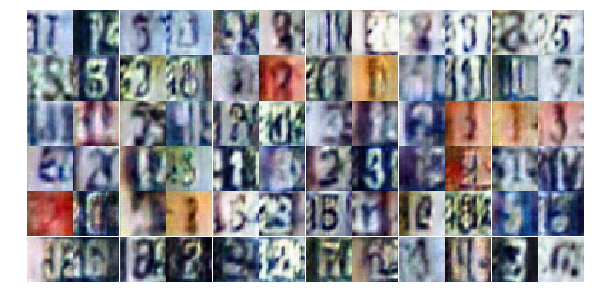

Epoch 9/25... Discriminator Loss: 1.9003... Generator Loss: 0.2652
Epoch 9/25... Discriminator Loss: 1.1241... Generator Loss: 0.5398
Epoch 9/25... Discriminator Loss: 0.2037... Generator Loss: 2.8450
Epoch 9/25... Discriminator Loss: 1.3834... Generator Loss: 0.4197
Epoch 9/25... Discriminator Loss: 0.2346... Generator Loss: 2.2346
Epoch 10/25... Discriminator Loss: 0.1967... Generator Loss: 2.6541
Epoch 10/25... Discriminator Loss: 0.4298... Generator Loss: 1.4294
Epoch 10/25... Discriminator Loss: 0.1577... Generator Loss: 3.0698
Epoch 10/25... Discriminator Loss: 0.3658... Generator Loss: 1.6550
Epoch 10/25... Discriminator Loss: 0.2537... Generator Loss: 2.0930


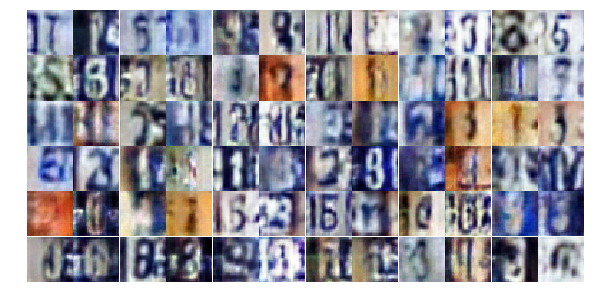

Epoch 10/25... Discriminator Loss: 0.5706... Generator Loss: 1.2580
Epoch 10/25... Discriminator Loss: 1.0408... Generator Loss: 0.6290
Epoch 10/25... Discriminator Loss: 0.1736... Generator Loss: 2.8376
Epoch 10/25... Discriminator Loss: 0.2743... Generator Loss: 1.8615
Epoch 10/25... Discriminator Loss: 0.1625... Generator Loss: 3.8806
Epoch 10/25... Discriminator Loss: 1.4200... Generator Loss: 0.3908
Epoch 10/25... Discriminator Loss: 0.5635... Generator Loss: 1.5496
Epoch 10/25... Discriminator Loss: 0.8134... Generator Loss: 0.8536
Epoch 10/25... Discriminator Loss: 1.5292... Generator Loss: 0.3349
Epoch 10/25... Discriminator Loss: 0.8812... Generator Loss: 0.9425


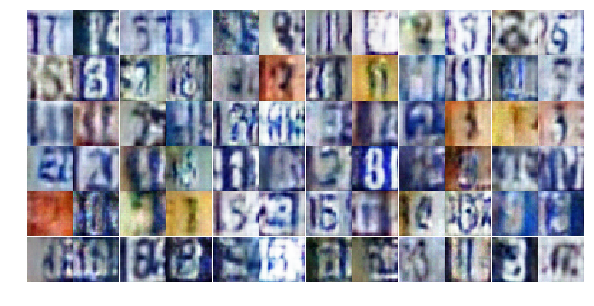

Epoch 10/25... Discriminator Loss: 0.5749... Generator Loss: 1.4031
Epoch 10/25... Discriminator Loss: 0.3908... Generator Loss: 1.7652
Epoch 10/25... Discriminator Loss: 0.3490... Generator Loss: 1.7906
Epoch 10/25... Discriminator Loss: 0.2955... Generator Loss: 1.9477
Epoch 10/25... Discriminator Loss: 0.7069... Generator Loss: 0.9429
Epoch 10/25... Discriminator Loss: 0.2416... Generator Loss: 2.4407
Epoch 10/25... Discriminator Loss: 0.2892... Generator Loss: 2.0316
Epoch 10/25... Discriminator Loss: 0.3867... Generator Loss: 1.4354
Epoch 10/25... Discriminator Loss: 0.2664... Generator Loss: 2.1959
Epoch 10/25... Discriminator Loss: 0.1398... Generator Loss: 3.3030


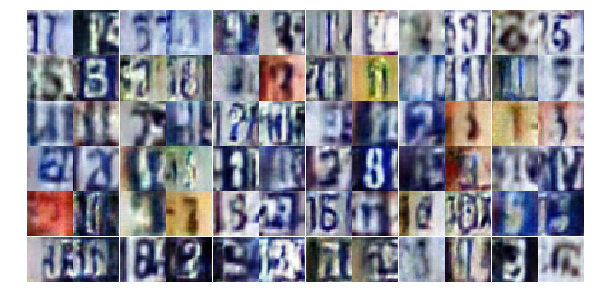

Epoch 10/25... Discriminator Loss: 0.2917... Generator Loss: 3.2310
Epoch 10/25... Discriminator Loss: 0.1804... Generator Loss: 2.6583
Epoch 10/25... Discriminator Loss: 0.3015... Generator Loss: 1.7134
Epoch 10/25... Discriminator Loss: 0.0720... Generator Loss: 3.5505
Epoch 10/25... Discriminator Loss: 1.0046... Generator Loss: 0.6955
Epoch 10/25... Discriminator Loss: 1.0641... Generator Loss: 0.5851
Epoch 10/25... Discriminator Loss: 0.3799... Generator Loss: 4.8247
Epoch 10/25... Discriminator Loss: 0.3183... Generator Loss: 1.7867
Epoch 10/25... Discriminator Loss: 0.2876... Generator Loss: 1.7359
Epoch 10/25... Discriminator Loss: 0.8106... Generator Loss: 0.8706


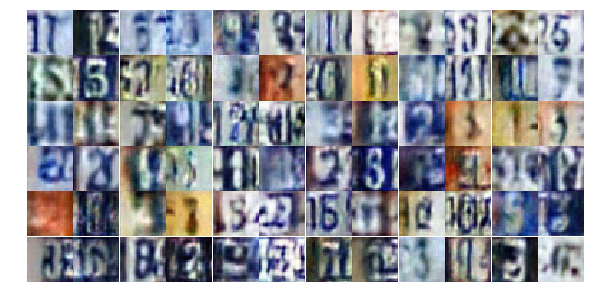

Epoch 10/25... Discriminator Loss: 0.3145... Generator Loss: 1.8263
Epoch 10/25... Discriminator Loss: 0.1666... Generator Loss: 2.9651
Epoch 10/25... Discriminator Loss: 0.0940... Generator Loss: 4.1803
Epoch 10/25... Discriminator Loss: 0.6421... Generator Loss: 1.1295
Epoch 10/25... Discriminator Loss: 0.5879... Generator Loss: 1.1743
Epoch 10/25... Discriminator Loss: 0.4732... Generator Loss: 1.2912
Epoch 10/25... Discriminator Loss: 0.3305... Generator Loss: 2.1833
Epoch 10/25... Discriminator Loss: 0.5975... Generator Loss: 1.1057
Epoch 10/25... Discriminator Loss: 0.5108... Generator Loss: 3.7077
Epoch 10/25... Discriminator Loss: 0.3338... Generator Loss: 1.8687


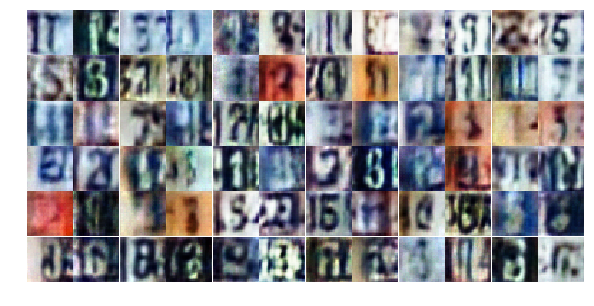

Epoch 10/25... Discriminator Loss: 0.2259... Generator Loss: 2.4599
Epoch 10/25... Discriminator Loss: 0.3102... Generator Loss: 1.9926
Epoch 10/25... Discriminator Loss: 0.1251... Generator Loss: 3.2096
Epoch 10/25... Discriminator Loss: 0.1995... Generator Loss: 2.3636
Epoch 10/25... Discriminator Loss: 0.2286... Generator Loss: 2.8344
Epoch 10/25... Discriminator Loss: 0.1485... Generator Loss: 2.7376
Epoch 10/25... Discriminator Loss: 0.1497... Generator Loss: 3.5616
Epoch 10/25... Discriminator Loss: 0.3539... Generator Loss: 1.5866
Epoch 10/25... Discriminator Loss: 0.6170... Generator Loss: 0.9943
Epoch 10/25... Discriminator Loss: 0.2868... Generator Loss: 2.3129


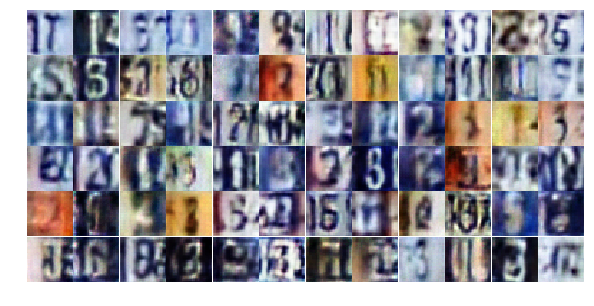

Epoch 10/25... Discriminator Loss: 0.6182... Generator Loss: 1.0644
Epoch 10/25... Discriminator Loss: 1.3416... Generator Loss: 0.5096
Epoch 10/25... Discriminator Loss: 0.2590... Generator Loss: 1.9014
Epoch 11/25... Discriminator Loss: 0.4156... Generator Loss: 1.5548
Epoch 11/25... Discriminator Loss: 0.1565... Generator Loss: 2.7231
Epoch 11/25... Discriminator Loss: 0.7199... Generator Loss: 1.2879
Epoch 11/25... Discriminator Loss: 0.4784... Generator Loss: 1.3022
Epoch 11/25... Discriminator Loss: 0.5097... Generator Loss: 1.3549
Epoch 11/25... Discriminator Loss: 1.9424... Generator Loss: 0.2668
Epoch 11/25... Discriminator Loss: 2.1001... Generator Loss: 0.3813


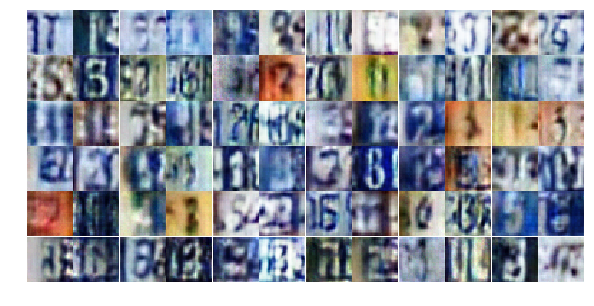

Epoch 11/25... Discriminator Loss: 1.4032... Generator Loss: 1.1706
Epoch 11/25... Discriminator Loss: 1.3159... Generator Loss: 2.0656
Epoch 11/25... Discriminator Loss: 0.6321... Generator Loss: 1.2327
Epoch 11/25... Discriminator Loss: 0.8568... Generator Loss: 0.8134
Epoch 11/25... Discriminator Loss: 0.7231... Generator Loss: 1.0658
Epoch 11/25... Discriminator Loss: 0.4895... Generator Loss: 1.5225
Epoch 11/25... Discriminator Loss: 0.5186... Generator Loss: 1.4026
Epoch 11/25... Discriminator Loss: 0.3567... Generator Loss: 2.3082
Epoch 11/25... Discriminator Loss: 0.5945... Generator Loss: 1.1779
Epoch 11/25... Discriminator Loss: 1.2865... Generator Loss: 0.4183


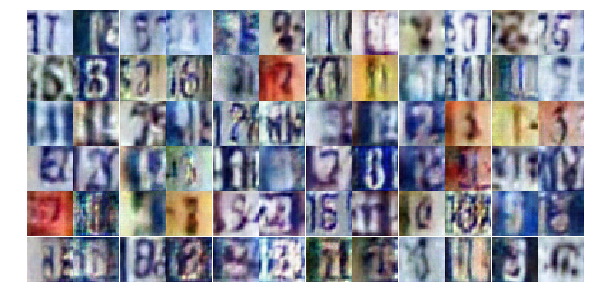

Epoch 11/25... Discriminator Loss: 0.8240... Generator Loss: 0.7997
Epoch 11/25... Discriminator Loss: 0.3327... Generator Loss: 2.0325
Epoch 11/25... Discriminator Loss: 0.6240... Generator Loss: 1.0399
Epoch 11/25... Discriminator Loss: 0.4490... Generator Loss: 1.5548
Epoch 11/25... Discriminator Loss: 0.2789... Generator Loss: 2.0527
Epoch 11/25... Discriminator Loss: 0.3213... Generator Loss: 2.1002
Epoch 11/25... Discriminator Loss: 0.4770... Generator Loss: 1.5842
Epoch 11/25... Discriminator Loss: 0.9262... Generator Loss: 0.7092
Epoch 11/25... Discriminator Loss: 0.3035... Generator Loss: 1.9916
Epoch 11/25... Discriminator Loss: 0.4754... Generator Loss: 1.3566


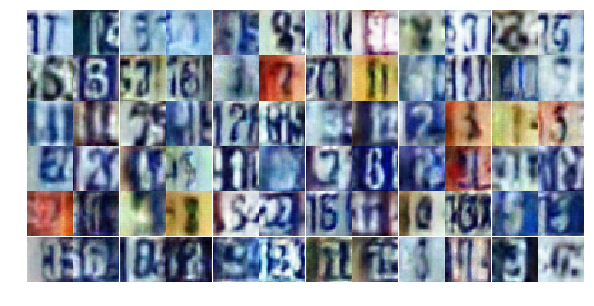

Epoch 11/25... Discriminator Loss: 0.4971... Generator Loss: 1.7797
Epoch 11/25... Discriminator Loss: 0.3786... Generator Loss: 1.5798
Epoch 11/25... Discriminator Loss: 0.7306... Generator Loss: 0.9282
Epoch 11/25... Discriminator Loss: 0.3193... Generator Loss: 2.2222
Epoch 11/25... Discriminator Loss: 0.4728... Generator Loss: 1.3850
Epoch 11/25... Discriminator Loss: 0.8283... Generator Loss: 0.8717
Epoch 11/25... Discriminator Loss: 0.7011... Generator Loss: 1.0487
Epoch 11/25... Discriminator Loss: 0.8684... Generator Loss: 0.7155
Epoch 11/25... Discriminator Loss: 0.5349... Generator Loss: 1.3116
Epoch 11/25... Discriminator Loss: 0.4707... Generator Loss: 1.5005


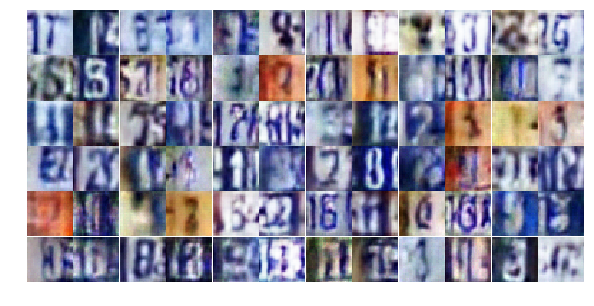

Epoch 11/25... Discriminator Loss: 0.3200... Generator Loss: 1.7624
Epoch 11/25... Discriminator Loss: 0.4658... Generator Loss: 1.3755
Epoch 11/25... Discriminator Loss: 0.2493... Generator Loss: 2.3237
Epoch 11/25... Discriminator Loss: 0.3628... Generator Loss: 1.8404
Epoch 11/25... Discriminator Loss: 0.4537... Generator Loss: 1.4017
Epoch 11/25... Discriminator Loss: 0.3909... Generator Loss: 1.4698
Epoch 11/25... Discriminator Loss: 0.2354... Generator Loss: 3.1888
Epoch 11/25... Discriminator Loss: 0.4620... Generator Loss: 1.4270
Epoch 11/25... Discriminator Loss: 0.5994... Generator Loss: 1.1593
Epoch 11/25... Discriminator Loss: 0.5325... Generator Loss: 1.1848


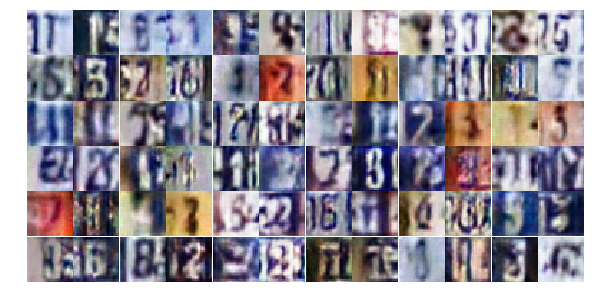

Epoch 11/25... Discriminator Loss: 0.9479... Generator Loss: 0.7082
Epoch 11/25... Discriminator Loss: 0.4165... Generator Loss: 1.7010
Epoch 11/25... Discriminator Loss: 1.8941... Generator Loss: 0.2434
Epoch 11/25... Discriminator Loss: 0.6559... Generator Loss: 0.9472
Epoch 11/25... Discriminator Loss: 0.6217... Generator Loss: 1.1636
Epoch 11/25... Discriminator Loss: 0.4351... Generator Loss: 1.5243
Epoch 11/25... Discriminator Loss: 0.6053... Generator Loss: 1.0736
Epoch 11/25... Discriminator Loss: 0.2907... Generator Loss: 2.2309
Epoch 11/25... Discriminator Loss: 0.3310... Generator Loss: 1.6618
Epoch 11/25... Discriminator Loss: 0.3905... Generator Loss: 1.8503


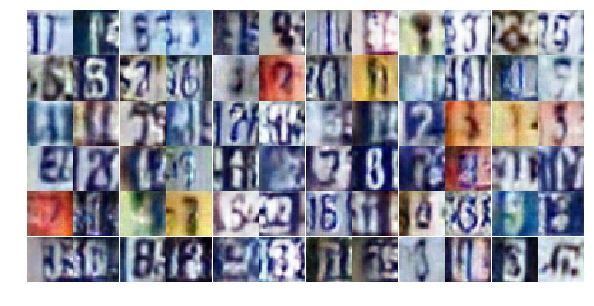

Epoch 12/25... Discriminator Loss: 0.4541... Generator Loss: 1.4413
Epoch 12/25... Discriminator Loss: 0.3953... Generator Loss: 1.4848
Epoch 12/25... Discriminator Loss: 0.9514... Generator Loss: 0.7180
Epoch 12/25... Discriminator Loss: 0.1526... Generator Loss: 2.7174
Epoch 12/25... Discriminator Loss: 0.8851... Generator Loss: 0.6692
Epoch 12/25... Discriminator Loss: 1.2211... Generator Loss: 0.4987
Epoch 12/25... Discriminator Loss: 0.1763... Generator Loss: 2.9538
Epoch 12/25... Discriminator Loss: 0.1428... Generator Loss: 3.4920
Epoch 12/25... Discriminator Loss: 0.4911... Generator Loss: 1.3218
Epoch 12/25... Discriminator Loss: 0.6404... Generator Loss: 0.9938


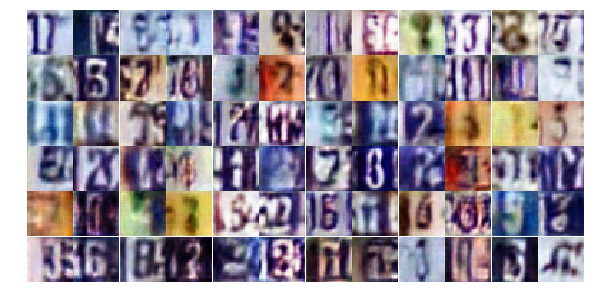

Epoch 12/25... Discriminator Loss: 0.1536... Generator Loss: 2.8656
Epoch 12/25... Discriminator Loss: 0.2158... Generator Loss: 2.2330
Epoch 12/25... Discriminator Loss: 0.4081... Generator Loss: 1.4332
Epoch 12/25... Discriminator Loss: 0.9192... Generator Loss: 0.7318
Epoch 12/25... Discriminator Loss: 0.3067... Generator Loss: 2.2221
Epoch 12/25... Discriminator Loss: 0.2849... Generator Loss: 2.1810
Epoch 12/25... Discriminator Loss: 1.6774... Generator Loss: 0.3009
Epoch 12/25... Discriminator Loss: 0.2486... Generator Loss: 1.8515
Epoch 12/25... Discriminator Loss: 0.4641... Generator Loss: 1.3740
Epoch 12/25... Discriminator Loss: 0.5659... Generator Loss: 1.1696


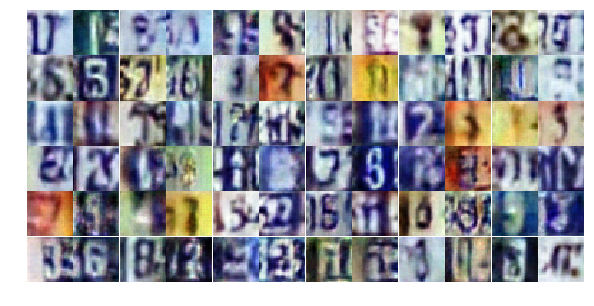

Epoch 12/25... Discriminator Loss: 0.0686... Generator Loss: 3.3542
Epoch 12/25... Discriminator Loss: 0.1412... Generator Loss: 2.6738
Epoch 12/25... Discriminator Loss: 0.2839... Generator Loss: 1.8702
Epoch 12/25... Discriminator Loss: 0.2236... Generator Loss: 2.1807
Epoch 12/25... Discriminator Loss: 0.1023... Generator Loss: 3.1249
Epoch 12/25... Discriminator Loss: 0.1634... Generator Loss: 2.4571
Epoch 12/25... Discriminator Loss: 0.2140... Generator Loss: 2.1186
Epoch 12/25... Discriminator Loss: 0.1078... Generator Loss: 3.1294
Epoch 12/25... Discriminator Loss: 0.1612... Generator Loss: 3.1660
Epoch 12/25... Discriminator Loss: 0.2356... Generator Loss: 2.3122


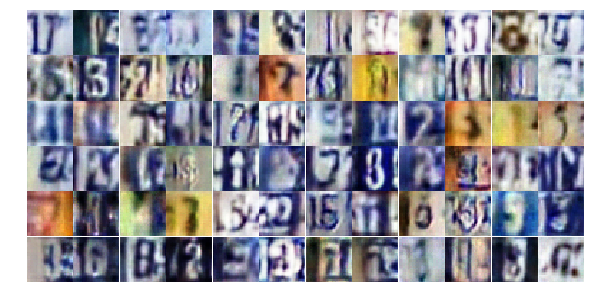

Epoch 12/25... Discriminator Loss: 0.2307... Generator Loss: 2.1401
Epoch 12/25... Discriminator Loss: 0.7926... Generator Loss: 0.8897
Epoch 12/25... Discriminator Loss: 0.2406... Generator Loss: 2.0725
Epoch 12/25... Discriminator Loss: 0.3274... Generator Loss: 2.4331
Epoch 12/25... Discriminator Loss: 0.8546... Generator Loss: 6.3586
Epoch 12/25... Discriminator Loss: 0.3946... Generator Loss: 1.8377
Epoch 12/25... Discriminator Loss: 1.0372... Generator Loss: 0.6121
Epoch 12/25... Discriminator Loss: 2.7622... Generator Loss: 3.9977
Epoch 12/25... Discriminator Loss: 0.8088... Generator Loss: 1.1800
Epoch 12/25... Discriminator Loss: 0.2808... Generator Loss: 2.7802


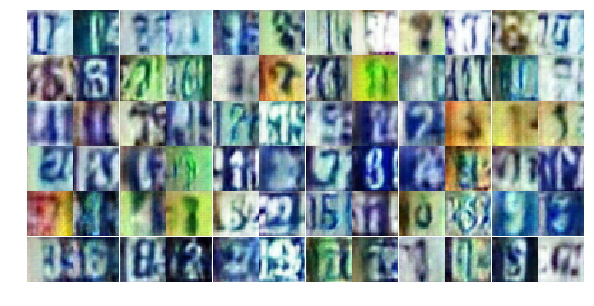

Epoch 12/25... Discriminator Loss: 1.1635... Generator Loss: 4.6862
Epoch 12/25... Discriminator Loss: 0.3874... Generator Loss: 1.9054
Epoch 12/25... Discriminator Loss: 0.4186... Generator Loss: 1.5952
Epoch 12/25... Discriminator Loss: 0.2367... Generator Loss: 2.2738
Epoch 12/25... Discriminator Loss: 0.4701... Generator Loss: 1.3967
Epoch 12/25... Discriminator Loss: 0.4619... Generator Loss: 1.4656
Epoch 12/25... Discriminator Loss: 0.2515... Generator Loss: 1.9001
Epoch 12/25... Discriminator Loss: 0.3063... Generator Loss: 2.0933
Epoch 12/25... Discriminator Loss: 0.2569... Generator Loss: 2.4603
Epoch 12/25... Discriminator Loss: 0.2394... Generator Loss: 2.0546


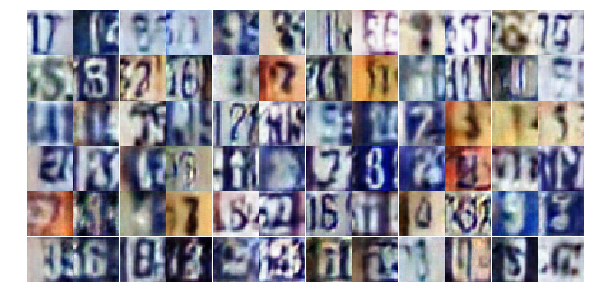

Epoch 12/25... Discriminator Loss: 0.1355... Generator Loss: 3.2176
Epoch 12/25... Discriminator Loss: 0.1589... Generator Loss: 3.8606
Epoch 12/25... Discriminator Loss: 0.3204... Generator Loss: 1.6833
Epoch 12/25... Discriminator Loss: 0.5341... Generator Loss: 1.1834
Epoch 12/25... Discriminator Loss: 0.1687... Generator Loss: 2.3799
Epoch 12/25... Discriminator Loss: 4.9369... Generator Loss: 6.1653
Epoch 12/25... Discriminator Loss: 1.2800... Generator Loss: 1.0164
Epoch 13/25... Discriminator Loss: 1.0371... Generator Loss: 1.6754
Epoch 13/25... Discriminator Loss: 0.5198... Generator Loss: 1.4897
Epoch 13/25... Discriminator Loss: 0.8823... Generator Loss: 0.8142


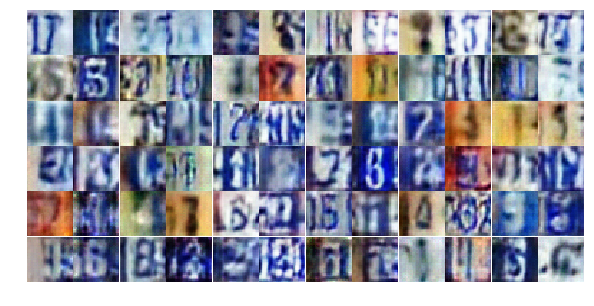

Epoch 13/25... Discriminator Loss: 0.4238... Generator Loss: 1.4384
Epoch 13/25... Discriminator Loss: 0.5209... Generator Loss: 4.4699
Epoch 13/25... Discriminator Loss: 0.5727... Generator Loss: 1.5013
Epoch 13/25... Discriminator Loss: 0.5682... Generator Loss: 1.1268
Epoch 13/25... Discriminator Loss: 0.3678... Generator Loss: 1.6199
Epoch 13/25... Discriminator Loss: 0.3865... Generator Loss: 1.4566
Epoch 13/25... Discriminator Loss: 0.2334... Generator Loss: 2.5688
Epoch 13/25... Discriminator Loss: 0.3593... Generator Loss: 1.5555
Epoch 13/25... Discriminator Loss: 0.2197... Generator Loss: 2.1240
Epoch 13/25... Discriminator Loss: 0.2196... Generator Loss: 2.8632


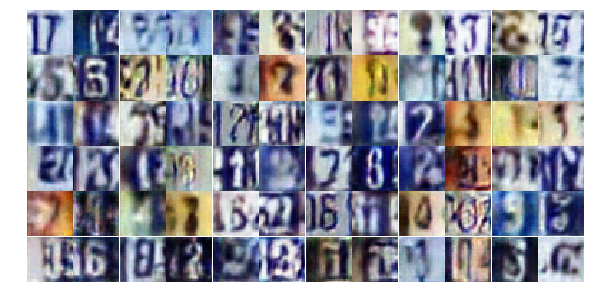

Epoch 13/25... Discriminator Loss: 0.9507... Generator Loss: 2.5595
Epoch 13/25... Discriminator Loss: 1.0512... Generator Loss: 0.8540
Epoch 13/25... Discriminator Loss: 0.1845... Generator Loss: 2.3421
Epoch 13/25... Discriminator Loss: 0.5290... Generator Loss: 1.3264
Epoch 13/25... Discriminator Loss: 0.3626... Generator Loss: 1.7589
Epoch 13/25... Discriminator Loss: 0.3867... Generator Loss: 2.2124
Epoch 13/25... Discriminator Loss: 0.4176... Generator Loss: 1.4811
Epoch 13/25... Discriminator Loss: 0.3859... Generator Loss: 1.5040
Epoch 13/25... Discriminator Loss: 0.2513... Generator Loss: 2.3304
Epoch 13/25... Discriminator Loss: 0.2438... Generator Loss: 2.5013


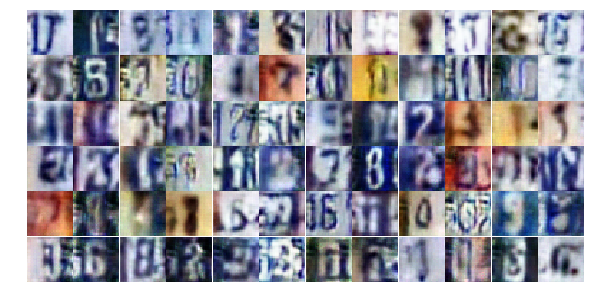

Epoch 13/25... Discriminator Loss: 0.4222... Generator Loss: 1.5134
Epoch 13/25... Discriminator Loss: 0.3691... Generator Loss: 1.4910
Epoch 13/25... Discriminator Loss: 0.6286... Generator Loss: 1.0363
Epoch 13/25... Discriminator Loss: 0.3936... Generator Loss: 1.4644
Epoch 13/25... Discriminator Loss: 0.5707... Generator Loss: 1.0463
Epoch 13/25... Discriminator Loss: 0.2471... Generator Loss: 1.9808
Epoch 13/25... Discriminator Loss: 0.1368... Generator Loss: 3.0880
Epoch 13/25... Discriminator Loss: 0.1656... Generator Loss: 2.9910
Epoch 13/25... Discriminator Loss: 0.2103... Generator Loss: 2.3680
Epoch 13/25... Discriminator Loss: 0.3128... Generator Loss: 1.8817


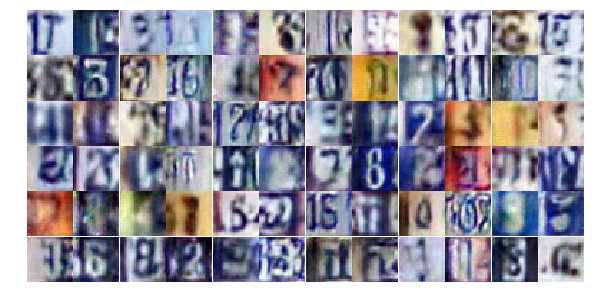

Epoch 13/25... Discriminator Loss: 0.9933... Generator Loss: 0.5926
Epoch 13/25... Discriminator Loss: 0.1019... Generator Loss: 5.9049
Epoch 13/25... Discriminator Loss: 0.4961... Generator Loss: 1.2579
Epoch 13/25... Discriminator Loss: 0.5052... Generator Loss: 1.3615
Epoch 13/25... Discriminator Loss: 5.0057... Generator Loss: 9.1712
Epoch 13/25... Discriminator Loss: 0.9443... Generator Loss: 1.4789
Epoch 13/25... Discriminator Loss: 0.6166... Generator Loss: 1.3729
Epoch 13/25... Discriminator Loss: 0.6645... Generator Loss: 1.5577
Epoch 13/25... Discriminator Loss: 0.3762... Generator Loss: 1.6947
Epoch 13/25... Discriminator Loss: 0.2928... Generator Loss: 2.0324


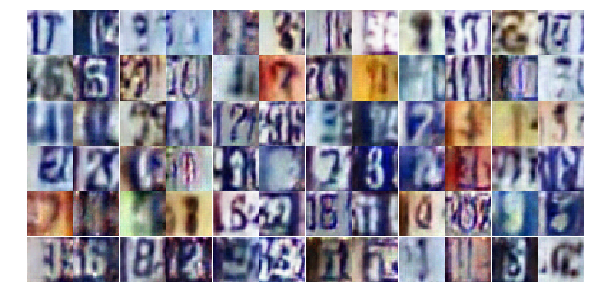

Epoch 13/25... Discriminator Loss: 0.7219... Generator Loss: 0.9757
Epoch 13/25... Discriminator Loss: 0.4007... Generator Loss: 1.6775
Epoch 13/25... Discriminator Loss: 0.9385... Generator Loss: 0.9642
Epoch 13/25... Discriminator Loss: 0.2950... Generator Loss: 1.9196
Epoch 13/25... Discriminator Loss: 0.9608... Generator Loss: 0.6180
Epoch 13/25... Discriminator Loss: 0.4659... Generator Loss: 1.4297
Epoch 13/25... Discriminator Loss: 0.4529... Generator Loss: 1.6426
Epoch 13/25... Discriminator Loss: 0.2796... Generator Loss: 1.9312
Epoch 13/25... Discriminator Loss: 0.3931... Generator Loss: 1.5904
Epoch 13/25... Discriminator Loss: 1.0129... Generator Loss: 0.6631


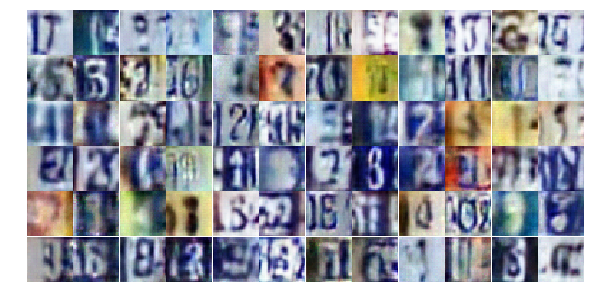

Epoch 13/25... Discriminator Loss: 0.4309... Generator Loss: 1.5207
Epoch 13/25... Discriminator Loss: 0.5307... Generator Loss: 1.4416
Epoch 13/25... Discriminator Loss: 0.3912... Generator Loss: 1.7007
Epoch 13/25... Discriminator Loss: 1.2212... Generator Loss: 0.5358
Epoch 14/25... Discriminator Loss: 0.3889... Generator Loss: 1.9274
Epoch 14/25... Discriminator Loss: 0.4380... Generator Loss: 1.8171
Epoch 14/25... Discriminator Loss: 0.6627... Generator Loss: 0.9642
Epoch 14/25... Discriminator Loss: 0.3871... Generator Loss: 3.5600
Epoch 14/25... Discriminator Loss: 0.1482... Generator Loss: 3.5154
Epoch 14/25... Discriminator Loss: 0.4099... Generator Loss: 1.7033


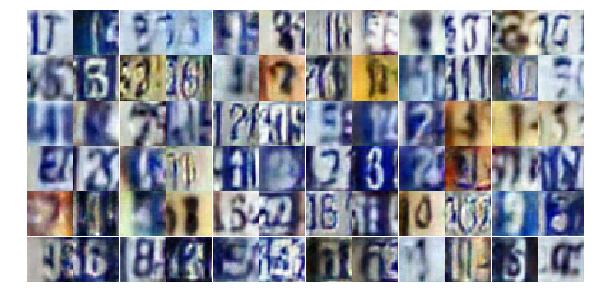

Epoch 14/25... Discriminator Loss: 0.2701... Generator Loss: 2.8072
Epoch 14/25... Discriminator Loss: 0.1633... Generator Loss: 2.7343
Epoch 14/25... Discriminator Loss: 0.2541... Generator Loss: 2.0469
Epoch 14/25... Discriminator Loss: 0.3682... Generator Loss: 3.7577
Epoch 14/25... Discriminator Loss: 0.2439... Generator Loss: 2.0750
Epoch 14/25... Discriminator Loss: 0.2962... Generator Loss: 1.7070
Epoch 14/25... Discriminator Loss: 0.1048... Generator Loss: 3.2757
Epoch 14/25... Discriminator Loss: 1.2569... Generator Loss: 0.4599
Epoch 14/25... Discriminator Loss: 1.8463... Generator Loss: 0.2600
Epoch 14/25... Discriminator Loss: 2.9840... Generator Loss: 0.0760


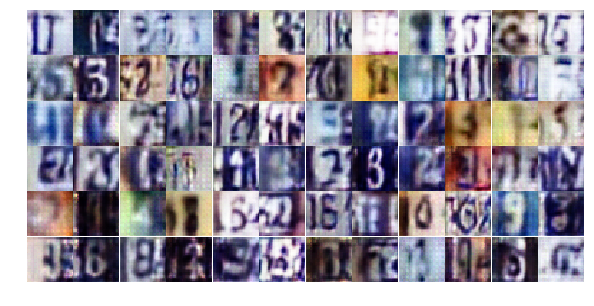

Epoch 14/25... Discriminator Loss: 0.4016... Generator Loss: 1.7146
Epoch 14/25... Discriminator Loss: 1.2671... Generator Loss: 4.7321
Epoch 14/25... Discriminator Loss: 1.0577... Generator Loss: 0.6292
Epoch 14/25... Discriminator Loss: 0.2749... Generator Loss: 2.2622
Epoch 14/25... Discriminator Loss: 0.6267... Generator Loss: 0.9985
Epoch 14/25... Discriminator Loss: 0.3681... Generator Loss: 1.6981
Epoch 14/25... Discriminator Loss: 0.2775... Generator Loss: 1.9903
Epoch 14/25... Discriminator Loss: 0.1988... Generator Loss: 2.7645
Epoch 14/25... Discriminator Loss: 0.3367... Generator Loss: 1.7010
Epoch 14/25... Discriminator Loss: 0.6806... Generator Loss: 0.9044


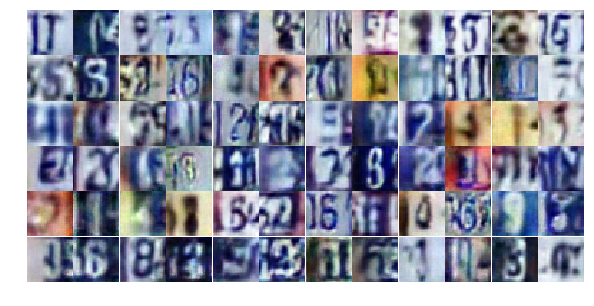

Epoch 14/25... Discriminator Loss: 0.3263... Generator Loss: 1.8574
Epoch 14/25... Discriminator Loss: 0.3600... Generator Loss: 1.5811
Epoch 14/25... Discriminator Loss: 0.1719... Generator Loss: 2.7303
Epoch 14/25... Discriminator Loss: 0.3381... Generator Loss: 1.5626
Epoch 14/25... Discriminator Loss: 0.4900... Generator Loss: 1.2309
Epoch 14/25... Discriminator Loss: 0.3169... Generator Loss: 1.7101
Epoch 14/25... Discriminator Loss: 0.7263... Generator Loss: 0.9127
Epoch 14/25... Discriminator Loss: 0.2104... Generator Loss: 4.0686
Epoch 14/25... Discriminator Loss: 0.3726... Generator Loss: 1.8465
Epoch 14/25... Discriminator Loss: 0.3549... Generator Loss: 1.6121


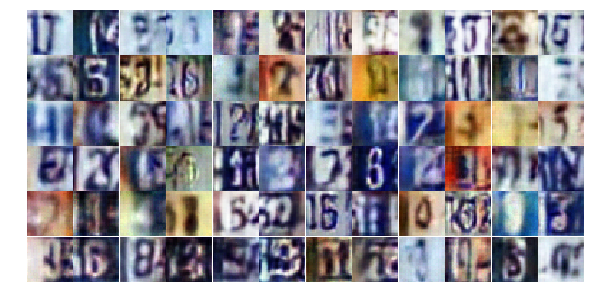

Epoch 14/25... Discriminator Loss: 1.2091... Generator Loss: 0.5247
Epoch 14/25... Discriminator Loss: 0.6933... Generator Loss: 0.9563
Epoch 14/25... Discriminator Loss: 0.2962... Generator Loss: 1.8706
Epoch 14/25... Discriminator Loss: 0.4219... Generator Loss: 1.4541
Epoch 14/25... Discriminator Loss: 0.2526... Generator Loss: 2.0908
Epoch 14/25... Discriminator Loss: 0.1075... Generator Loss: 2.8760
Epoch 14/25... Discriminator Loss: 0.5251... Generator Loss: 1.1614
Epoch 14/25... Discriminator Loss: 0.1027... Generator Loss: 3.2178
Epoch 14/25... Discriminator Loss: 0.8420... Generator Loss: 0.7810
Epoch 14/25... Discriminator Loss: 0.7477... Generator Loss: 0.9672


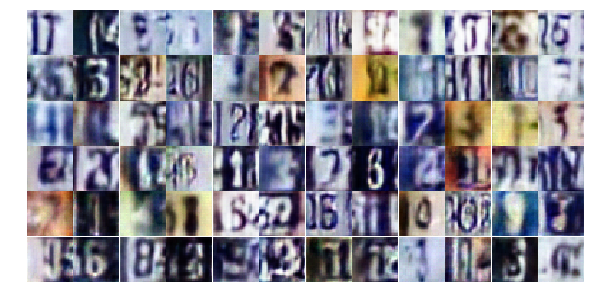

Epoch 14/25... Discriminator Loss: 1.9497... Generator Loss: 0.3269
Epoch 14/25... Discriminator Loss: 0.1900... Generator Loss: 2.5304
Epoch 14/25... Discriminator Loss: 0.8103... Generator Loss: 0.8526
Epoch 14/25... Discriminator Loss: 0.5563... Generator Loss: 1.2030
Epoch 14/25... Discriminator Loss: 0.5391... Generator Loss: 1.1062
Epoch 14/25... Discriminator Loss: 0.3114... Generator Loss: 1.8022
Epoch 14/25... Discriminator Loss: 0.3594... Generator Loss: 1.5605
Epoch 14/25... Discriminator Loss: 0.4392... Generator Loss: 1.3928
Epoch 14/25... Discriminator Loss: 0.3481... Generator Loss: 1.7757
Epoch 14/25... Discriminator Loss: 0.1613... Generator Loss: 2.8064


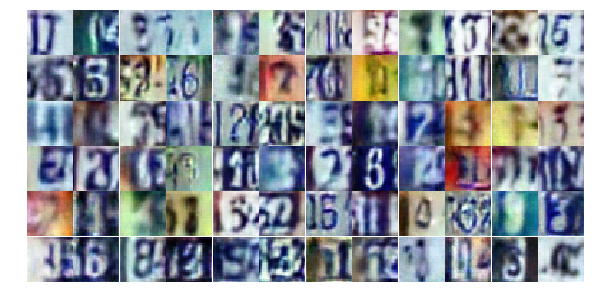

Epoch 14/25... Discriminator Loss: 0.4514... Generator Loss: 2.1019
Epoch 14/25... Discriminator Loss: 0.9138... Generator Loss: 0.7111
Epoch 15/25... Discriminator Loss: 0.2843... Generator Loss: 2.0082
Epoch 15/25... Discriminator Loss: 0.1531... Generator Loss: 2.6714
Epoch 15/25... Discriminator Loss: 0.3943... Generator Loss: 1.5293
Epoch 15/25... Discriminator Loss: 0.2190... Generator Loss: 2.5905
Epoch 15/25... Discriminator Loss: 0.6630... Generator Loss: 1.0033
Epoch 15/25... Discriminator Loss: 0.6037... Generator Loss: 1.9258
Epoch 15/25... Discriminator Loss: 1.2920... Generator Loss: 1.3325
Epoch 15/25... Discriminator Loss: 0.6713... Generator Loss: 1.2444


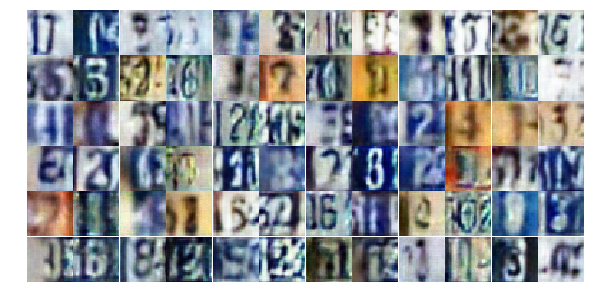

Epoch 15/25... Discriminator Loss: 0.4573... Generator Loss: 1.3793
Epoch 15/25... Discriminator Loss: 0.4801... Generator Loss: 1.4931
Epoch 15/25... Discriminator Loss: 0.2917... Generator Loss: 1.9735
Epoch 15/25... Discriminator Loss: 0.5945... Generator Loss: 1.1735
Epoch 15/25... Discriminator Loss: 0.3513... Generator Loss: 1.6383
Epoch 15/25... Discriminator Loss: 0.1363... Generator Loss: 3.8051
Epoch 15/25... Discriminator Loss: 2.1879... Generator Loss: 0.1721
Epoch 15/25... Discriminator Loss: 1.3869... Generator Loss: 3.6334
Epoch 15/25... Discriminator Loss: 0.2602... Generator Loss: 5.0984
Epoch 15/25... Discriminator Loss: 1.0080... Generator Loss: 0.6610


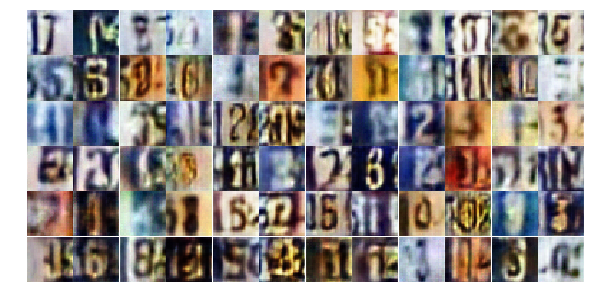

Epoch 15/25... Discriminator Loss: 0.8089... Generator Loss: 0.8411
Epoch 15/25... Discriminator Loss: 0.1250... Generator Loss: 3.0242
Epoch 15/25... Discriminator Loss: 0.3571... Generator Loss: 1.7323
Epoch 15/25... Discriminator Loss: 0.3715... Generator Loss: 1.8931
Epoch 15/25... Discriminator Loss: 0.3668... Generator Loss: 1.9223
Epoch 15/25... Discriminator Loss: 0.4230... Generator Loss: 1.5428
Epoch 15/25... Discriminator Loss: 0.3093... Generator Loss: 1.8860
Epoch 15/25... Discriminator Loss: 0.6594... Generator Loss: 1.0178
Epoch 15/25... Discriminator Loss: 0.1320... Generator Loss: 2.9700
Epoch 15/25... Discriminator Loss: 0.6861... Generator Loss: 0.9943


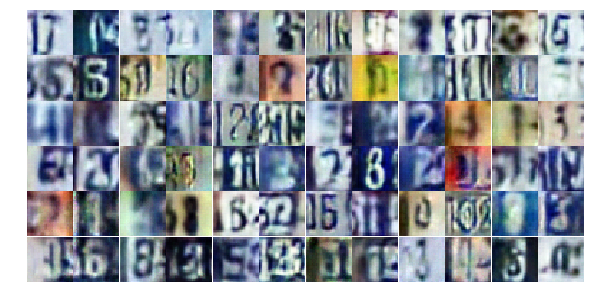

Epoch 15/25... Discriminator Loss: 0.3998... Generator Loss: 1.5584
Epoch 15/25... Discriminator Loss: 0.2524... Generator Loss: 2.1054
Epoch 15/25... Discriminator Loss: 0.3099... Generator Loss: 1.6089
Epoch 15/25... Discriminator Loss: 0.1597... Generator Loss: 3.0103
Epoch 15/25... Discriminator Loss: 0.1274... Generator Loss: 4.0435
Epoch 15/25... Discriminator Loss: 0.1546... Generator Loss: 4.4442
Epoch 15/25... Discriminator Loss: 0.2966... Generator Loss: 5.8007
Epoch 15/25... Discriminator Loss: 1.0041... Generator Loss: 0.7039
Epoch 15/25... Discriminator Loss: 0.8738... Generator Loss: 0.7424
Epoch 15/25... Discriminator Loss: 0.2899... Generator Loss: 1.9315


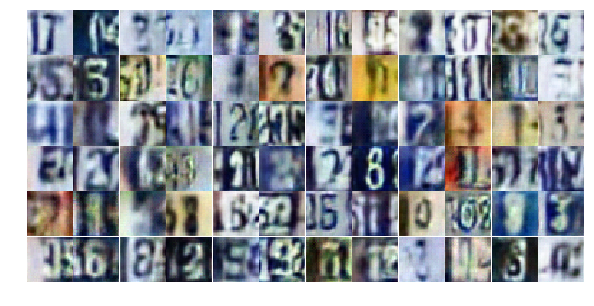

Epoch 15/25... Discriminator Loss: 0.2830... Generator Loss: 1.9162
Epoch 15/25... Discriminator Loss: 0.4060... Generator Loss: 1.5627
Epoch 15/25... Discriminator Loss: 0.3103... Generator Loss: 1.9816
Epoch 15/25... Discriminator Loss: 0.3865... Generator Loss: 1.5712
Epoch 15/25... Discriminator Loss: 0.0899... Generator Loss: 3.5472
Epoch 15/25... Discriminator Loss: 0.5945... Generator Loss: 1.0509
Epoch 15/25... Discriminator Loss: 0.1030... Generator Loss: 3.8305
Epoch 15/25... Discriminator Loss: 0.6178... Generator Loss: 6.6569
Epoch 15/25... Discriminator Loss: 0.2605... Generator Loss: 2.1901
Epoch 15/25... Discriminator Loss: 0.3314... Generator Loss: 1.7451


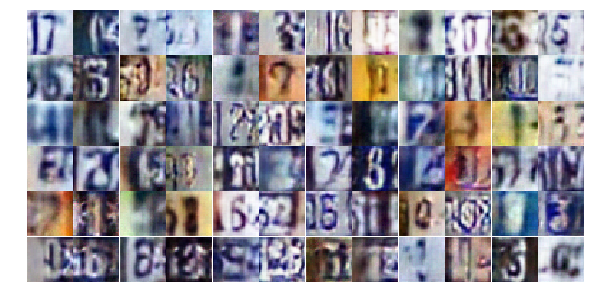

Epoch 15/25... Discriminator Loss: 0.3644... Generator Loss: 1.6901
Epoch 15/25... Discriminator Loss: 0.1969... Generator Loss: 2.3196
Epoch 15/25... Discriminator Loss: 0.1320... Generator Loss: 2.5808
Epoch 15/25... Discriminator Loss: 3.6470... Generator Loss: 6.6851
Epoch 15/25... Discriminator Loss: 1.2289... Generator Loss: 0.8667
Epoch 15/25... Discriminator Loss: 1.1664... Generator Loss: 1.2349
Epoch 15/25... Discriminator Loss: 0.9283... Generator Loss: 0.8176
Epoch 15/25... Discriminator Loss: 0.9665... Generator Loss: 1.0788
Epoch 15/25... Discriminator Loss: 1.1421... Generator Loss: 0.6588
Epoch 16/25... Discriminator Loss: 0.7423... Generator Loss: 0.8723


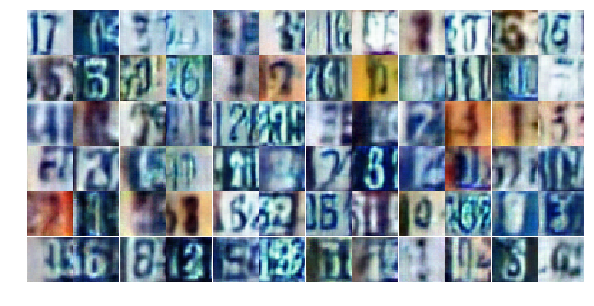

Epoch 16/25... Discriminator Loss: 0.2548... Generator Loss: 2.0879
Epoch 16/25... Discriminator Loss: 0.1647... Generator Loss: 3.3467
Epoch 16/25... Discriminator Loss: 0.8650... Generator Loss: 0.7224
Epoch 16/25... Discriminator Loss: 0.2107... Generator Loss: 3.0029
Epoch 16/25... Discriminator Loss: 0.2281... Generator Loss: 2.5960
Epoch 16/25... Discriminator Loss: 0.7124... Generator Loss: 3.2464
Epoch 16/25... Discriminator Loss: 1.5208... Generator Loss: 0.4028
Epoch 16/25... Discriminator Loss: 0.7958... Generator Loss: 0.8636
Epoch 16/25... Discriminator Loss: 0.3822... Generator Loss: 1.6071
Epoch 16/25... Discriminator Loss: 0.1537... Generator Loss: 3.6115


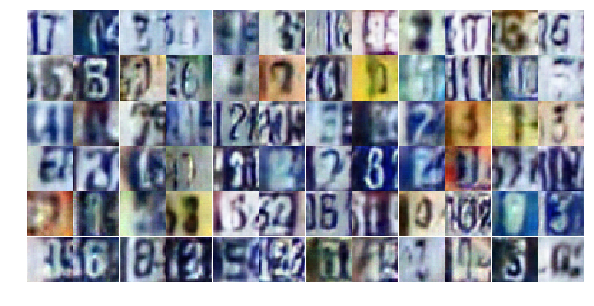

Epoch 16/25... Discriminator Loss: 0.3865... Generator Loss: 1.4681
Epoch 16/25... Discriminator Loss: 0.5510... Generator Loss: 1.1893
Epoch 16/25... Discriminator Loss: 0.2370... Generator Loss: 2.2403
Epoch 16/25... Discriminator Loss: 0.4632... Generator Loss: 1.8647
Epoch 16/25... Discriminator Loss: 0.0937... Generator Loss: 3.4448
Epoch 16/25... Discriminator Loss: 0.2517... Generator Loss: 1.9809
Epoch 16/25... Discriminator Loss: 0.8983... Generator Loss: 0.7975
Epoch 16/25... Discriminator Loss: 0.2754... Generator Loss: 1.9288
Epoch 16/25... Discriminator Loss: 0.3579... Generator Loss: 1.5906
Epoch 16/25... Discriminator Loss: 0.4881... Generator Loss: 1.2297


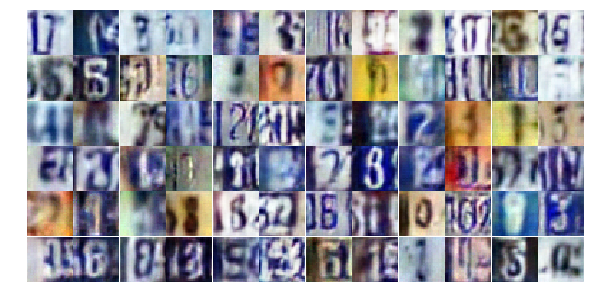

Epoch 16/25... Discriminator Loss: 0.3525... Generator Loss: 1.6739
Epoch 16/25... Discriminator Loss: 0.3429... Generator Loss: 1.6625
Epoch 16/25... Discriminator Loss: 0.3891... Generator Loss: 1.7670
Epoch 16/25... Discriminator Loss: 0.6348... Generator Loss: 0.9957
Epoch 16/25... Discriminator Loss: 0.2013... Generator Loss: 2.5091
Epoch 16/25... Discriminator Loss: 1.0683... Generator Loss: 0.6424
Epoch 16/25... Discriminator Loss: 0.3493... Generator Loss: 1.7411
Epoch 16/25... Discriminator Loss: 0.3407... Generator Loss: 1.6186
Epoch 16/25... Discriminator Loss: 0.3192... Generator Loss: 1.7802
Epoch 16/25... Discriminator Loss: 0.6794... Generator Loss: 0.9398


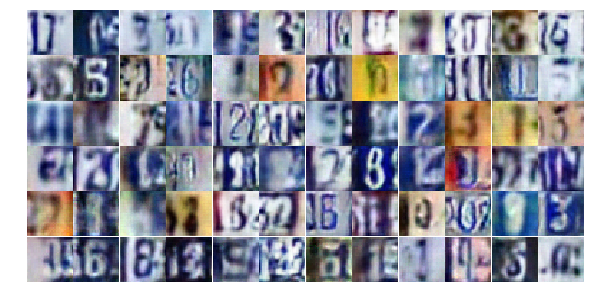

Epoch 16/25... Discriminator Loss: 0.2171... Generator Loss: 2.2153
Epoch 16/25... Discriminator Loss: 0.2154... Generator Loss: 2.2281
Epoch 16/25... Discriminator Loss: 0.4992... Generator Loss: 4.4022
Epoch 16/25... Discriminator Loss: 0.6543... Generator Loss: 3.5731
Epoch 16/25... Discriminator Loss: 0.4758... Generator Loss: 1.7281
Epoch 16/25... Discriminator Loss: 0.2686... Generator Loss: 3.1299
Epoch 16/25... Discriminator Loss: 0.4146... Generator Loss: 1.5176
Epoch 16/25... Discriminator Loss: 0.5663... Generator Loss: 1.1686
Epoch 16/25... Discriminator Loss: 0.3204... Generator Loss: 1.7532
Epoch 16/25... Discriminator Loss: 0.2375... Generator Loss: 2.7008


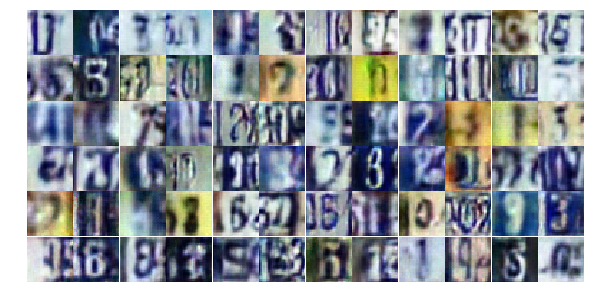

Epoch 16/25... Discriminator Loss: 0.1761... Generator Loss: 2.6648
Epoch 16/25... Discriminator Loss: 0.4734... Generator Loss: 1.3582
Epoch 16/25... Discriminator Loss: 0.6586... Generator Loss: 1.0180
Epoch 16/25... Discriminator Loss: 1.4408... Generator Loss: 5.0539
Epoch 16/25... Discriminator Loss: 1.4557... Generator Loss: 4.1023
Epoch 16/25... Discriminator Loss: 0.7973... Generator Loss: 1.3566
Epoch 16/25... Discriminator Loss: 0.2932... Generator Loss: 2.4467
Epoch 16/25... Discriminator Loss: 0.3561... Generator Loss: 1.6525
Epoch 16/25... Discriminator Loss: 0.3449... Generator Loss: 1.6724
Epoch 16/25... Discriminator Loss: 0.4894... Generator Loss: 1.2672


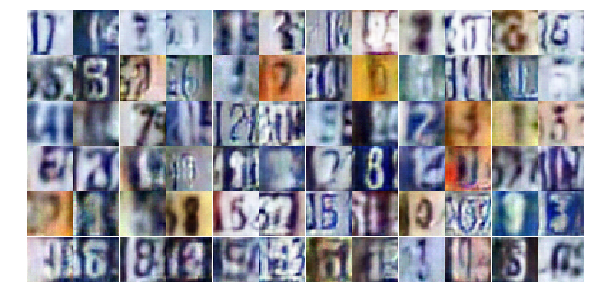

Epoch 16/25... Discriminator Loss: 1.9720... Generator Loss: 0.2275
Epoch 16/25... Discriminator Loss: 0.2219... Generator Loss: 3.4245
Epoch 16/25... Discriminator Loss: 1.5647... Generator Loss: 0.4436
Epoch 16/25... Discriminator Loss: 0.3537... Generator Loss: 1.5531
Epoch 16/25... Discriminator Loss: 0.3556... Generator Loss: 1.6666
Epoch 16/25... Discriminator Loss: 0.3351... Generator Loss: 1.7355
Epoch 17/25... Discriminator Loss: 0.6024... Generator Loss: 2.6141
Epoch 17/25... Discriminator Loss: 0.7156... Generator Loss: 0.9809
Epoch 17/25... Discriminator Loss: 0.4747... Generator Loss: 2.6103
Epoch 17/25... Discriminator Loss: 0.2910... Generator Loss: 2.1139


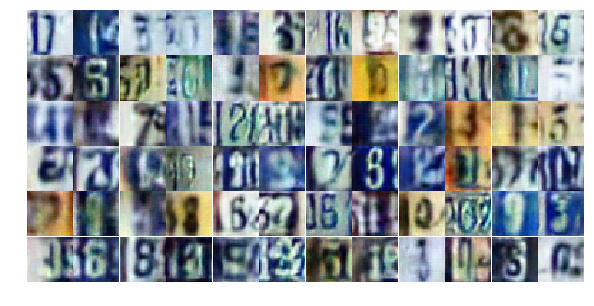

Epoch 17/25... Discriminator Loss: 0.3946... Generator Loss: 1.4957
Epoch 17/25... Discriminator Loss: 0.2077... Generator Loss: 2.2193
Epoch 17/25... Discriminator Loss: 0.5801... Generator Loss: 1.2325
Epoch 17/25... Discriminator Loss: 0.4711... Generator Loss: 1.3282
Epoch 17/25... Discriminator Loss: 0.9568... Generator Loss: 0.6663
Epoch 17/25... Discriminator Loss: 0.9513... Generator Loss: 0.7519
Epoch 17/25... Discriminator Loss: 0.7111... Generator Loss: 0.8805
Epoch 17/25... Discriminator Loss: 0.3348... Generator Loss: 1.6256
Epoch 17/25... Discriminator Loss: 0.1299... Generator Loss: 3.4195
Epoch 17/25... Discriminator Loss: 0.4598... Generator Loss: 1.3066


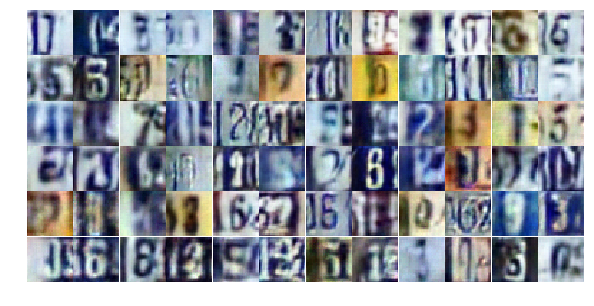

Epoch 17/25... Discriminator Loss: 0.2169... Generator Loss: 2.5059
Epoch 17/25... Discriminator Loss: 0.6133... Generator Loss: 1.0342
Epoch 17/25... Discriminator Loss: 0.2933... Generator Loss: 1.8030
Epoch 17/25... Discriminator Loss: 1.1896... Generator Loss: 0.5400
Epoch 17/25... Discriminator Loss: 0.4384... Generator Loss: 1.3911
Epoch 17/25... Discriminator Loss: 0.2512... Generator Loss: 2.1170
Epoch 17/25... Discriminator Loss: 0.3697... Generator Loss: 1.7283
Epoch 17/25... Discriminator Loss: 0.3563... Generator Loss: 1.5783
Epoch 17/25... Discriminator Loss: 0.4935... Generator Loss: 1.3278
Epoch 17/25... Discriminator Loss: 0.1425... Generator Loss: 2.6746


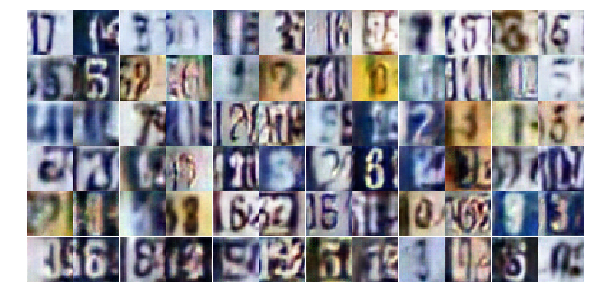

Epoch 17/25... Discriminator Loss: 0.7129... Generator Loss: 0.9702
Epoch 17/25... Discriminator Loss: 0.4496... Generator Loss: 1.3890
Epoch 17/25... Discriminator Loss: 1.2749... Generator Loss: 1.7247
Epoch 17/25... Discriminator Loss: 1.2096... Generator Loss: 0.7518
Epoch 17/25... Discriminator Loss: 1.0454... Generator Loss: 0.8315
Epoch 17/25... Discriminator Loss: 0.7480... Generator Loss: 0.9838
Epoch 17/25... Discriminator Loss: 0.7246... Generator Loss: 1.0537
Epoch 17/25... Discriminator Loss: 0.9144... Generator Loss: 0.7415
Epoch 17/25... Discriminator Loss: 0.7649... Generator Loss: 1.1870
Epoch 17/25... Discriminator Loss: 0.2385... Generator Loss: 2.3168


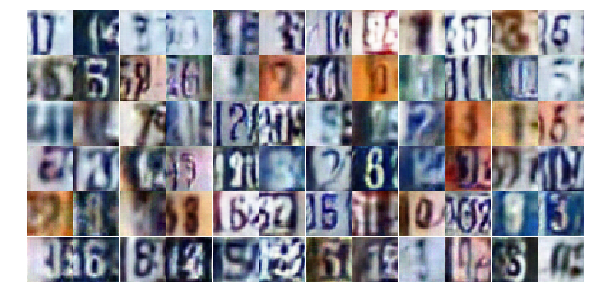

Epoch 17/25... Discriminator Loss: 0.4751... Generator Loss: 1.4042
Epoch 17/25... Discriminator Loss: 0.5085... Generator Loss: 1.3439
Epoch 17/25... Discriminator Loss: 0.2711... Generator Loss: 2.1243
Epoch 17/25... Discriminator Loss: 0.5971... Generator Loss: 1.7135
Epoch 17/25... Discriminator Loss: 0.8335... Generator Loss: 0.8020
Epoch 17/25... Discriminator Loss: 0.6200... Generator Loss: 1.0357
Epoch 17/25... Discriminator Loss: 0.3521... Generator Loss: 1.8533
Epoch 17/25... Discriminator Loss: 0.2713... Generator Loss: 1.9121
Epoch 17/25... Discriminator Loss: 0.1554... Generator Loss: 2.5508
Epoch 17/25... Discriminator Loss: 0.3588... Generator Loss: 1.5899


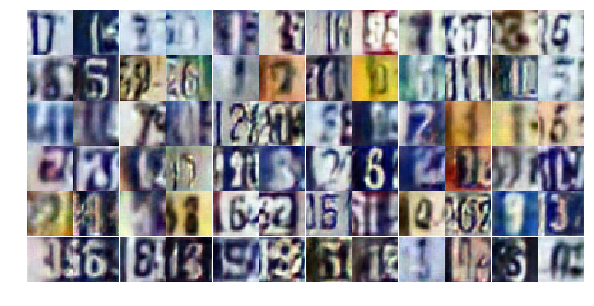

Epoch 17/25... Discriminator Loss: 2.2792... Generator Loss: 0.3510
Epoch 17/25... Discriminator Loss: 0.5606... Generator Loss: 1.5246
Epoch 17/25... Discriminator Loss: 0.5253... Generator Loss: 1.2772
Epoch 17/25... Discriminator Loss: 0.2522... Generator Loss: 2.1881
Epoch 17/25... Discriminator Loss: 0.3860... Generator Loss: 1.7062
Epoch 17/25... Discriminator Loss: 0.8511... Generator Loss: 0.7667
Epoch 17/25... Discriminator Loss: 0.4662... Generator Loss: 1.3541
Epoch 17/25... Discriminator Loss: 0.3388... Generator Loss: 1.7841
Epoch 17/25... Discriminator Loss: 0.4988... Generator Loss: 1.4711
Epoch 17/25... Discriminator Loss: 1.2297... Generator Loss: 0.5089


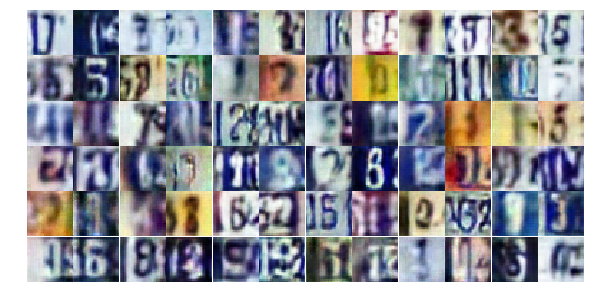

Epoch 17/25... Discriminator Loss: 0.5170... Generator Loss: 1.2822
Epoch 17/25... Discriminator Loss: 0.9731... Generator Loss: 0.6930
Epoch 17/25... Discriminator Loss: 0.1841... Generator Loss: 2.5732
Epoch 17/25... Discriminator Loss: 0.1433... Generator Loss: 3.1948
Epoch 18/25... Discriminator Loss: 0.7362... Generator Loss: 0.9170
Epoch 18/25... Discriminator Loss: 0.3425... Generator Loss: 1.7010
Epoch 18/25... Discriminator Loss: 0.3396... Generator Loss: 1.7018
Epoch 18/25... Discriminator Loss: 0.5798... Generator Loss: 1.1278
Epoch 18/25... Discriminator Loss: 0.5466... Generator Loss: 1.1757
Epoch 18/25... Discriminator Loss: 0.3171... Generator Loss: 1.8627


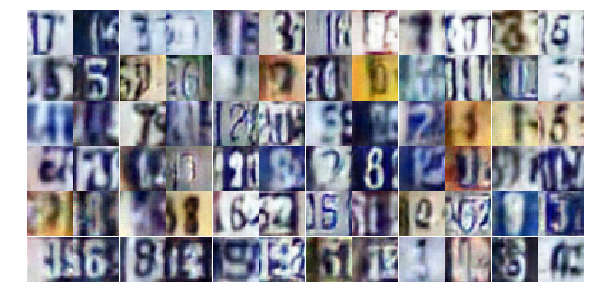

Epoch 18/25... Discriminator Loss: 0.5407... Generator Loss: 2.3657
Epoch 18/25... Discriminator Loss: 1.8683... Generator Loss: 0.3017
Epoch 18/25... Discriminator Loss: 0.4043... Generator Loss: 1.5618
Epoch 18/25... Discriminator Loss: 0.2906... Generator Loss: 2.3218
Epoch 18/25... Discriminator Loss: 0.5364... Generator Loss: 1.2739
Epoch 18/25... Discriminator Loss: 0.4916... Generator Loss: 1.4369
Epoch 18/25... Discriminator Loss: 0.4149... Generator Loss: 1.4918
Epoch 18/25... Discriminator Loss: 0.5226... Generator Loss: 1.2649
Epoch 18/25... Discriminator Loss: 0.2616... Generator Loss: 2.0613
Epoch 18/25... Discriminator Loss: 0.0957... Generator Loss: 3.5757


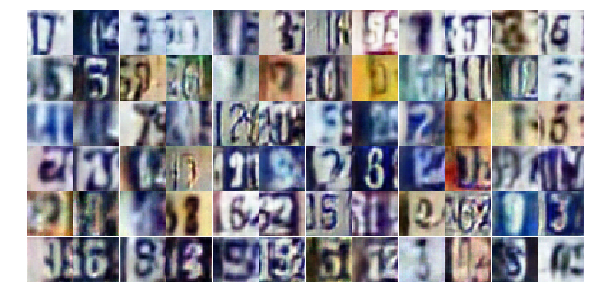

Epoch 18/25... Discriminator Loss: 0.3187... Generator Loss: 2.4278
Epoch 18/25... Discriminator Loss: 0.3417... Generator Loss: 1.7529
Epoch 18/25... Discriminator Loss: 0.6053... Generator Loss: 1.1030
Epoch 18/25... Discriminator Loss: 0.2863... Generator Loss: 1.9253
Epoch 18/25... Discriminator Loss: 0.4123... Generator Loss: 1.4561
Epoch 18/25... Discriminator Loss: 0.8174... Generator Loss: 0.7972
Epoch 18/25... Discriminator Loss: 0.2826... Generator Loss: 1.9888
Epoch 18/25... Discriminator Loss: 0.2732... Generator Loss: 1.9727
Epoch 18/25... Discriminator Loss: 0.2857... Generator Loss: 1.9131
Epoch 18/25... Discriminator Loss: 0.3113... Generator Loss: 2.0848


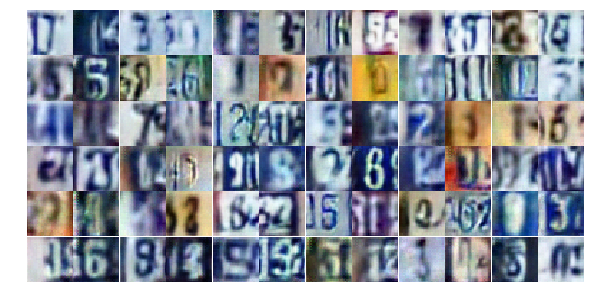

Epoch 18/25... Discriminator Loss: 0.1580... Generator Loss: 2.7481
Epoch 18/25... Discriminator Loss: 0.3471... Generator Loss: 1.5624
Epoch 18/25... Discriminator Loss: 0.2878... Generator Loss: 1.9847
Epoch 18/25... Discriminator Loss: 1.4780... Generator Loss: 0.4377
Epoch 18/25... Discriminator Loss: 0.6749... Generator Loss: 1.0314
Epoch 18/25... Discriminator Loss: 0.4074... Generator Loss: 1.4218
Epoch 18/25... Discriminator Loss: 0.2791... Generator Loss: 1.9725
Epoch 18/25... Discriminator Loss: 0.3501... Generator Loss: 1.7636
Epoch 18/25... Discriminator Loss: 0.1819... Generator Loss: 2.7445
Epoch 18/25... Discriminator Loss: 0.4993... Generator Loss: 1.2235


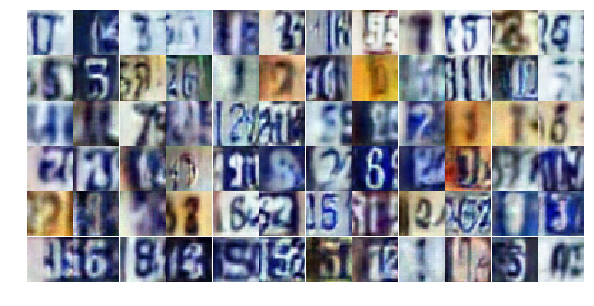

Epoch 18/25... Discriminator Loss: 0.6780... Generator Loss: 0.9378
Epoch 18/25... Discriminator Loss: 0.3268... Generator Loss: 1.6799
Epoch 18/25... Discriminator Loss: 0.1975... Generator Loss: 2.3582
Epoch 18/25... Discriminator Loss: 0.4913... Generator Loss: 1.2326
Epoch 18/25... Discriminator Loss: 0.3423... Generator Loss: 1.8683
Epoch 18/25... Discriminator Loss: 0.2450... Generator Loss: 1.9335
Epoch 18/25... Discriminator Loss: 0.4317... Generator Loss: 1.3807
Epoch 18/25... Discriminator Loss: 0.9303... Generator Loss: 4.5023
Epoch 18/25... Discriminator Loss: 3.1724... Generator Loss: 5.1802
Epoch 18/25... Discriminator Loss: 0.7963... Generator Loss: 3.1214


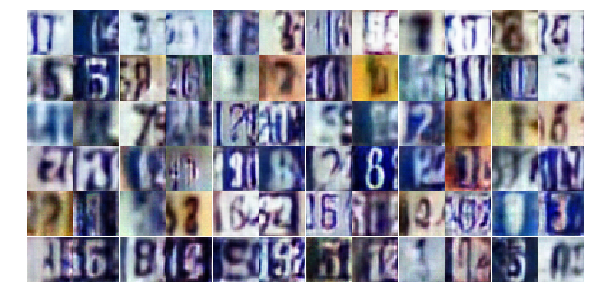

Epoch 18/25... Discriminator Loss: 0.4258... Generator Loss: 2.1508
Epoch 18/25... Discriminator Loss: 0.4808... Generator Loss: 1.3575
Epoch 18/25... Discriminator Loss: 1.0107... Generator Loss: 0.6842
Epoch 18/25... Discriminator Loss: 0.5059... Generator Loss: 1.3172
Epoch 18/25... Discriminator Loss: 0.2809... Generator Loss: 1.9814
Epoch 18/25... Discriminator Loss: 0.5465... Generator Loss: 2.5670
Epoch 18/25... Discriminator Loss: 0.5016... Generator Loss: 1.3895
Epoch 18/25... Discriminator Loss: 0.3528... Generator Loss: 1.5313
Epoch 18/25... Discriminator Loss: 0.9613... Generator Loss: 0.6615
Epoch 18/25... Discriminator Loss: 0.3111... Generator Loss: 1.8785


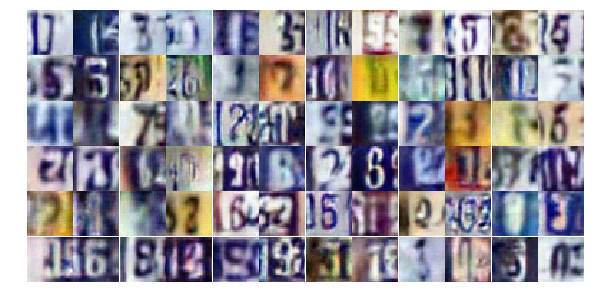

Epoch 18/25... Discriminator Loss: 0.3016... Generator Loss: 1.8923
Epoch 19/25... Discriminator Loss: 0.5351... Generator Loss: 1.2266
Epoch 19/25... Discriminator Loss: 0.4658... Generator Loss: 1.4172
Epoch 19/25... Discriminator Loss: 0.5233... Generator Loss: 1.3422
Epoch 19/25... Discriminator Loss: 0.6254... Generator Loss: 0.9784
Epoch 19/25... Discriminator Loss: 0.4385... Generator Loss: 1.5478
Epoch 19/25... Discriminator Loss: 0.2717... Generator Loss: 2.0858
Epoch 19/25... Discriminator Loss: 0.2455... Generator Loss: 2.1878
Epoch 19/25... Discriminator Loss: 0.1637... Generator Loss: 3.5847
Epoch 19/25... Discriminator Loss: 0.4014... Generator Loss: 1.7709


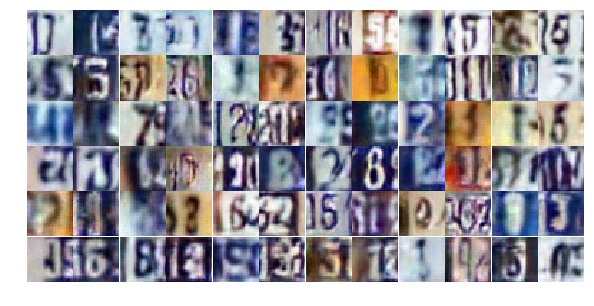

Epoch 19/25... Discriminator Loss: 0.3794... Generator Loss: 1.4646
Epoch 19/25... Discriminator Loss: 0.5215... Generator Loss: 1.2383
Epoch 19/25... Discriminator Loss: 0.8346... Generator Loss: 0.7745
Epoch 19/25... Discriminator Loss: 0.7027... Generator Loss: 0.9670
Epoch 19/25... Discriminator Loss: 0.8823... Generator Loss: 0.7900
Epoch 19/25... Discriminator Loss: 0.4329... Generator Loss: 1.9452
Epoch 19/25... Discriminator Loss: 3.5438... Generator Loss: 2.6583
Epoch 19/25... Discriminator Loss: 0.6237... Generator Loss: 1.1437
Epoch 19/25... Discriminator Loss: 0.5626... Generator Loss: 1.3989
Epoch 19/25... Discriminator Loss: 0.5153... Generator Loss: 1.2550


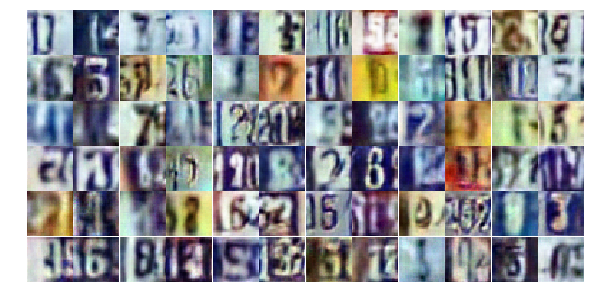

Epoch 19/25... Discriminator Loss: 0.4174... Generator Loss: 1.4778
Epoch 19/25... Discriminator Loss: 0.5311... Generator Loss: 1.2879
Epoch 19/25... Discriminator Loss: 0.3651... Generator Loss: 1.6233
Epoch 19/25... Discriminator Loss: 0.4029... Generator Loss: 1.5948
Epoch 19/25... Discriminator Loss: 0.7068... Generator Loss: 0.9754
Epoch 19/25... Discriminator Loss: 0.4142... Generator Loss: 1.5546
Epoch 19/25... Discriminator Loss: 0.4339... Generator Loss: 1.4043
Epoch 19/25... Discriminator Loss: 0.2454... Generator Loss: 1.8665
Epoch 19/25... Discriminator Loss: 0.2517... Generator Loss: 2.0226
Epoch 19/25... Discriminator Loss: 0.4143... Generator Loss: 1.6137


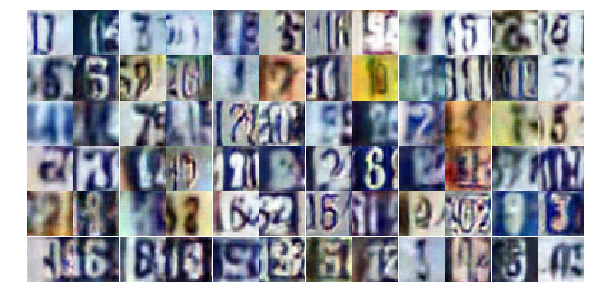

Epoch 19/25... Discriminator Loss: 0.3289... Generator Loss: 1.7729
Epoch 19/25... Discriminator Loss: 0.3140... Generator Loss: 1.6366
Epoch 19/25... Discriminator Loss: 0.2786... Generator Loss: 1.8307
Epoch 19/25... Discriminator Loss: 0.3795... Generator Loss: 1.4864
Epoch 19/25... Discriminator Loss: 0.2374... Generator Loss: 2.4006
Epoch 19/25... Discriminator Loss: 2.1450... Generator Loss: 3.1228
Epoch 19/25... Discriminator Loss: 0.5706... Generator Loss: 1.2793
Epoch 19/25... Discriminator Loss: 0.4183... Generator Loss: 1.9147
Epoch 19/25... Discriminator Loss: 0.6337... Generator Loss: 1.0939
Epoch 19/25... Discriminator Loss: 0.4820... Generator Loss: 1.2140


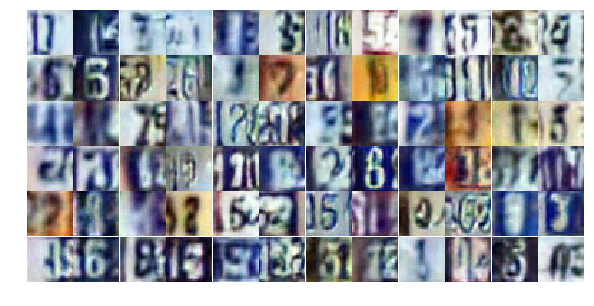

Epoch 19/25... Discriminator Loss: 0.4110... Generator Loss: 1.4291
Epoch 19/25... Discriminator Loss: 0.4648... Generator Loss: 1.4011
Epoch 19/25... Discriminator Loss: 0.2627... Generator Loss: 2.0723
Epoch 19/25... Discriminator Loss: 0.5281... Generator Loss: 1.1878
Epoch 19/25... Discriminator Loss: 0.6086... Generator Loss: 1.0153
Epoch 19/25... Discriminator Loss: 0.5700... Generator Loss: 3.3052
Epoch 19/25... Discriminator Loss: 0.2865... Generator Loss: 2.3657
Epoch 19/25... Discriminator Loss: 0.3064... Generator Loss: 2.3493
Epoch 19/25... Discriminator Loss: 0.3885... Generator Loss: 1.5312
Epoch 19/25... Discriminator Loss: 0.4511... Generator Loss: 1.3727


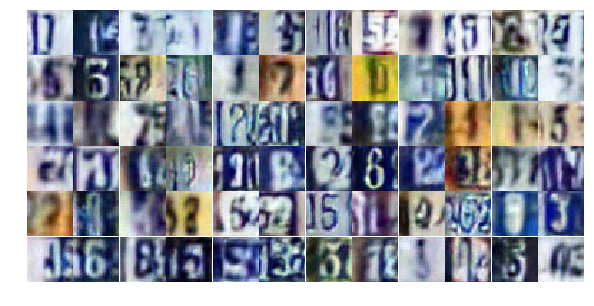

Epoch 19/25... Discriminator Loss: 0.4429... Generator Loss: 1.4064
Epoch 19/25... Discriminator Loss: 0.1708... Generator Loss: 2.6448
Epoch 19/25... Discriminator Loss: 0.2569... Generator Loss: 2.7567
Epoch 19/25... Discriminator Loss: 1.2016... Generator Loss: 7.9927
Epoch 19/25... Discriminator Loss: 0.5279... Generator Loss: 2.8371
Epoch 19/25... Discriminator Loss: 0.3809... Generator Loss: 1.8192
Epoch 19/25... Discriminator Loss: 2.3456... Generator Loss: 0.1714
Epoch 19/25... Discriminator Loss: 0.5373... Generator Loss: 1.2827
Epoch 20/25... Discriminator Loss: 0.2455... Generator Loss: 2.2313
Epoch 20/25... Discriminator Loss: 0.3554... Generator Loss: 2.0849


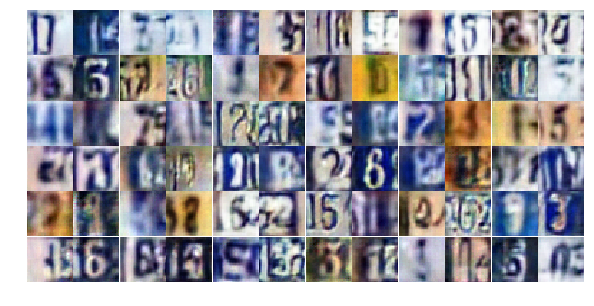

Epoch 20/25... Discriminator Loss: 0.3276... Generator Loss: 1.9603
Epoch 20/25... Discriminator Loss: 0.3806... Generator Loss: 1.6082
Epoch 20/25... Discriminator Loss: 0.9575... Generator Loss: 0.6658
Epoch 20/25... Discriminator Loss: 0.9118... Generator Loss: 0.7252
Epoch 20/25... Discriminator Loss: 0.3027... Generator Loss: 3.2260
Epoch 20/25... Discriminator Loss: 0.6644... Generator Loss: 1.0023
Epoch 20/25... Discriminator Loss: 0.2948... Generator Loss: 1.9714
Epoch 20/25... Discriminator Loss: 0.4862... Generator Loss: 2.9391
Epoch 20/25... Discriminator Loss: 0.5936... Generator Loss: 1.1716
Epoch 20/25... Discriminator Loss: 0.3030... Generator Loss: 1.7348


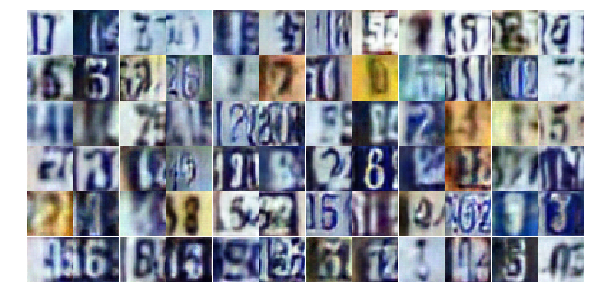

Epoch 20/25... Discriminator Loss: 0.7078... Generator Loss: 0.9792
Epoch 20/25... Discriminator Loss: 0.6248... Generator Loss: 1.0723
Epoch 20/25... Discriminator Loss: 0.1469... Generator Loss: 3.7253
Epoch 20/25... Discriminator Loss: 2.0573... Generator Loss: 2.1231
Epoch 20/25... Discriminator Loss: 0.7070... Generator Loss: 0.9758
Epoch 20/25... Discriminator Loss: 0.7612... Generator Loss: 0.8457
Epoch 20/25... Discriminator Loss: 0.6763... Generator Loss: 0.9945
Epoch 20/25... Discriminator Loss: 0.6591... Generator Loss: 1.0150
Epoch 20/25... Discriminator Loss: 0.3981... Generator Loss: 1.5990
Epoch 20/25... Discriminator Loss: 0.5620... Generator Loss: 1.2934


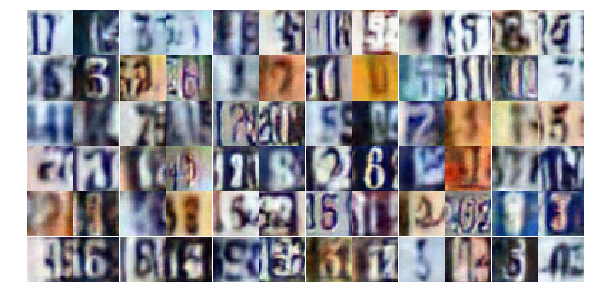

Epoch 20/25... Discriminator Loss: 0.2018... Generator Loss: 2.2177
Epoch 20/25... Discriminator Loss: 0.1889... Generator Loss: 2.7334
Epoch 20/25... Discriminator Loss: 0.1800... Generator Loss: 2.1596
Epoch 20/25... Discriminator Loss: 2.0115... Generator Loss: 0.3214
Epoch 20/25... Discriminator Loss: 2.0304... Generator Loss: 0.2039
Epoch 20/25... Discriminator Loss: 0.5378... Generator Loss: 1.3546
Epoch 20/25... Discriminator Loss: 0.3726... Generator Loss: 4.3928
Epoch 20/25... Discriminator Loss: 0.7023... Generator Loss: 0.9719
Epoch 20/25... Discriminator Loss: 0.5282... Generator Loss: 1.2460
Epoch 20/25... Discriminator Loss: 0.5240... Generator Loss: 1.1528


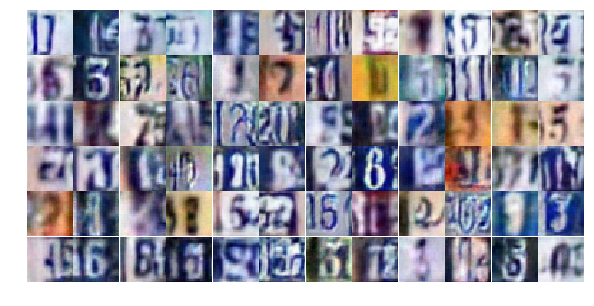

Epoch 20/25... Discriminator Loss: 0.5744... Generator Loss: 1.2030
Epoch 20/25... Discriminator Loss: 0.2812... Generator Loss: 1.7605
Epoch 20/25... Discriminator Loss: 1.3233... Generator Loss: 0.4686
Epoch 20/25... Discriminator Loss: 0.3739... Generator Loss: 1.7247
Epoch 20/25... Discriminator Loss: 0.4800... Generator Loss: 1.6495
Epoch 20/25... Discriminator Loss: 0.1479... Generator Loss: 3.3963
Epoch 20/25... Discriminator Loss: 0.6246... Generator Loss: 1.1260
Epoch 20/25... Discriminator Loss: 0.5802... Generator Loss: 1.1947
Epoch 20/25... Discriminator Loss: 0.3808... Generator Loss: 1.6907
Epoch 20/25... Discriminator Loss: 0.4404... Generator Loss: 1.4343


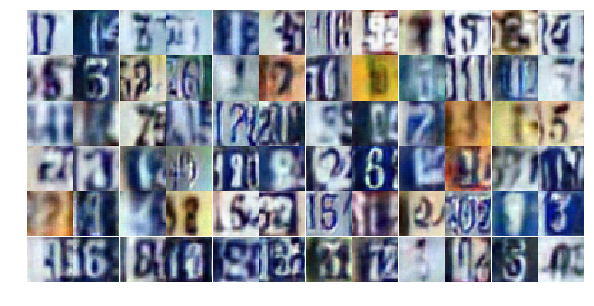

Epoch 20/25... Discriminator Loss: 0.3387... Generator Loss: 1.6365
Epoch 20/25... Discriminator Loss: 0.6477... Generator Loss: 1.0549
Epoch 20/25... Discriminator Loss: 0.7626... Generator Loss: 0.8741
Epoch 20/25... Discriminator Loss: 1.0036... Generator Loss: 0.7070
Epoch 20/25... Discriminator Loss: 1.1230... Generator Loss: 3.7620
Epoch 20/25... Discriminator Loss: 1.3586... Generator Loss: 0.5590
Epoch 20/25... Discriminator Loss: 0.3656... Generator Loss: 1.8194
Epoch 20/25... Discriminator Loss: 0.3460... Generator Loss: 1.6590
Epoch 20/25... Discriminator Loss: 0.2843... Generator Loss: 1.9585
Epoch 20/25... Discriminator Loss: 0.2005... Generator Loss: 2.4278


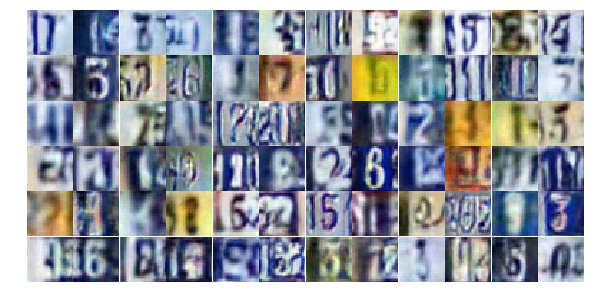

Epoch 20/25... Discriminator Loss: 0.6209... Generator Loss: 1.1090
Epoch 20/25... Discriminator Loss: 0.4534... Generator Loss: 1.4517
Epoch 20/25... Discriminator Loss: 0.2001... Generator Loss: 2.3085
Epoch 20/25... Discriminator Loss: 0.3965... Generator Loss: 1.6241
Epoch 20/25... Discriminator Loss: 0.4866... Generator Loss: 1.3638
Epoch 20/25... Discriminator Loss: 0.2890... Generator Loss: 2.4640
Epoch 21/25... Discriminator Loss: 0.5133... Generator Loss: 1.2356
Epoch 21/25... Discriminator Loss: 0.6391... Generator Loss: 1.0685
Epoch 21/25... Discriminator Loss: 1.3887... Generator Loss: 0.4736
Epoch 21/25... Discriminator Loss: 0.2851... Generator Loss: 2.1310


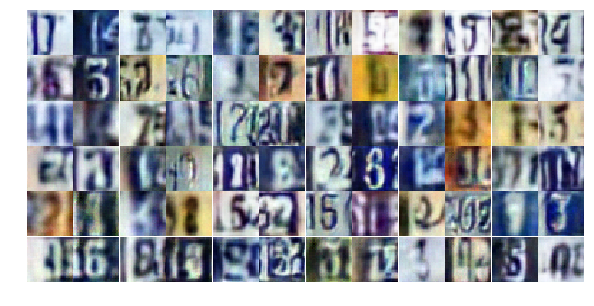

Epoch 21/25... Discriminator Loss: 0.3118... Generator Loss: 1.8523
Epoch 21/25... Discriminator Loss: 1.1635... Generator Loss: 0.5301
Epoch 21/25... Discriminator Loss: 0.1569... Generator Loss: 2.8647
Epoch 21/25... Discriminator Loss: 0.0835... Generator Loss: 3.7780
Epoch 21/25... Discriminator Loss: 0.2369... Generator Loss: 2.2921
Epoch 21/25... Discriminator Loss: 0.2365... Generator Loss: 2.0985
Epoch 21/25... Discriminator Loss: 0.8177... Generator Loss: 0.8722
Epoch 21/25... Discriminator Loss: 1.1315... Generator Loss: 0.5685
Epoch 21/25... Discriminator Loss: 0.3766... Generator Loss: 1.4637
Epoch 21/25... Discriminator Loss: 0.5706... Generator Loss: 1.2004


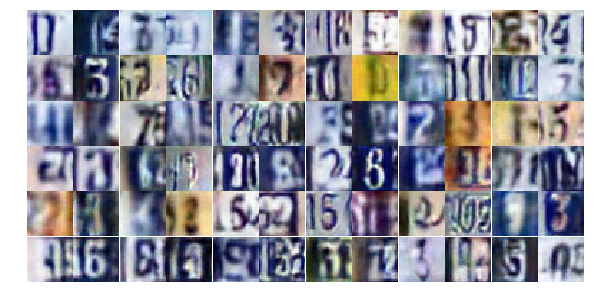

Epoch 21/25... Discriminator Loss: 0.1427... Generator Loss: 2.7183
Epoch 21/25... Discriminator Loss: 0.5578... Generator Loss: 1.1696
Epoch 21/25... Discriminator Loss: 1.6900... Generator Loss: 0.6806
Epoch 21/25... Discriminator Loss: 0.9990... Generator Loss: 0.7271
Epoch 21/25... Discriminator Loss: 0.3702... Generator Loss: 1.5652
Epoch 21/25... Discriminator Loss: 0.1585... Generator Loss: 2.8105
Epoch 21/25... Discriminator Loss: 0.5676... Generator Loss: 1.0487
Epoch 21/25... Discriminator Loss: 0.1901... Generator Loss: 2.5123
Epoch 21/25... Discriminator Loss: 0.2784... Generator Loss: 1.6942
Epoch 21/25... Discriminator Loss: 0.2490... Generator Loss: 2.0348


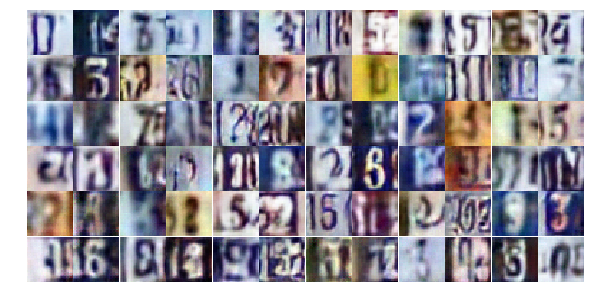

Epoch 21/25... Discriminator Loss: 0.7023... Generator Loss: 0.9895
Epoch 21/25... Discriminator Loss: 0.2040... Generator Loss: 2.0162
Epoch 21/25... Discriminator Loss: 0.5156... Generator Loss: 1.2448
Epoch 21/25... Discriminator Loss: 0.3255... Generator Loss: 1.8223
Epoch 21/25... Discriminator Loss: 3.1172... Generator Loss: 0.2020
Epoch 21/25... Discriminator Loss: 2.0756... Generator Loss: 0.3031
Epoch 21/25... Discriminator Loss: 0.2297... Generator Loss: 2.3003
Epoch 21/25... Discriminator Loss: 1.1484... Generator Loss: 0.5263
Epoch 21/25... Discriminator Loss: 0.9989... Generator Loss: 0.6329
Epoch 21/25... Discriminator Loss: 1.2152... Generator Loss: 0.6271


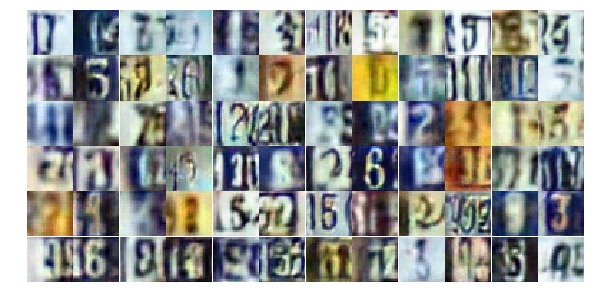

Epoch 21/25... Discriminator Loss: 0.7386... Generator Loss: 1.4554
Epoch 21/25... Discriminator Loss: 0.3457... Generator Loss: 1.8084
Epoch 21/25... Discriminator Loss: 0.7404... Generator Loss: 0.9157
Epoch 21/25... Discriminator Loss: 0.2365... Generator Loss: 2.5537
Epoch 21/25... Discriminator Loss: 0.3392... Generator Loss: 1.6338
Epoch 21/25... Discriminator Loss: 0.4338... Generator Loss: 1.7487
Epoch 21/25... Discriminator Loss: 0.3435... Generator Loss: 1.8485
Epoch 21/25... Discriminator Loss: 0.3385... Generator Loss: 1.7144
Epoch 21/25... Discriminator Loss: 0.5079... Generator Loss: 1.2608
Epoch 21/25... Discriminator Loss: 1.5143... Generator Loss: 0.4162


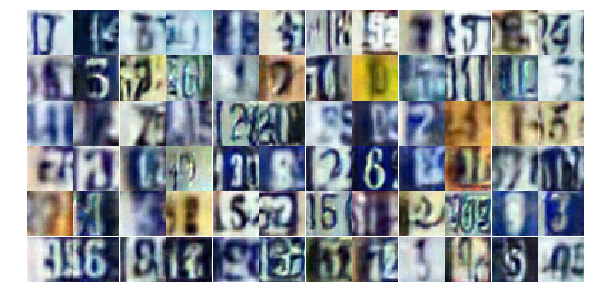

Epoch 21/25... Discriminator Loss: 0.6538... Generator Loss: 1.7471
Epoch 21/25... Discriminator Loss: 2.9930... Generator Loss: 0.1109
Epoch 21/25... Discriminator Loss: 0.4710... Generator Loss: 2.4447
Epoch 21/25... Discriminator Loss: 0.5951... Generator Loss: 1.2574
Epoch 21/25... Discriminator Loss: 0.3630... Generator Loss: 1.6394
Epoch 21/25... Discriminator Loss: 0.4607... Generator Loss: 1.4097
Epoch 21/25... Discriminator Loss: 0.4322... Generator Loss: 1.4247
Epoch 21/25... Discriminator Loss: 1.4753... Generator Loss: 0.3734
Epoch 21/25... Discriminator Loss: 0.5777... Generator Loss: 1.1148
Epoch 21/25... Discriminator Loss: 0.4760... Generator Loss: 1.3960


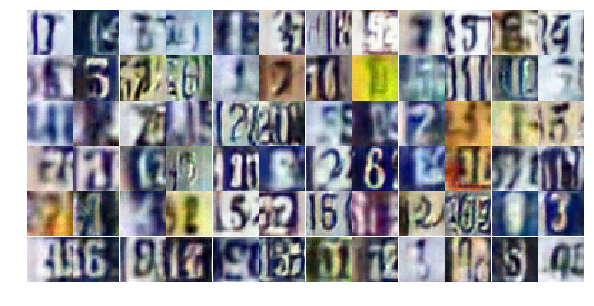

Epoch 21/25... Discriminator Loss: 0.5716... Generator Loss: 1.1234
Epoch 21/25... Discriminator Loss: 0.7755... Generator Loss: 0.8965
Epoch 21/25... Discriminator Loss: 0.6561... Generator Loss: 1.1482
Epoch 22/25... Discriminator Loss: 0.5035... Generator Loss: 1.3527
Epoch 22/25... Discriminator Loss: 0.9622... Generator Loss: 0.6270
Epoch 22/25... Discriminator Loss: 0.6257... Generator Loss: 1.0715
Epoch 22/25... Discriminator Loss: 0.3380... Generator Loss: 1.6065
Epoch 22/25... Discriminator Loss: 0.2928... Generator Loss: 1.7885
Epoch 22/25... Discriminator Loss: 0.2628... Generator Loss: 2.0212
Epoch 22/25... Discriminator Loss: 0.4542... Generator Loss: 1.4382


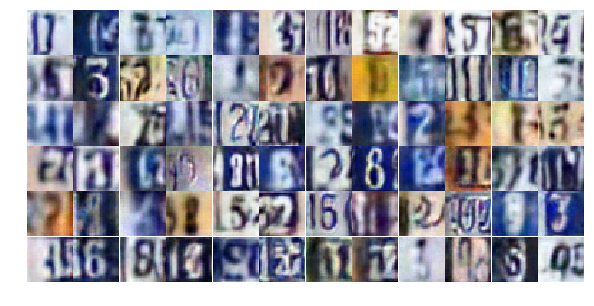

Epoch 22/25... Discriminator Loss: 0.1723... Generator Loss: 4.1500
Epoch 22/25... Discriminator Loss: 0.9285... Generator Loss: 0.6620
Epoch 22/25... Discriminator Loss: 1.1275... Generator Loss: 0.6120
Epoch 22/25... Discriminator Loss: 0.3490... Generator Loss: 1.8874
Epoch 22/25... Discriminator Loss: 0.5036... Generator Loss: 1.5043
Epoch 22/25... Discriminator Loss: 0.3283... Generator Loss: 1.6499
Epoch 22/25... Discriminator Loss: 0.3456... Generator Loss: 1.6737
Epoch 22/25... Discriminator Loss: 0.3608... Generator Loss: 1.7820
Epoch 22/25... Discriminator Loss: 1.7561... Generator Loss: 0.3628
Epoch 22/25... Discriminator Loss: 2.2727... Generator Loss: 0.1899


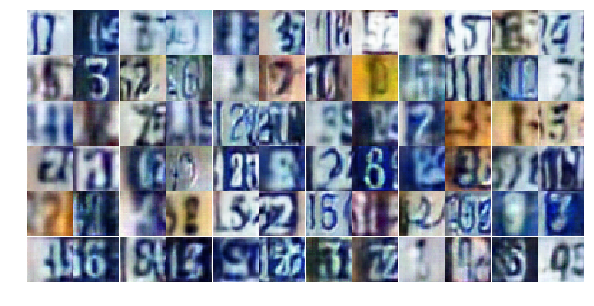

Epoch 22/25... Discriminator Loss: 0.3864... Generator Loss: 1.6849
Epoch 22/25... Discriminator Loss: 0.2465... Generator Loss: 2.2166
Epoch 22/25... Discriminator Loss: 0.2671... Generator Loss: 2.0568
Epoch 22/25... Discriminator Loss: 0.3539... Generator Loss: 1.5242
Epoch 22/25... Discriminator Loss: 0.3407... Generator Loss: 1.6354
Epoch 22/25... Discriminator Loss: 0.5515... Generator Loss: 1.1384
Epoch 22/25... Discriminator Loss: 0.1872... Generator Loss: 2.9896
Epoch 22/25... Discriminator Loss: 0.1679... Generator Loss: 2.4006
Epoch 22/25... Discriminator Loss: 0.1608... Generator Loss: 2.5368
Epoch 22/25... Discriminator Loss: 0.3735... Generator Loss: 1.6806


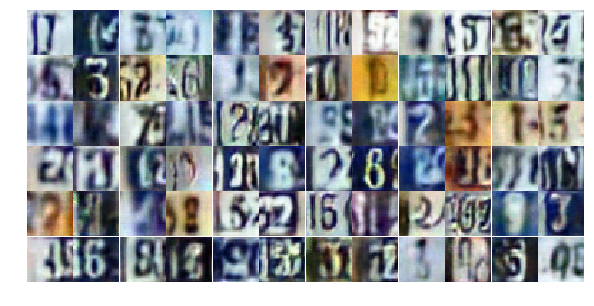

Epoch 22/25... Discriminator Loss: 0.3577... Generator Loss: 1.5606
Epoch 22/25... Discriminator Loss: 0.2418... Generator Loss: 2.4626
Epoch 22/25... Discriminator Loss: 0.6321... Generator Loss: 1.1212
Epoch 22/25... Discriminator Loss: 0.4609... Generator Loss: 1.3299
Epoch 22/25... Discriminator Loss: 1.0798... Generator Loss: 0.6462
Epoch 22/25... Discriminator Loss: 0.8988... Generator Loss: 0.7624
Epoch 22/25... Discriminator Loss: 1.7409... Generator Loss: 0.3254
Epoch 22/25... Discriminator Loss: 0.2601... Generator Loss: 3.4566
Epoch 22/25... Discriminator Loss: 0.3520... Generator Loss: 1.9300
Epoch 22/25... Discriminator Loss: 0.6158... Generator Loss: 1.0386


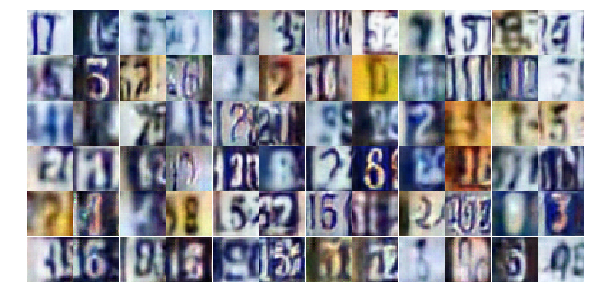

Epoch 22/25... Discriminator Loss: 0.6607... Generator Loss: 1.0933
Epoch 22/25... Discriminator Loss: 0.2548... Generator Loss: 1.9027
Epoch 22/25... Discriminator Loss: 0.2263... Generator Loss: 1.8775
Epoch 22/25... Discriminator Loss: 0.2952... Generator Loss: 1.8243
Epoch 22/25... Discriminator Loss: 0.2045... Generator Loss: 2.0557
Epoch 22/25... Discriminator Loss: 0.3278... Generator Loss: 1.6263
Epoch 22/25... Discriminator Loss: 0.3683... Generator Loss: 1.5514
Epoch 22/25... Discriminator Loss: 0.2075... Generator Loss: 2.4331
Epoch 22/25... Discriminator Loss: 1.0047... Generator Loss: 0.9634
Epoch 22/25... Discriminator Loss: 0.4796... Generator Loss: 1.2824


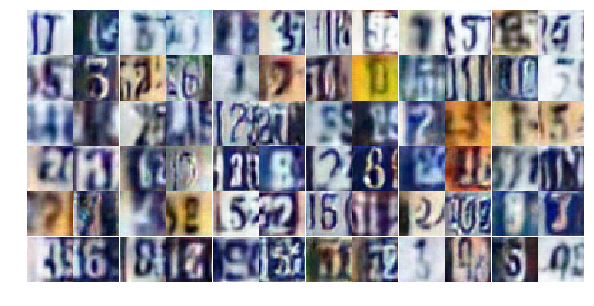

Epoch 22/25... Discriminator Loss: 0.7931... Generator Loss: 0.9288
Epoch 22/25... Discriminator Loss: 0.2112... Generator Loss: 2.2068
Epoch 22/25... Discriminator Loss: 0.2338... Generator Loss: 2.1771
Epoch 22/25... Discriminator Loss: 0.5632... Generator Loss: 1.1436
Epoch 22/25... Discriminator Loss: 0.3980... Generator Loss: 1.4574
Epoch 22/25... Discriminator Loss: 0.2284... Generator Loss: 2.2457
Epoch 22/25... Discriminator Loss: 4.1549... Generator Loss: 0.0365
Epoch 22/25... Discriminator Loss: 0.5148... Generator Loss: 1.6750
Epoch 22/25... Discriminator Loss: 1.5588... Generator Loss: 4.3808
Epoch 22/25... Discriminator Loss: 0.6652... Generator Loss: 1.2950


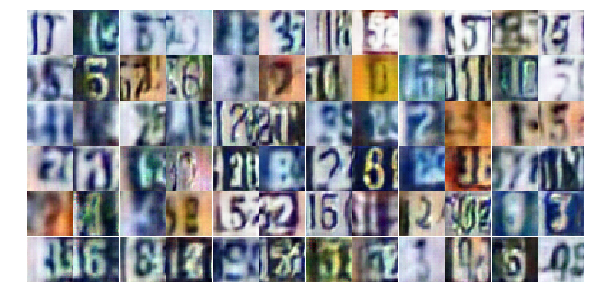

Epoch 23/25... Discriminator Loss: 0.8790... Generator Loss: 0.8055
Epoch 23/25... Discriminator Loss: 0.1377... Generator Loss: 3.3868
Epoch 23/25... Discriminator Loss: 0.3142... Generator Loss: 1.7794
Epoch 23/25... Discriminator Loss: 0.5424... Generator Loss: 1.3098
Epoch 23/25... Discriminator Loss: 0.5062... Generator Loss: 1.2121
Epoch 23/25... Discriminator Loss: 0.8529... Generator Loss: 0.7834
Epoch 23/25... Discriminator Loss: 0.9495... Generator Loss: 0.7506
Epoch 23/25... Discriminator Loss: 0.2735... Generator Loss: 1.9243
Epoch 23/25... Discriminator Loss: 0.3012... Generator Loss: 1.8713
Epoch 23/25... Discriminator Loss: 0.2379... Generator Loss: 2.0239


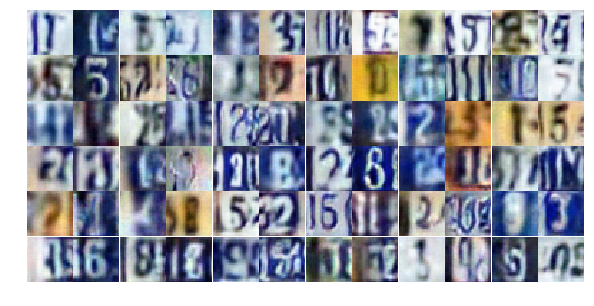

Epoch 23/25... Discriminator Loss: 0.2145... Generator Loss: 2.0755
Epoch 23/25... Discriminator Loss: 0.1010... Generator Loss: 3.4663
Epoch 23/25... Discriminator Loss: 0.3297... Generator Loss: 1.9473
Epoch 23/25... Discriminator Loss: 0.2547... Generator Loss: 1.9330
Epoch 23/25... Discriminator Loss: 0.2908... Generator Loss: 1.9854
Epoch 23/25... Discriminator Loss: 0.8783... Generator Loss: 0.8408
Epoch 23/25... Discriminator Loss: 0.6315... Generator Loss: 1.0465
Epoch 23/25... Discriminator Loss: 0.8794... Generator Loss: 3.1599
Epoch 23/25... Discriminator Loss: 1.2059... Generator Loss: 1.1639
Epoch 23/25... Discriminator Loss: 0.6333... Generator Loss: 1.1377


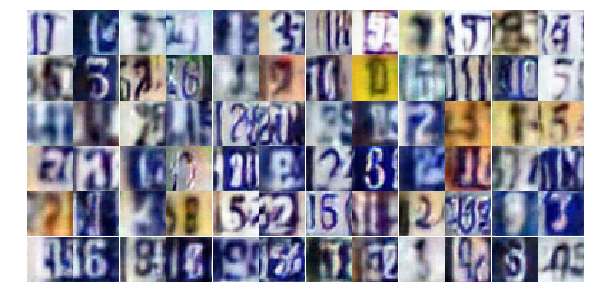

Epoch 23/25... Discriminator Loss: 0.5748... Generator Loss: 1.1274
Epoch 23/25... Discriminator Loss: 0.5443... Generator Loss: 1.2175
Epoch 23/25... Discriminator Loss: 0.7720... Generator Loss: 0.9123
Epoch 23/25... Discriminator Loss: 0.6781... Generator Loss: 0.9666
Epoch 23/25... Discriminator Loss: 0.3987... Generator Loss: 1.6204
Epoch 23/25... Discriminator Loss: 0.4940... Generator Loss: 1.2890
Epoch 23/25... Discriminator Loss: 0.2843... Generator Loss: 2.0302
Epoch 23/25... Discriminator Loss: 0.4688... Generator Loss: 1.3828
Epoch 23/25... Discriminator Loss: 0.4234... Generator Loss: 1.5203
Epoch 23/25... Discriminator Loss: 0.5554... Generator Loss: 2.1023


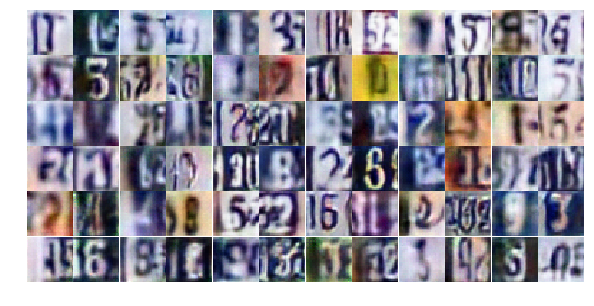

Epoch 23/25... Discriminator Loss: 0.3977... Generator Loss: 1.5132
Epoch 23/25... Discriminator Loss: 0.3744... Generator Loss: 1.6386
Epoch 23/25... Discriminator Loss: 0.2046... Generator Loss: 2.6190
Epoch 23/25... Discriminator Loss: 0.3688... Generator Loss: 1.6586
Epoch 23/25... Discriminator Loss: 0.6701... Generator Loss: 0.9502
Epoch 23/25... Discriminator Loss: 0.4737... Generator Loss: 1.3668
Epoch 23/25... Discriminator Loss: 0.7305... Generator Loss: 0.9405
Epoch 23/25... Discriminator Loss: 0.2849... Generator Loss: 2.2324
Epoch 23/25... Discriminator Loss: 0.3205... Generator Loss: 1.6345
Epoch 23/25... Discriminator Loss: 0.7046... Generator Loss: 0.8884


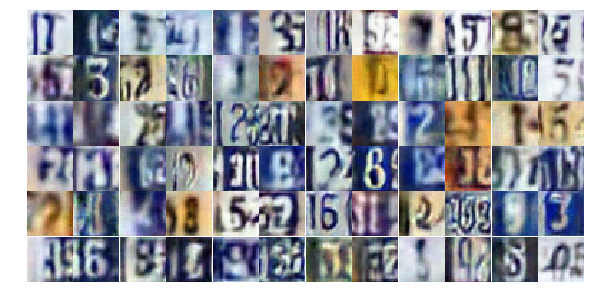

Epoch 23/25... Discriminator Loss: 0.5068... Generator Loss: 1.3714
Epoch 23/25... Discriminator Loss: 0.4352... Generator Loss: 1.4176
Epoch 23/25... Discriminator Loss: 0.9369... Generator Loss: 0.7139
Epoch 23/25... Discriminator Loss: 0.3537... Generator Loss: 1.5786
Epoch 23/25... Discriminator Loss: 2.7318... Generator Loss: 6.1096
Epoch 23/25... Discriminator Loss: 0.6787... Generator Loss: 1.5340
Epoch 23/25... Discriminator Loss: 0.5339... Generator Loss: 1.6146
Epoch 23/25... Discriminator Loss: 0.8754... Generator Loss: 0.8537
Epoch 23/25... Discriminator Loss: 0.3957... Generator Loss: 1.8727
Epoch 23/25... Discriminator Loss: 0.5653... Generator Loss: 1.2102


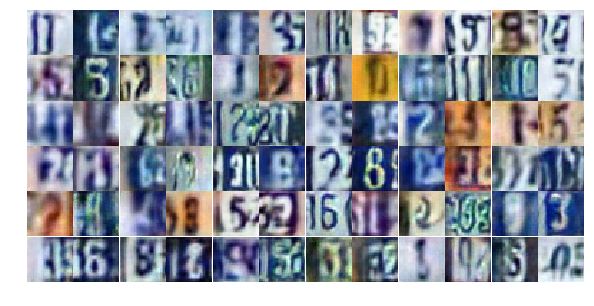

Epoch 23/25... Discriminator Loss: 1.2161... Generator Loss: 0.5028
Epoch 23/25... Discriminator Loss: 0.5373... Generator Loss: 1.2041
Epoch 23/25... Discriminator Loss: 1.3320... Generator Loss: 0.5317
Epoch 23/25... Discriminator Loss: 0.4075... Generator Loss: 1.3840
Epoch 23/25... Discriminator Loss: 0.6919... Generator Loss: 0.9947
Epoch 23/25... Discriminator Loss: 0.7686... Generator Loss: 0.9408
Epoch 23/25... Discriminator Loss: 0.4511... Generator Loss: 1.4130
Epoch 24/25... Discriminator Loss: 0.4924... Generator Loss: 1.3182
Epoch 24/25... Discriminator Loss: 0.4685... Generator Loss: 1.4784
Epoch 24/25... Discriminator Loss: 0.8705... Generator Loss: 0.7440


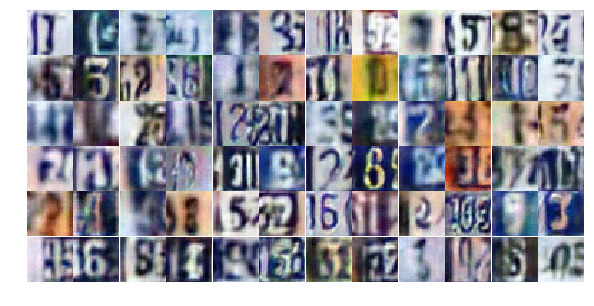

Epoch 24/25... Discriminator Loss: 0.2992... Generator Loss: 2.3001
Epoch 24/25... Discriminator Loss: 0.1088... Generator Loss: 3.2484
Epoch 24/25... Discriminator Loss: 0.6214... Generator Loss: 1.0431
Epoch 24/25... Discriminator Loss: 2.2307... Generator Loss: 6.3022
Epoch 24/25... Discriminator Loss: 1.5414... Generator Loss: 3.5281
Epoch 24/25... Discriminator Loss: 1.0943... Generator Loss: 0.6659
Epoch 24/25... Discriminator Loss: 0.8026... Generator Loss: 2.4177
Epoch 24/25... Discriminator Loss: 1.0777... Generator Loss: 0.6584
Epoch 24/25... Discriminator Loss: 0.3321... Generator Loss: 1.6810
Epoch 24/25... Discriminator Loss: 0.3473... Generator Loss: 1.8229


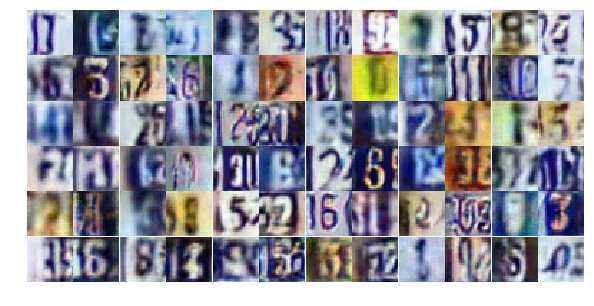

Epoch 24/25... Discriminator Loss: 1.6444... Generator Loss: 0.3395
Epoch 24/25... Discriminator Loss: 0.8090... Generator Loss: 1.7927
Epoch 24/25... Discriminator Loss: 1.9524... Generator Loss: 0.2301
Epoch 24/25... Discriminator Loss: 0.3872... Generator Loss: 1.5840
Epoch 24/25... Discriminator Loss: 0.4445... Generator Loss: 1.5563
Epoch 24/25... Discriminator Loss: 0.9748... Generator Loss: 0.7026
Epoch 24/25... Discriminator Loss: 0.5240... Generator Loss: 1.2814
Epoch 24/25... Discriminator Loss: 0.3283... Generator Loss: 1.9467
Epoch 24/25... Discriminator Loss: 0.5037... Generator Loss: 1.2839
Epoch 24/25... Discriminator Loss: 0.3695... Generator Loss: 1.8061


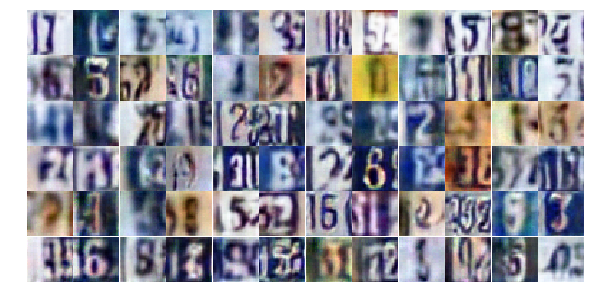

Epoch 24/25... Discriminator Loss: 0.3928... Generator Loss: 1.6755
Epoch 24/25... Discriminator Loss: 0.2965... Generator Loss: 1.8429
Epoch 24/25... Discriminator Loss: 0.2427... Generator Loss: 1.9155
Epoch 24/25... Discriminator Loss: 1.0547... Generator Loss: 0.6493
Epoch 24/25... Discriminator Loss: 0.3209... Generator Loss: 1.7007
Epoch 24/25... Discriminator Loss: 0.3580... Generator Loss: 1.6254
Epoch 24/25... Discriminator Loss: 0.3498... Generator Loss: 1.6603
Epoch 24/25... Discriminator Loss: 0.5349... Generator Loss: 1.2906
Epoch 24/25... Discriminator Loss: 0.5781... Generator Loss: 1.0929
Epoch 24/25... Discriminator Loss: 0.6316... Generator Loss: 1.0561


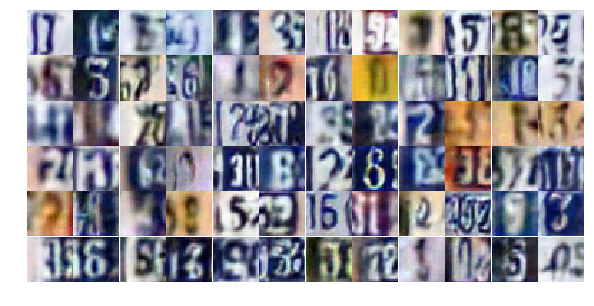

Epoch 24/25... Discriminator Loss: 0.8223... Generator Loss: 0.8625
Epoch 24/25... Discriminator Loss: 0.2794... Generator Loss: 2.1958
Epoch 24/25... Discriminator Loss: 0.6903... Generator Loss: 1.0985
Epoch 24/25... Discriminator Loss: 0.9847... Generator Loss: 0.6640
Epoch 24/25... Discriminator Loss: 0.7432... Generator Loss: 0.8756
Epoch 24/25... Discriminator Loss: 0.6350... Generator Loss: 1.0541
Epoch 24/25... Discriminator Loss: 0.1955... Generator Loss: 2.4993
Epoch 24/25... Discriminator Loss: 0.3866... Generator Loss: 1.4884
Epoch 24/25... Discriminator Loss: 0.4130... Generator Loss: 1.4973
Epoch 24/25... Discriminator Loss: 0.1749... Generator Loss: 2.5491


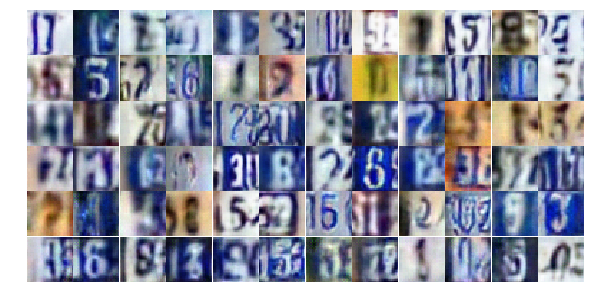

Epoch 24/25... Discriminator Loss: 0.3053... Generator Loss: 1.7687
Epoch 24/25... Discriminator Loss: 0.6650... Generator Loss: 1.0481
Epoch 24/25... Discriminator Loss: 1.1928... Generator Loss: 0.5295
Epoch 24/25... Discriminator Loss: 1.6966... Generator Loss: 0.3104
Epoch 24/25... Discriminator Loss: 1.6860... Generator Loss: 0.3816
Epoch 24/25... Discriminator Loss: 0.6216... Generator Loss: 1.2449
Epoch 24/25... Discriminator Loss: 0.5685... Generator Loss: 1.2237
Epoch 24/25... Discriminator Loss: 0.2171... Generator Loss: 2.2265
Epoch 24/25... Discriminator Loss: 0.6855... Generator Loss: 0.9921
Epoch 24/25... Discriminator Loss: 0.4122... Generator Loss: 1.4766


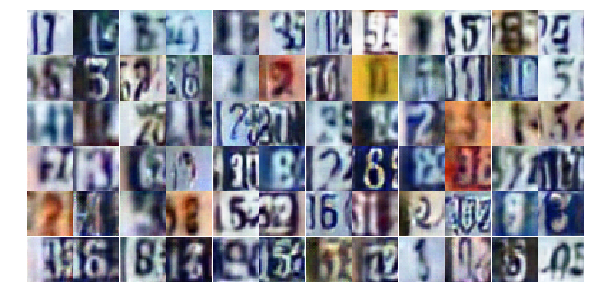

Epoch 24/25... Discriminator Loss: 0.6202... Generator Loss: 1.1178
Epoch 24/25... Discriminator Loss: 0.8969... Generator Loss: 0.8236
Epoch 24/25... Discriminator Loss: 0.3970... Generator Loss: 1.6249
Epoch 24/25... Discriminator Loss: 0.3686... Generator Loss: 2.2247
Epoch 24/25... Discriminator Loss: 0.4843... Generator Loss: 1.4466
Epoch 25/25... Discriminator Loss: 0.4430... Generator Loss: 1.5055
Epoch 25/25... Discriminator Loss: 0.6326... Generator Loss: 1.0400
Epoch 25/25... Discriminator Loss: 0.2628... Generator Loss: 1.9044
Epoch 25/25... Discriminator Loss: 0.2844... Generator Loss: 2.1359
Epoch 25/25... Discriminator Loss: 0.6833... Generator Loss: 1.0580


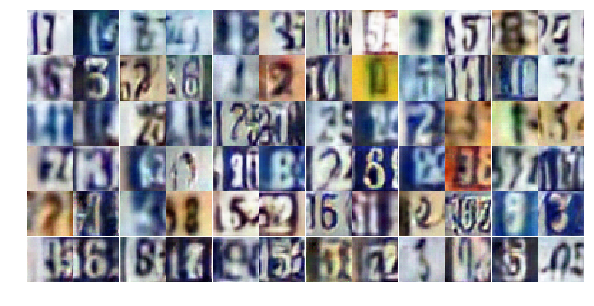

Epoch 25/25... Discriminator Loss: 0.6172... Generator Loss: 1.0752
Epoch 25/25... Discriminator Loss: 0.8381... Generator Loss: 0.8136
Epoch 25/25... Discriminator Loss: 0.4428... Generator Loss: 1.5608
Epoch 25/25... Discriminator Loss: 0.2671... Generator Loss: 2.2038
Epoch 25/25... Discriminator Loss: 0.8292... Generator Loss: 3.7896
Epoch 25/25... Discriminator Loss: 0.2788... Generator Loss: 2.0507
Epoch 25/25... Discriminator Loss: 0.2980... Generator Loss: 1.9984
Epoch 25/25... Discriminator Loss: 0.3745... Generator Loss: 1.6243
Epoch 25/25... Discriminator Loss: 0.3131... Generator Loss: 1.7051
Epoch 25/25... Discriminator Loss: 0.4608... Generator Loss: 1.4504


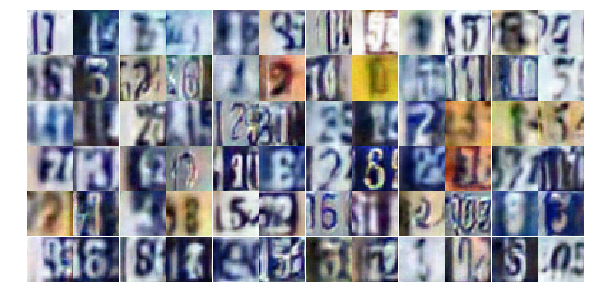

Epoch 25/25... Discriminator Loss: 0.4447... Generator Loss: 1.3522
Epoch 25/25... Discriminator Loss: 1.7880... Generator Loss: 5.0176
Epoch 25/25... Discriminator Loss: 1.9176... Generator Loss: 0.2395
Epoch 25/25... Discriminator Loss: 1.2632... Generator Loss: 0.5440
Epoch 25/25... Discriminator Loss: 0.3328... Generator Loss: 1.7630
Epoch 25/25... Discriminator Loss: 0.4036... Generator Loss: 1.5083
Epoch 25/25... Discriminator Loss: 0.3821... Generator Loss: 1.7037
Epoch 25/25... Discriminator Loss: 2.5866... Generator Loss: 0.2846
Epoch 25/25... Discriminator Loss: 1.2390... Generator Loss: 0.9857
Epoch 25/25... Discriminator Loss: 1.1830... Generator Loss: 0.7665


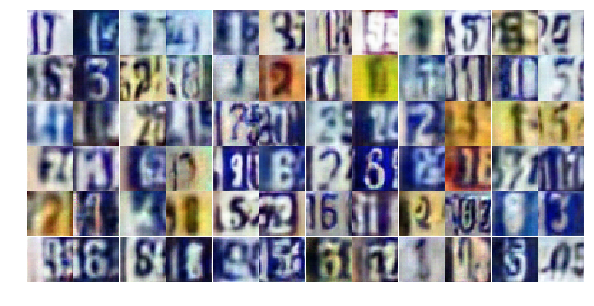

Epoch 25/25... Discriminator Loss: 0.6926... Generator Loss: 1.0842
Epoch 25/25... Discriminator Loss: 0.5097... Generator Loss: 1.3966
Epoch 25/25... Discriminator Loss: 1.2535... Generator Loss: 0.6206
Epoch 25/25... Discriminator Loss: 0.3864... Generator Loss: 2.0891
Epoch 25/25... Discriminator Loss: 0.4189... Generator Loss: 1.5650
Epoch 25/25... Discriminator Loss: 0.3658... Generator Loss: 1.5872
Epoch 25/25... Discriminator Loss: 0.8660... Generator Loss: 0.8124
Epoch 25/25... Discriminator Loss: 0.4306... Generator Loss: 1.4786
Epoch 25/25... Discriminator Loss: 0.9950... Generator Loss: 2.7391
Epoch 25/25... Discriminator Loss: 2.1639... Generator Loss: 0.2104


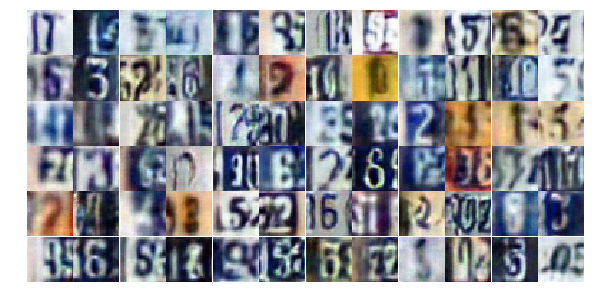

Epoch 25/25... Discriminator Loss: 0.6531... Generator Loss: 1.0256
Epoch 25/25... Discriminator Loss: 0.6957... Generator Loss: 0.9298
Epoch 25/25... Discriminator Loss: 0.5208... Generator Loss: 1.3053
Epoch 25/25... Discriminator Loss: 0.2709... Generator Loss: 1.9027
Epoch 25/25... Discriminator Loss: 0.7747... Generator Loss: 0.8547
Epoch 25/25... Discriminator Loss: 0.7580... Generator Loss: 0.9061
Epoch 25/25... Discriminator Loss: 0.4795... Generator Loss: 1.3156
Epoch 25/25... Discriminator Loss: 0.0958... Generator Loss: 3.6151
Epoch 25/25... Discriminator Loss: 1.2644... Generator Loss: 0.5670
Epoch 25/25... Discriminator Loss: 0.2225... Generator Loss: 2.1763


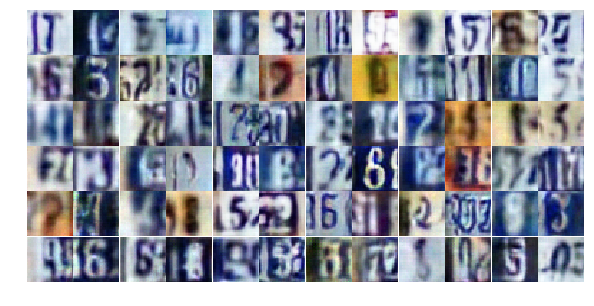

Epoch 25/25... Discriminator Loss: 0.6078... Generator Loss: 1.1397
Epoch 25/25... Discriminator Loss: 0.5325... Generator Loss: 1.2643
Epoch 25/25... Discriminator Loss: 1.0018... Generator Loss: 0.6646
Epoch 25/25... Discriminator Loss: 0.6069... Generator Loss: 1.0679
Epoch 25/25... Discriminator Loss: 0.8754... Generator Loss: 0.7652
Epoch 25/25... Discriminator Loss: 0.2021... Generator Loss: 2.0997
Epoch 25/25... Discriminator Loss: 1.8190... Generator Loss: 0.2901
Epoch 25/25... Discriminator Loss: 1.7908... Generator Loss: 0.3958
Epoch 25/25... Discriminator Loss: 1.0570... Generator Loss: 3.4412
Epoch 25/25... Discriminator Loss: 1.2241... Generator Loss: 0.5192


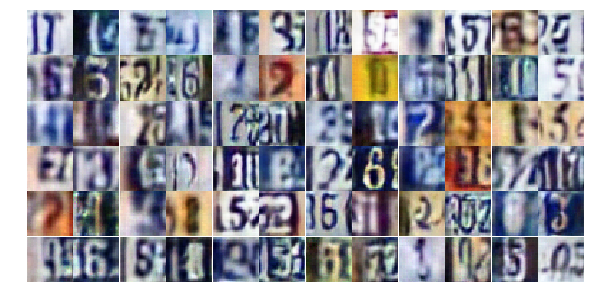

Epoch 25/25... Discriminator Loss: 0.4758... Generator Loss: 1.6134
Epoch 25/25... Discriminator Loss: 1.6613... Generator Loss: 0.3060


In [20]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

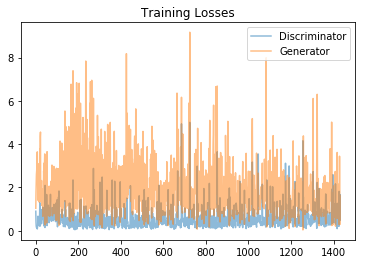

In [21]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

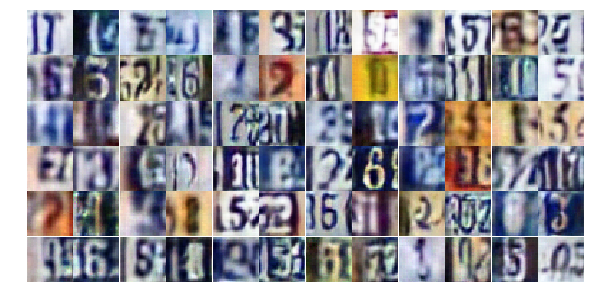

In [22]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))